In [1]:
import sys
import matplotlib.pyplot as plt
import numpy as np    
import ROOT
import root_numpy as rtnp

import cygnus_lib as cy
import mylib as my
%matplotlib inline
import pandas as pd
from scipy.optimize import curve_fit
from scipy.stats import chisquare
import scipy.stats as stats
from itertools import combinations
import math
import os
import time


from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
myhost = os.uname()[1]
if myhost == 'macmazzitelli.lnf.infn.it':
    mybasepath = '/Users/mazzitel/Dropbox/GR2/soft/data/'
    posix=False
else:
    mybasepath = '/workarea/cloud-storage/mazzitel/'
    posix=True
print("Host:", myhost)
print (sys.version, get_ipython())
if 'google.colab' in str(get_ipython()) and sys.version[0:1] in '2':
    mybasepath = './'
    posix=False
    print('Running on CoLab')

Welcome to JupyROOT 6.22/06
Host: f07f81f67a26
3.6.8 (default, Nov 16 2020, 16:55:22) 
[GCC 4.8.5 20150623 (Red Hat 4.8.5-44)] <ipykernel.zmqshell.ZMQInteractiveShell object at 0x7f117a47a6d8>


In [2]:
def Gauss3(x, a0, x0, s0):
    import numpy as np
    return a0 * np.exp(-(x - x0)**2 / (2 * s0**2))
    
def histGaus(var, bins, ax, color='b', xrange=False, alpha=1, label=''):
    from sklearn.metrics import r2_score
    from scipy.stats import chisquare
    import scipy.stats as stats
    if xrange:
        ax.hist(var, bins=bins, label=label, color=color, range=(xrange[0], xrange[1]), alpha=alpha)
        y, bins_edge = np.histogram(var, bins=bins, range=(xrange[0], xrange[1]))
    else:
        ax.hist(var, bins=bins, label=label, color=color)
        y, bins_edge = np.histogram(var, bins=bins)
    p0=[y.max(),bins_edge[y.argmax()], var.std()]
    x = np.linspace(bins_edge[0], bins_edge[-1], bins)
    popt, pcov = curve_fit(Gauss3, x, y, p0=p0)
    perr = np.sqrt(np.diag(pcov))
    r2=r2_score(y, Gauss3(x, *popt))
    x = np.linspace(bins_edge[0], bins_edge[-1], 100)
    sstat='a = {0:.2f} +/- {1:.2f}\nb = {2:.2f} +/- {3:.2f} \
    \nc = {4:.2f} +/- {5:.2f}\n$R^2$ = {6:.4f}'.format(popt[0], perr[0], popt[1], perr[1], 
                                                popt[2], perr[2], r2)
    ax.plot(x,Gauss3(x, *popt), color+'--', label=sstat)
    return ax
def ExpG(x, p0, p1, a0, x0, s0): # power of ten
    import numpy as np
    return p0*np.exp(p1*x) + a0 * np.exp(-(x - x0)**2 / (2 * s0**2))

def Exp(x, p0, p1): # power of ten
    import numpy as np
    return p0*np.exp(p1*x)

def G3(x, a0, x0, s0): # power of ten
    import numpy as np
    return a0 * np.exp(-(x - x0)**2 / (2 * s0**2))

def myExpG(data,ax, xmin, xmax, bins, E0, E1, a0, x0, s0):
    y = data[(data > xmin) & (data < xmax)]
    binsf = int(bins*((xmax-xmin)/(y.max()-y.min())))
    x=np.linspace(xmin , xmax, binsf)
    yh, _ = np.histogram(y, bins=binsf, range=(xmin,xmax))
    popt, pcov = curve_fit(ExpG, x, yh, 
                            p0=(E0, E1, a0, x0, s0))    
    #print ("Params: ", popt) 
    perr = np.sqrt(np.diag(pcov))
    #print ("err: ", perr)
    # plt.title(r'E0*$e^{(E1*x)}$ + a0*$e^{-\frac{(x - x0)^2}{2*s0^2}}$', fontsize=30)
    ax.plot(x, ExpG(x, *popt), 'r--', linewidth=2,
    label='E0 = %.2e +/- %.2e\nE1 = %.2e +/- %.2e\na0 = %.2e +/- %.2e\nx0 = %.2e +/- %.2e\ns0 = %.2e +/- %.2e' % 
                          (popt[0], perr[0],  popt[1],perr[1],
                           popt[2],perr[2], popt[3], perr[3], popt[4], perr[4]))
    ax.plot(x, G3(x, popt[2], popt[3], popt[4]), 'b-', label='signal')
    ax.plot(x, Exp(x, popt[0], popt[1]), 'y-', label='background')
    return ax




rascale:  1
/workarea/cloud-storage/mazzitel/ped/run4038_mean.h5 /workarea/cloud-storage/mazzitel/ped/run4038_sigma.h5
light over Th: 29440469.83 
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04039.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4039 Event:  0
DEBUG: number of points, clusters: 349463 96
Elapsed time: 7.2
['iTr: 0.00', 'cluster_lable: 96.00', 'pixels: 195.00', 'photons: 1645.75', 'ph_pixels: 8.44', 'x0start: 1183.00', 'y0start: 1950.00', 'x0end: 1184.00', 'y0end: 1967.00', 'width: 15.82', 'height: 22.51', 'pearson: 0.08']


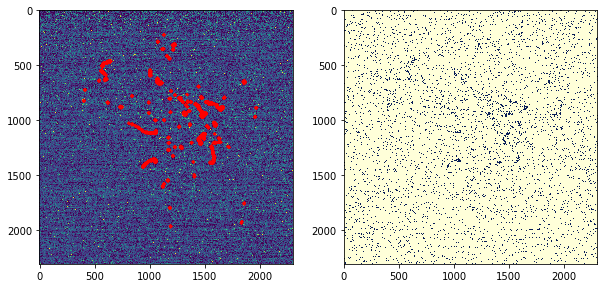

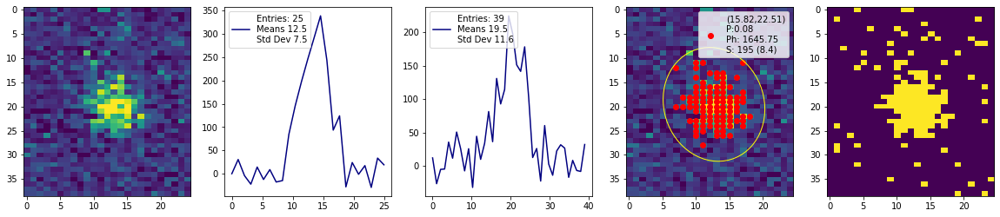

>>>> Processing RUN:  4039 Event:  1
>>>> Processing RUN:  4039 Event:  2
>>>> Processing RUN:  4039 Event:  3
>>>> Processing RUN:  4039 Event:  4
>>>> Processing RUN:  4039 Event:  5
>>>> Processing RUN:  4039 Event:  6
>>>> Processing RUN:  4039 Event:  7
>>>> Processing RUN:  4039 Event:  8
>>>> Processing RUN:  4039 Event:  9
>>>> Processing RUN:  4039 Event:  10
DEBUG: number of points, clusters: 333330 72
Elapsed time: 63.4
['iTr: 10.00', 'cluster_lable: 72.00', 'pixels: 151.00', 'photons: 747.62', 'ph_pixels: 4.95', 'x0start: 1218.00', 'y0start: 2124.00', 'x0end: 1219.00', 'y0end: 2137.00', 'width: 13.86', 'height: 22.00', 'pearson: -0.26']


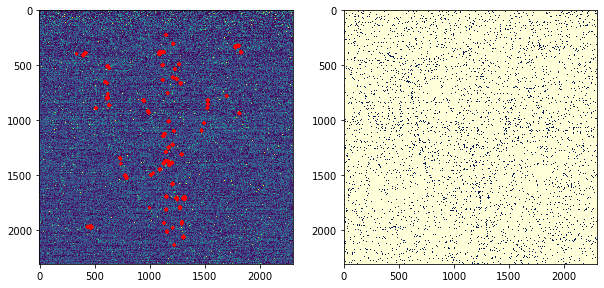

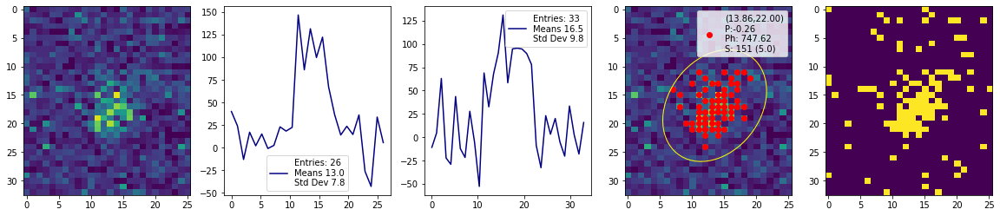

>>>> Processing RUN:  4039 Event:  11
>>>> Processing RUN:  4039 Event:  12
>>>> Processing RUN:  4039 Event:  13
>>>> Processing RUN:  4039 Event:  14
>>>> Processing RUN:  4039 Event:  15
>>>> Processing RUN:  4039 Event:  16
>>>> Processing RUN:  4039 Event:  17
>>>> Processing RUN:  4039 Event:  18
>>>> Processing RUN:  4039 Event:  19
>>>> Processing RUN:  4039 Event:  20
DEBUG: number of points, clusters: 336517 92
Elapsed time: 63.8
['iTr: 20.00', 'cluster_lable: 92.00', 'pixels: 257.00', 'photons: 1541.43', 'ph_pixels: 6.00', 'x0start: 1142.00', 'y0start: 2064.00', 'x0end: 1143.00', 'y0end: 2082.00', 'width: 17.36', 'height: 26.70', 'pearson: -0.16']


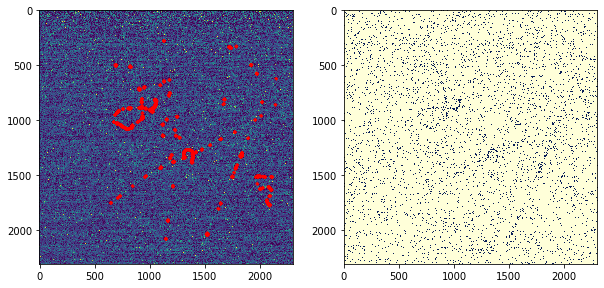

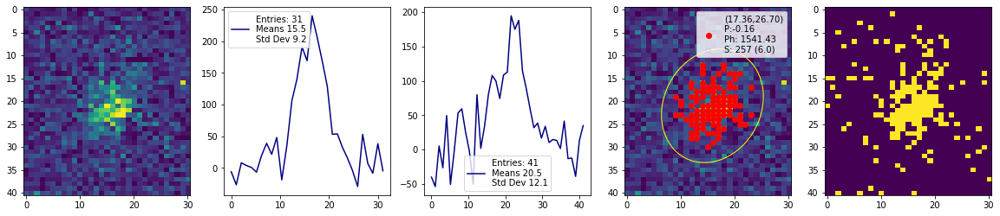

>>>> Processing RUN:  4039 Event:  21
>>>> Processing RUN:  4039 Event:  22
>>>> Processing RUN:  4039 Event:  23
>>>> Processing RUN:  4039 Event:  24
>>>> Processing RUN:  4039 Event:  25
>>>> Processing RUN:  4039 Event:  26
>>>> Processing RUN:  4039 Event:  27
>>>> Processing RUN:  4039 Event:  28


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4039 Event:  29
>>>> Processing RUN:  4039 Event:  30
DEBUG: number of points, clusters: 351073 127
Elapsed time: 86.1
['iTr: 30.00', 'cluster_lable: 127.00', 'pixels: 227.00', 'photons: 1389.28', 'ph_pixels: 6.12', 'x0start: 1190.00', 'y0start: 1965.00', 'x0end: 1187.00', 'y0end: 1983.00', 'width: 18.09', 'height: 24.36', 'pearson: -0.04']


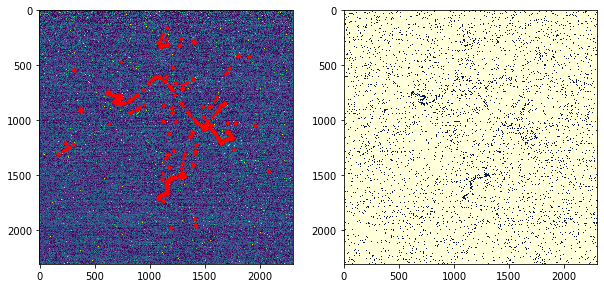

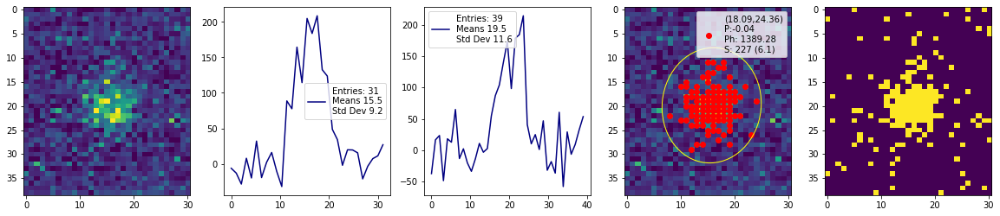

>>>> Processing RUN:  4039 Event:  31
>>>> Processing RUN:  4039 Event:  32
>>>> Processing RUN:  4039 Event:  33
>>>> Processing RUN:  4039 Event:  34
>>>> Processing RUN:  4039 Event:  35
>>>> Processing RUN:  4039 Event:  36
>>>> Processing RUN:  4039 Event:  37
>>>> Processing RUN:  4039 Event:  38
>>>> Processing RUN:  4039 Event:  39
>>>> Processing RUN:  4039 Event:  40
DEBUG: number of points, clusters: 328473 71
Elapsed time: 64.7
['iTr: 40.00', 'cluster_lable: 71.00', 'pixels: 214.00', 'photons: 1434.80', 'ph_pixels: 6.70', 'x0start: 1128.00', 'y0start: 1911.00', 'x0end: 1131.00', 'y0end: 1928.00', 'width: 17.46', 'height: 22.56', 'pearson: -0.02']


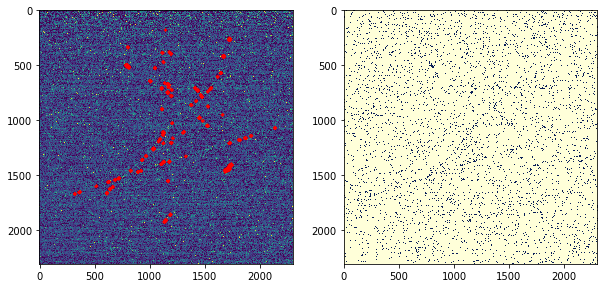

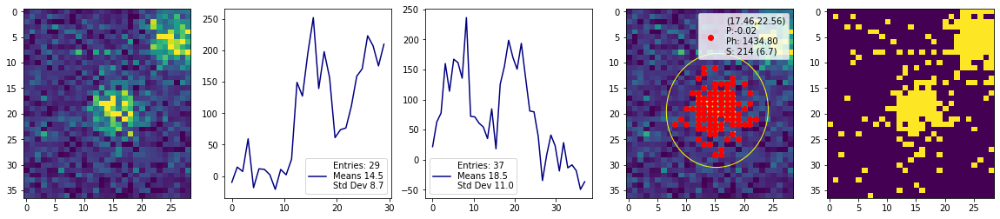

>>>> Processing RUN:  4039 Event:  41
>>>> Processing RUN:  4039 Event:  42
>>>> Processing RUN:  4039 Event:  43
>>>> Processing RUN:  4039 Event:  44
>>>> Processing RUN:  4039 Event:  45
>>>> Processing RUN:  4039 Event:  46
>>>> Processing RUN:  4039 Event:  47
>>>> Processing RUN:  4039 Event:  48
>>>> Processing RUN:  4039 Event:  49
>>>> Processing RUN:  4039 Event:  50
DEBUG: number of points, clusters: 336757 74
Elapsed time: 56.6
['iTr: 50.00', 'cluster_lable: 74.00', 'pixels: 255.00', 'photons: 1429.99', 'ph_pixels: 5.61', 'x0start: 1930.00', 'y0start: 2132.00', 'x0end: 1928.00', 'y0end: 2147.00', 'width: 18.85', 'height: 22.41', 'pearson: -0.01']


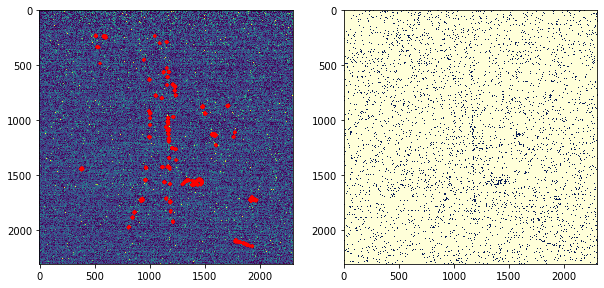

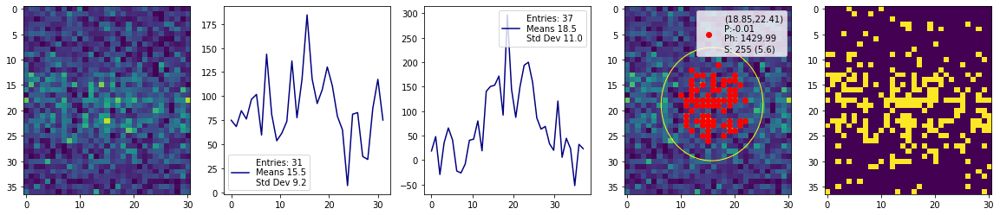

>>>> Processing RUN:  4039 Event:  51
>>>> Processing RUN:  4039 Event:  52
>>>> Processing RUN:  4039 Event:  53
>>>> Processing RUN:  4039 Event:  54
>>>> Processing RUN:  4039 Event:  55
>>>> Processing RUN:  4039 Event:  56
>>>> Processing RUN:  4039 Event:  57
>>>> Processing RUN:  4039 Event:  58
>>>> Processing RUN:  4039 Event:  59
>>>> Processing RUN:  4039 Event:  60
DEBUG: number of points, clusters: 338508 85
Elapsed time: 63.8
['iTr: 60.00', 'cluster_lable: 85.00', 'pixels: 127.00', 'photons: 676.56', 'ph_pixels: 5.33', 'x0start: 1994.00', 'y0start: 1874.00', 'x0end: 1993.00', 'y0end: 1885.00', 'width: 15.80', 'height: 15.22', 'pearson: -0.02']


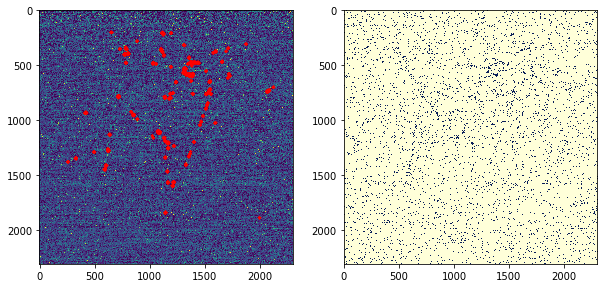

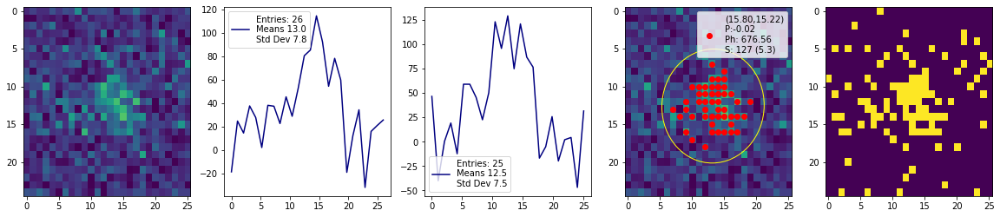

>>>> Processing RUN:  4039 Event:  61
>>>> Processing RUN:  4039 Event:  62
>>>> Processing RUN:  4039 Event:  63
>>>> Processing RUN:  4039 Event:  64
>>>> Processing RUN:  4039 Event:  65
>>>> Processing RUN:  4039 Event:  66
>>>> Processing RUN:  4039 Event:  67
>>>> Processing RUN:  4039 Event:  68
>>>> Processing RUN:  4039 Event:  69
>>>> Processing RUN:  4039 Event:  70
DEBUG: number of points, clusters: 347567 99
Elapsed time: 75.5
['iTr: 70.00', 'cluster_lable: 99.00', 'pixels: 370.00', 'photons: 1840.49', 'ph_pixels: 4.97', 'x0start: 511.00', 'y0start: 2149.00', 'x0end: 516.00', 'y0end: 2166.00', 'width: 26.94', 'height: 24.56', 'pearson: 0.10']


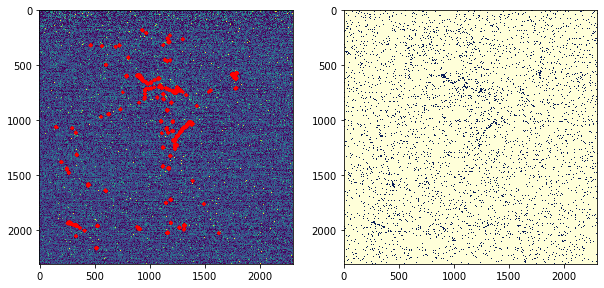

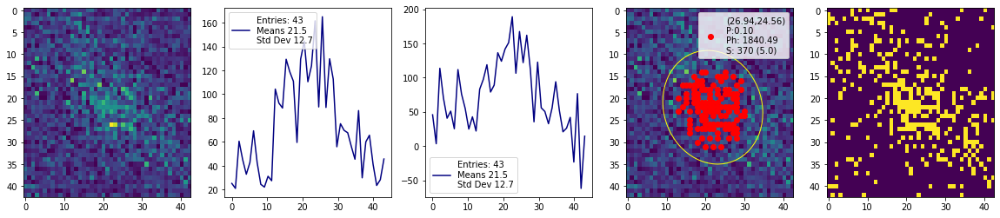

>>>> Processing RUN:  4039 Event:  71
>>>> Processing RUN:  4039 Event:  72
>>>> Processing RUN:  4039 Event:  73
>>>> Processing RUN:  4039 Event:  74
>>>> Processing RUN:  4039 Event:  75
>>>> Processing RUN:  4039 Event:  76
>>>> Processing RUN:  4039 Event:  77
>>>> Processing RUN:  4039 Event:  78
>>>> Processing RUN:  4039 Event:  79
>>>> Processing RUN:  4039 Event:  80
DEBUG: number of points, clusters: 355792 104
Elapsed time: 72.9
['iTr: 80.00', 'cluster_lable: 104.00', 'pixels: 504.00', 'photons: 2675.84', 'ph_pixels: 5.31', 'x0start: 1669.00', 'y0start: 2096.00', 'x0end: 1662.00', 'y0end: 2117.00', 'width: 29.88', 'height: 30.66', 'pearson: -0.17']


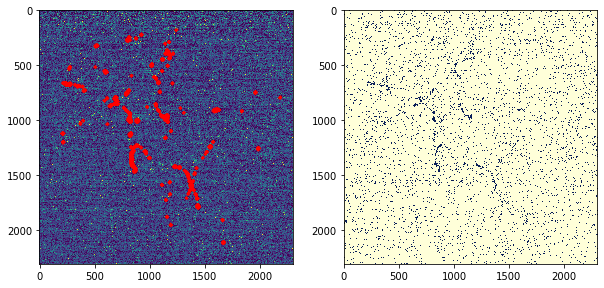

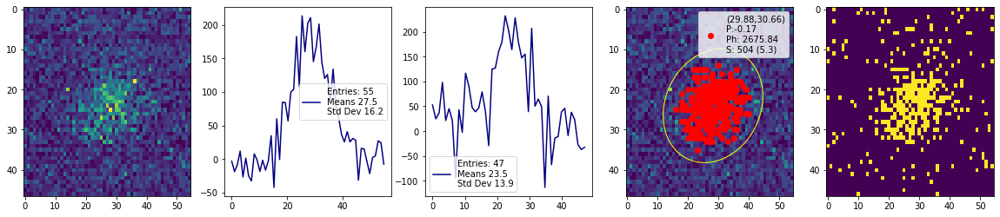

>>>> Processing RUN:  4039 Event:  81
>>>> Processing RUN:  4039 Event:  82
>>>> Processing RUN:  4039 Event:  83
>>>> Processing RUN:  4039 Event:  84
>>>> Processing RUN:  4039 Event:  85
>>>> Processing RUN:  4039 Event:  86
>>>> Processing RUN:  4039 Event:  87
>>>> Processing RUN:  4039 Event:  88
>>>> Processing RUN:  4039 Event:  89
>>>> Processing RUN:  4039 Event:  90
DEBUG: number of points, clusters: 320615 42
Elapsed time: 64.8
['iTr: 90.00', 'cluster_lable: 42.00', 'pixels: 261.00', 'photons: 1403.43', 'ph_pixels: 5.38', 'x0start: 1177.00', 'y0start: 2127.00', 'x0end: 1185.00', 'y0end: 2143.00', 'width: 21.34', 'height: 21.71', 'pearson: 0.16']


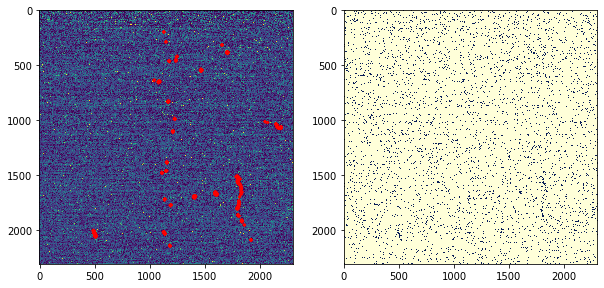

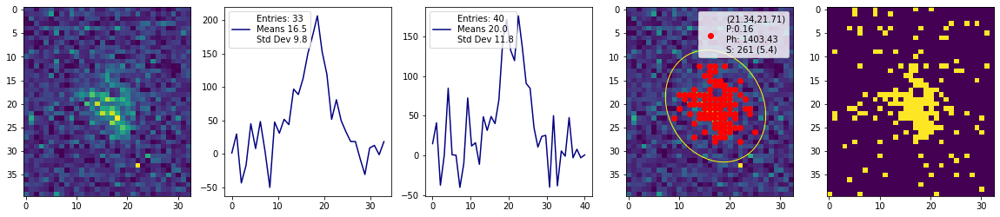

>>>> Processing RUN:  4039 Event:  91
>>>> Processing RUN:  4039 Event:  92
>>>> Processing RUN:  4039 Event:  93
>>>> Processing RUN:  4039 Event:  94
>>>> Processing RUN:  4039 Event:  95
>>>> Processing RUN:  4039 Event:  96
>>>> Processing RUN:  4039 Event:  97
>>>> Processing RUN:  4039 Event:  98
>>>> Processing RUN:  4039 Event:  99
>>>> Processing RUN:  4039 Event:  100
DEBUG: number of points, clusters: 335104 65
Elapsed time: 59.3
['iTr: 100.00', 'cluster_lable: 65.00', 'pixels: 240.00', 'photons: 1603.98', 'ph_pixels: 6.68', 'x0start: 1179.00', 'y0start: 2008.00', 'x0end: 1177.00', 'y0end: 2026.00', 'width: 16.57', 'height: 24.95', 'pearson: -0.19']


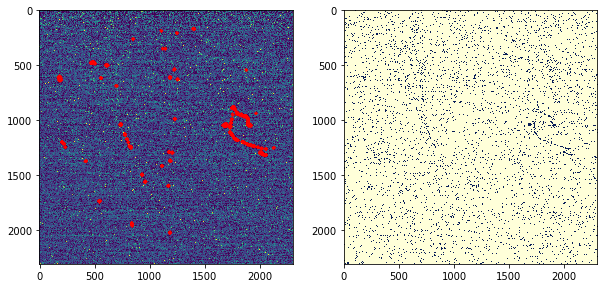

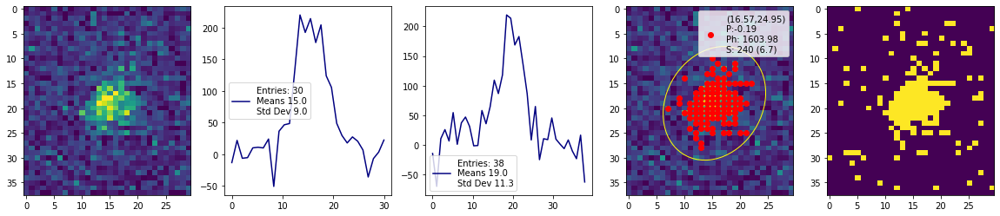

>>>> Processing RUN:  4039 Event:  101
>>>> Processing RUN:  4039 Event:  102
>>>> Processing RUN:  4039 Event:  103
>>>> Processing RUN:  4039 Event:  104
>>>> Processing RUN:  4039 Event:  105
>>>> Processing RUN:  4039 Event:  106
>>>> Processing RUN:  4039 Event:  107
>>>> Processing RUN:  4039 Event:  108
>>>> Processing RUN:  4039 Event:  109
>>>> Processing RUN:  4039 Event:  110
DEBUG: number of points, clusters: 360567 111
Elapsed time: 62.3
['iTr: 110.00', 'cluster_lable: 111.00', 'pixels: 558.00', 'photons: 3709.26', 'ph_pixels: 6.65', 'x0start: 932.00', 'y0start: 2053.00', 'x0end: 935.00', 'y0end: 2074.00', 'width: 32.64', 'height: 29.46', 'pearson: -0.08']


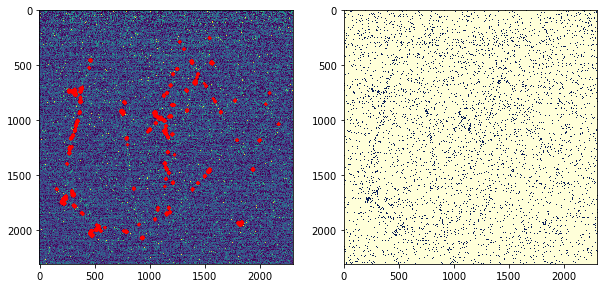

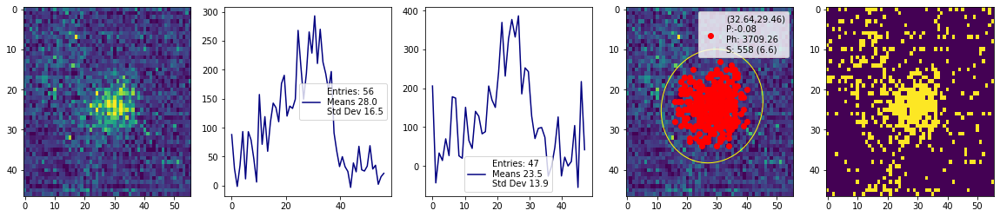

>>>> Processing RUN:  4039 Event:  111
>>>> Processing RUN:  4039 Event:  112
>>>> Processing RUN:  4039 Event:  113
>>>> Processing RUN:  4039 Event:  114
>>>> Processing RUN:  4039 Event:  115
>>>> Processing RUN:  4039 Event:  116
>>>> Processing RUN:  4039 Event:  117
>>>> Processing RUN:  4039 Event:  118
>>>> Processing RUN:  4039 Event:  119
>>>> Processing RUN:  4039 Event:  120
DEBUG: number of points, clusters: 374058 151
Elapsed time: 62.8
['iTr: 120.00', 'cluster_lable: 151.00', 'pixels: 263.00', 'photons: 1200.93', 'ph_pixels: 4.57', 'x0start: 649.00', 'y0start: 2164.00', 'x0end: 651.00', 'y0end: 2179.00', 'width: 22.94', 'height: 20.47', 'pearson: 0.19']


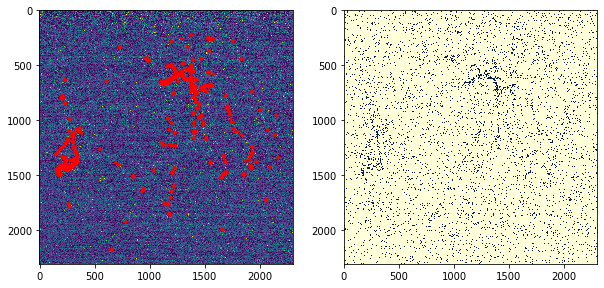

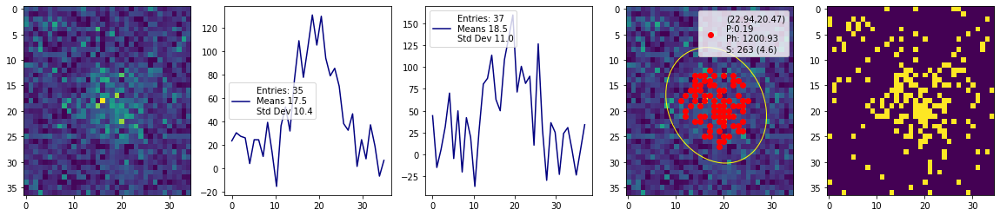

>>>> Processing RUN:  4039 Event:  121
>>>> Processing RUN:  4039 Event:  122
>>>> Processing RUN:  4039 Event:  123
>>>> Processing RUN:  4039 Event:  124
>>>> Processing RUN:  4039 Event:  125
>>>> Processing RUN:  4039 Event:  126
>>>> Processing RUN:  4039 Event:  127
>>>> Processing RUN:  4039 Event:  128
>>>> Processing RUN:  4039 Event:  129
>>>> Processing RUN:  4039 Event:  130
DEBUG: number of points, clusters: 340551 97
Elapsed time: 81.7
['iTr: 130.00', 'cluster_lable: 97.00', 'pixels: 311.00', 'photons: 1586.80', 'ph_pixels: 5.10', 'x0start: 1191.00', 'y0start: 2025.00', 'x0end: 1194.00', 'y0end: 2043.00', 'width: 24.00', 'height: 24.65', 'pearson: 0.09']


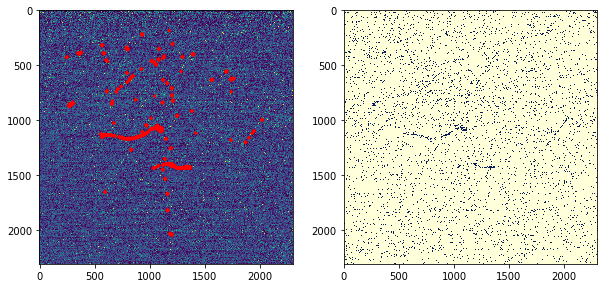

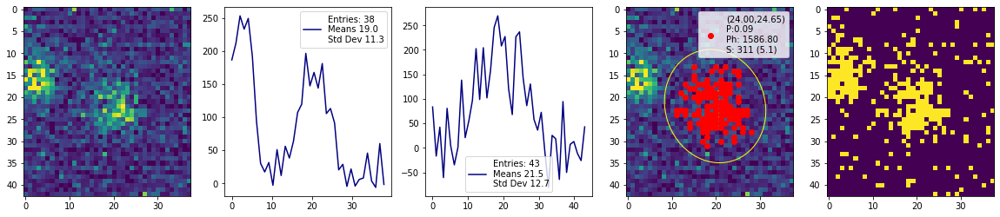

>>>> Processing RUN:  4039 Event:  131
>>>> Processing RUN:  4039 Event:  132
>>>> Processing RUN:  4039 Event:  133
>>>> Processing RUN:  4039 Event:  134
>>>> Processing RUN:  4039 Event:  135
>>>> Processing RUN:  4039 Event:  136
>>>> Processing RUN:  4039 Event:  137
>>>> Processing RUN:  4039 Event:  138
>>>> Processing RUN:  4039 Event:  139
>>>> Processing RUN:  4039 Event:  140
DEBUG: number of points, clusters: 375026 216
Elapsed time: 77.2
['iTr: 140.00', 'cluster_lable: 216.00', 'pixels: 561.00', 'photons: 2812.64', 'ph_pixels: 5.01', 'x0start: 1043.00', 'y0start: 2045.00', 'x0end: 1048.00', 'y0end: 2070.00', 'width: 24.83', 'height: 39.83', 'pearson: -0.03']


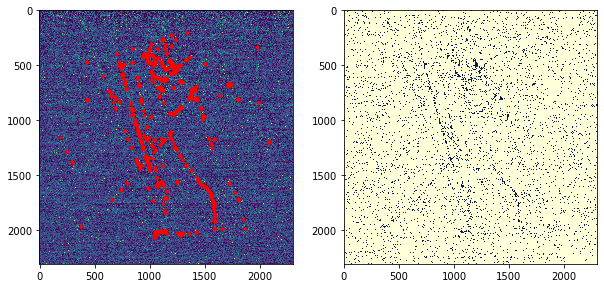

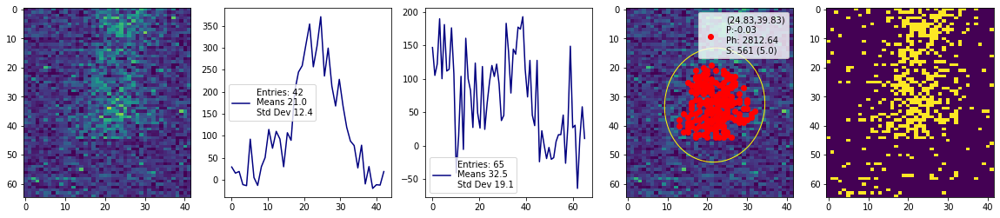

>>>> Processing RUN:  4039 Event:  141
>>>> Processing RUN:  4039 Event:  142
>>>> Processing RUN:  4039 Event:  143
>>>> Processing RUN:  4039 Event:  144
>>>> Processing RUN:  4039 Event:  145
>>>> Processing RUN:  4039 Event:  146
>>>> Processing RUN:  4039 Event:  147
>>>> Processing RUN:  4039 Event:  148
>>>> Processing RUN:  4039 Event:  149
>>>> Processing RUN:  4039 Event:  150
DEBUG: number of points, clusters: 361663 143
Elapsed time: 59.6
['iTr: 150.00', 'cluster_lable: 143.00', 'pixels: 308.00', 'photons: 1764.61', 'ph_pixels: 5.73', 'x0start: 1156.00', 'y0start: 2060.00', 'x0end: 1154.00', 'y0end: 2079.00', 'width: 23.48', 'height: 23.95', 'pearson: 0.02']


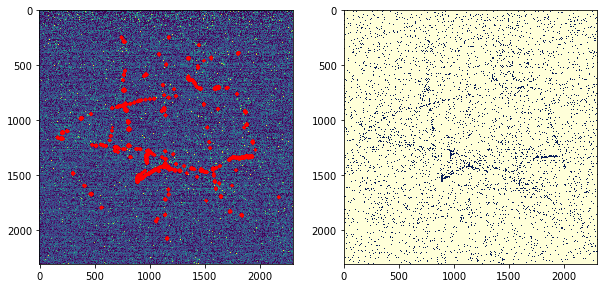

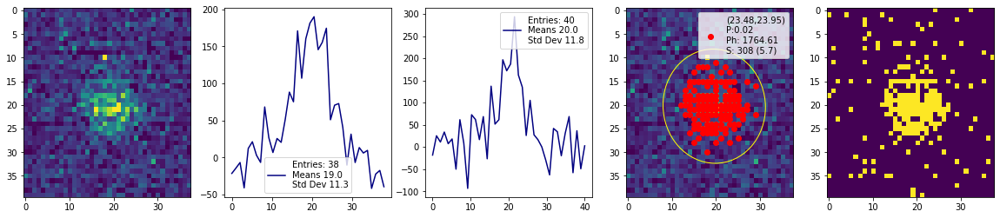

>>>> Processing RUN:  4039 Event:  151
>>>> Processing RUN:  4039 Event:  152
>>>> Processing RUN:  4039 Event:  153
>>>> Processing RUN:  4039 Event:  154
>>>> Processing RUN:  4039 Event:  155
>>>> Processing RUN:  4039 Event:  156
>>>> Processing RUN:  4039 Event:  157
>>>> Processing RUN:  4039 Event:  158
>>>> Processing RUN:  4039 Event:  159
>>>> Processing RUN:  4039 Event:  160
DEBUG: number of points, clusters: 341445 97
Elapsed time: 65.0
['iTr: 160.00', 'cluster_lable: 97.00', 'pixels: 141.00', 'photons: 714.87', 'ph_pixels: 5.07', 'x0start: 1172.00', 'y0start: 2053.00', 'x0end: 1175.00', 'y0end: 2063.00', 'width: 17.20', 'height: 14.50', 'pearson: 0.18']


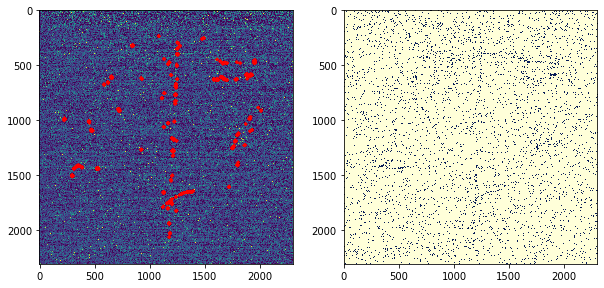

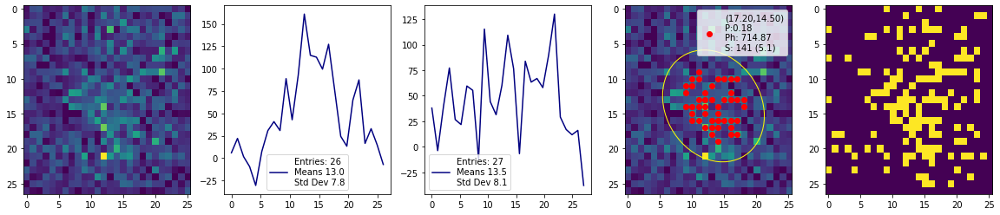

>>>> Processing RUN:  4039 Event:  161
>>>> Processing RUN:  4039 Event:  162
>>>> Processing RUN:  4039 Event:  163
>>>> Processing RUN:  4039 Event:  164
>>>> Processing RUN:  4039 Event:  165
>>>> Processing RUN:  4039 Event:  166
>>>> Processing RUN:  4039 Event:  167
>>>> Processing RUN:  4039 Event:  168
>>>> Processing RUN:  4039 Event:  169
>>>> Processing RUN:  4039 Event:  170
DEBUG: number of points, clusters: 329087 70
Elapsed time: 61.5
['iTr: 170.00', 'cluster_lable: 70.00', 'pixels: 239.00', 'photons: 1158.24', 'ph_pixels: 4.85', 'x0start: 528.00', 'y0start: 2077.00', 'x0end: 530.00', 'y0end: 2089.00', 'width: 25.09', 'height: 17.44', 'pearson: 0.15']


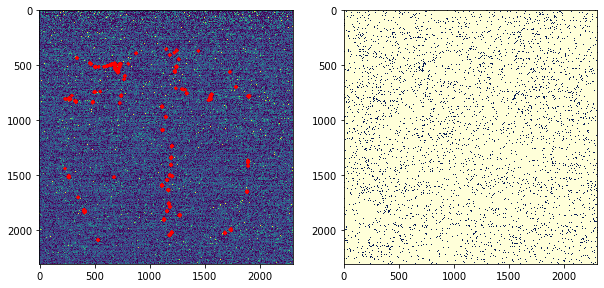

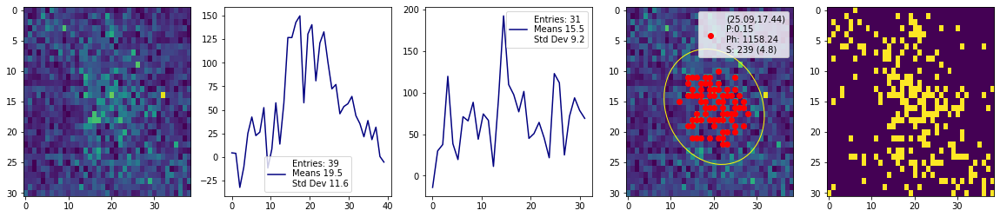

>>>> Processing RUN:  4039 Event:  171
>>>> Processing RUN:  4039 Event:  172
>>>> Processing RUN:  4039 Event:  173
>>>> Processing RUN:  4039 Event:  174
>>>> Processing RUN:  4039 Event:  175
>>>> Processing RUN:  4039 Event:  176


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4039 Event:  177
>>>> Processing RUN:  4039 Event:  178
>>>> Processing RUN:  4039 Event:  179
>>>> Processing RUN:  4039 Event:  180
DEBUG: number of points, clusters: 335870 74
Elapsed time: 67.8
['iTr: 180.00', 'cluster_lable: 74.00', 'pixels: 187.00', 'photons: 1299.60', 'ph_pixels: 6.95', 'x0start: 1133.00', 'y0start: 1916.00', 'x0end: 1136.00', 'y0end: 1929.00', 'width: 21.93', 'height: 16.02', 'pearson: 0.24']


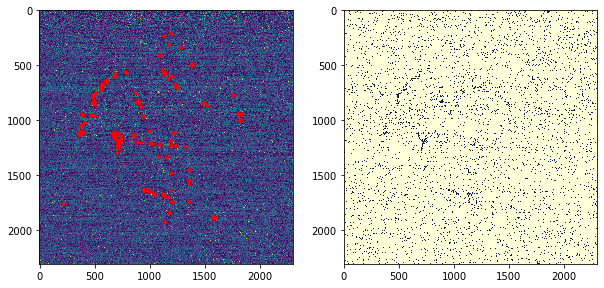

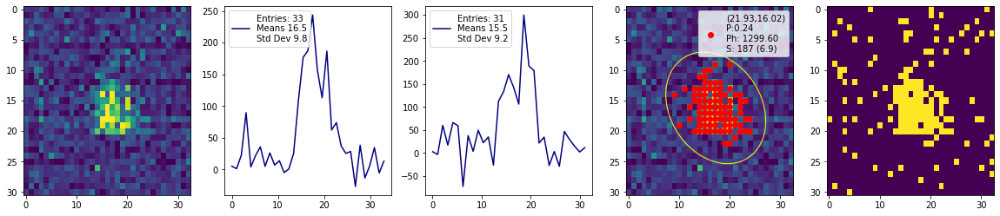

>>>> Processing RUN:  4039 Event:  181
>>>> Processing RUN:  4039 Event:  182
>>>> Processing RUN:  4039 Event:  183
>>>> Processing RUN:  4039 Event:  184
>>>> Processing RUN:  4039 Event:  185
>>>> Processing RUN:  4039 Event:  186
>>>> Processing RUN:  4039 Event:  187
>>>> Processing RUN:  4039 Event:  188
>>>> Processing RUN:  4039 Event:  189
>>>> Processing RUN:  4039 Event:  190
DEBUG: number of points, clusters: 349247 136
Elapsed time: 66.3
['iTr: 190.00', 'cluster_lable: 136.00', 'pixels: 238.00', 'photons: 1224.39', 'ph_pixels: 5.14', 'x0start: 1144.00', 'y0start: 2183.00', 'x0end: 1143.00', 'y0end: 2200.00', 'width: 17.30', 'height: 25.18', 'pearson: -0.24']


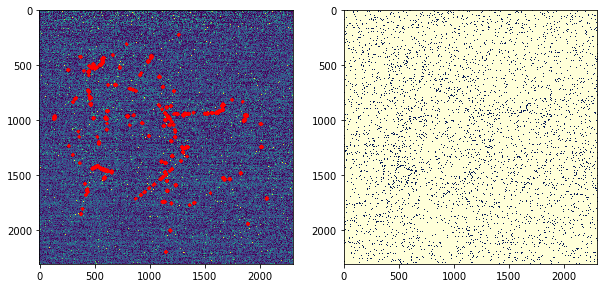

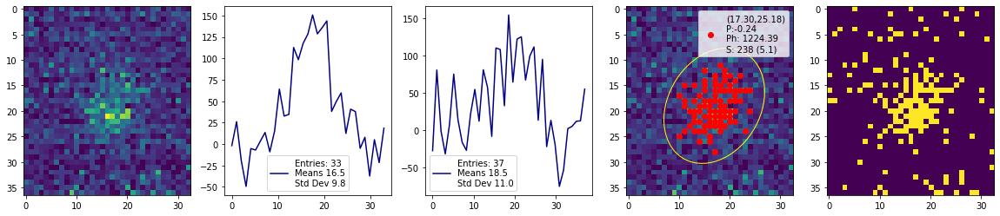

>>>> Processing RUN:  4039 Event:  191
>>>> Processing RUN:  4039 Event:  192
>>>> Processing RUN:  4039 Event:  193
>>>> Processing RUN:  4039 Event:  194
>>>> Processing RUN:  4039 Event:  195
>>>> Processing RUN:  4039 Event:  196
>>>> Processing RUN:  4039 Event:  197
>>>> Processing RUN:  4039 Event:  198
>>>> Processing RUN:  4039 Event:  199
out file /workarea/cloud-storage/mazzitel/out/dbscan_run4039_cmin_0_cmax_500_rescale_2304_nsigma_1.5_ev_200_ped_4038.plk.gz
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04040.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4040 Event:  0
DEBUG: number of points, clusters: 350378 118
Elapsed time: 68.5
['iTr: 0.00', 'cluster_lable: 118.00', 'pixels: 285.00', 'photons: 1501.01', 'ph_pixels: 5.27', 'x0start: 1161.00', 'y0start: 2071.00', 'x0end: 1166.00', 'y0end: 2090.00', 'width: 22.00', 'height: 25.03', 'pearson: -0.03']


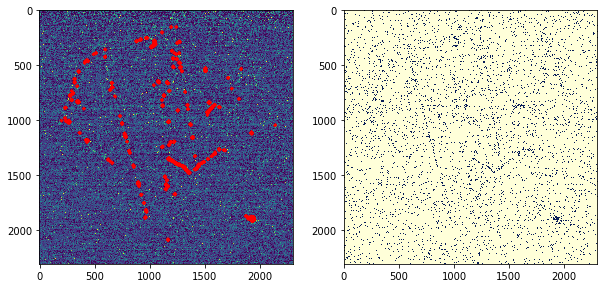

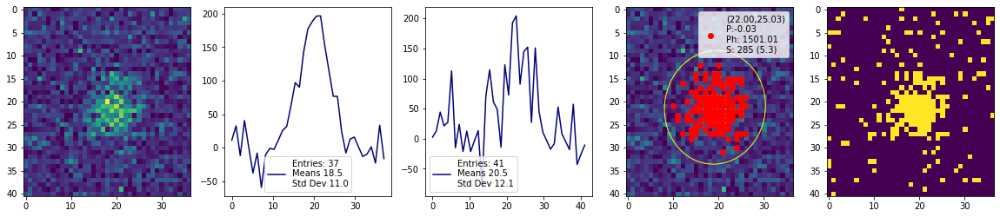

>>>> Processing RUN:  4040 Event:  1
>>>> Processing RUN:  4040 Event:  2
>>>> Processing RUN:  4040 Event:  3
>>>> Processing RUN:  4040 Event:  4
>>>> Processing RUN:  4040 Event:  5
>>>> Processing RUN:  4040 Event:  6
>>>> Processing RUN:  4040 Event:  7
>>>> Processing RUN:  4040 Event:  8
>>>> Processing RUN:  4040 Event:  9
>>>> Processing RUN:  4040 Event:  10
DEBUG: number of points, clusters: 356914 144
Elapsed time: 68.4
['iTr: 10.00', 'cluster_lable: 144.00', 'pixels: 245.00', 'photons: 1463.86', 'ph_pixels: 5.97', 'x0start: 1147.00', 'y0start: 2132.00', 'x0end: 1146.00', 'y0end: 2146.00', 'width: 16.67', 'height: 26.16', 'pearson: -0.30']


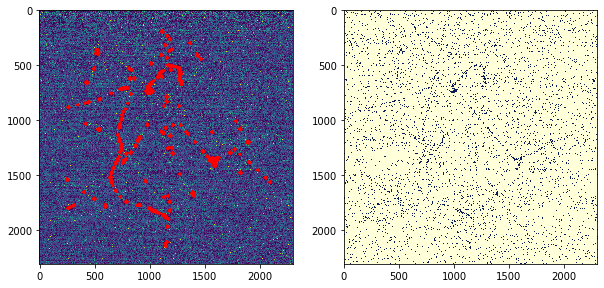

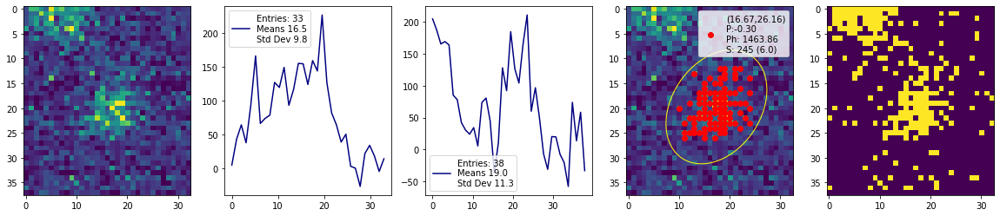

>>>> Processing RUN:  4040 Event:  11
>>>> Processing RUN:  4040 Event:  12
>>>> Processing RUN:  4040 Event:  13
>>>> Processing RUN:  4040 Event:  14
>>>> Processing RUN:  4040 Event:  15
>>>> Processing RUN:  4040 Event:  16
>>>> Processing RUN:  4040 Event:  17
>>>> Processing RUN:  4040 Event:  18
>>>> Processing RUN:  4040 Event:  19
>>>> Processing RUN:  4040 Event:  20
DEBUG: number of points, clusters: 336844 101
Elapsed time: 69.4
['iTr: 20.00', 'cluster_lable: 101.00', 'pixels: 219.00', 'photons: 1209.35', 'ph_pixels: 5.52', 'x0start: 1185.00', 'y0start: 2161.00', 'x0end: 1190.00', 'y0end: 2175.00', 'width: 22.26', 'height: 19.56', 'pearson: 0.15']


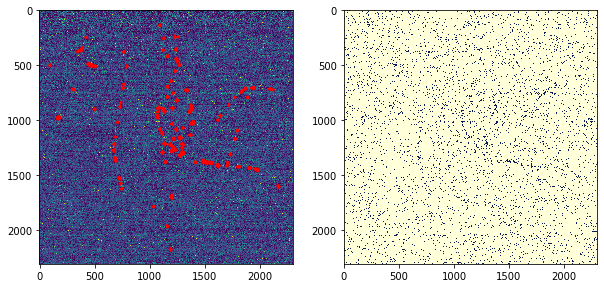

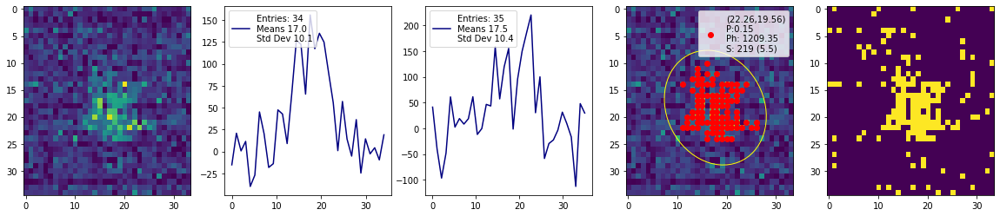

>>>> Processing RUN:  4040 Event:  21
>>>> Processing RUN:  4040 Event:  22
>>>> Processing RUN:  4040 Event:  23
>>>> Processing RUN:  4040 Event:  24
>>>> Processing RUN:  4040 Event:  25
>>>> Processing RUN:  4040 Event:  26
>>>> Processing RUN:  4040 Event:  27
>>>> Processing RUN:  4040 Event:  28
>>>> Processing RUN:  4040 Event:  29
>>>> Processing RUN:  4040 Event:  30
DEBUG: number of points, clusters: 346389 131
Elapsed time: 64.9
['iTr: 30.00', 'cluster_lable: 131.00', 'pixels: 129.00', 'photons: 534.77', 'ph_pixels: 4.15', 'x0start: 1670.00', 'y0start: 2024.00', 'x0end: 1673.00', 'y0end: 2033.00', 'width: 17.46', 'height: 14.42', 'pearson: 0.10']


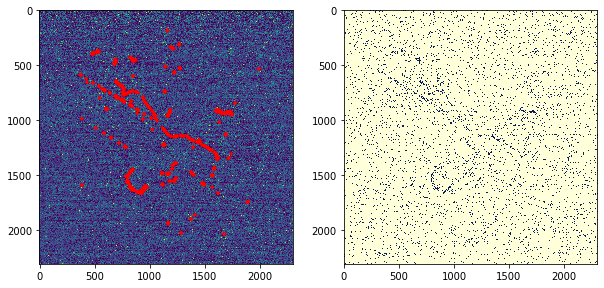

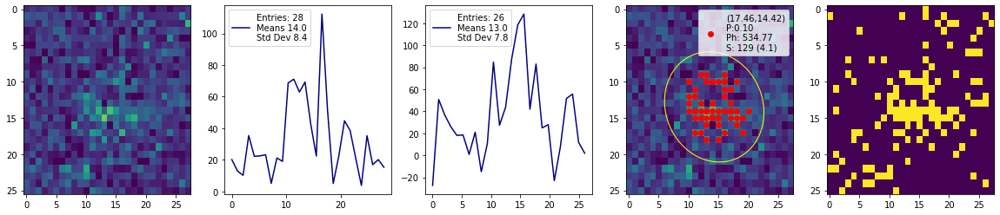

>>>> Processing RUN:  4040 Event:  31
>>>> Processing RUN:  4040 Event:  32
>>>> Processing RUN:  4040 Event:  33
>>>> Processing RUN:  4040 Event:  34
>>>> Processing RUN:  4040 Event:  35
>>>> Processing RUN:  4040 Event:  36
>>>> Processing RUN:  4040 Event:  37
>>>> Processing RUN:  4040 Event:  38
>>>> Processing RUN:  4040 Event:  39
>>>> Processing RUN:  4040 Event:  40
DEBUG: number of points, clusters: 360772 133
Elapsed time: 63.6
['iTr: 40.00', 'cluster_lable: 133.00', 'pixels: 582.00', 'photons: 3460.34', 'ph_pixels: 5.95', 'x0start: 588.00', 'y0start: 2040.00', 'x0end: 588.00', 'y0end: 2061.00', 'width: 38.42', 'height: 27.00', 'pearson: -0.10']


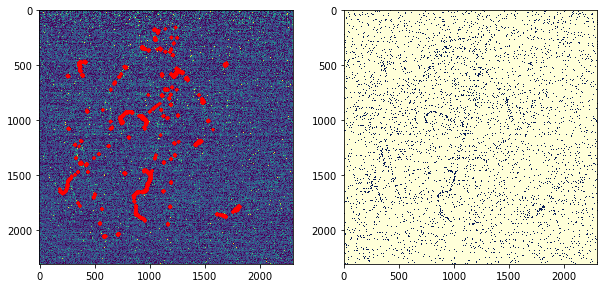

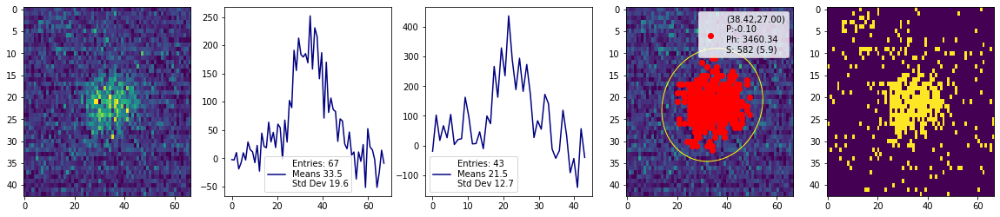

>>>> Processing RUN:  4040 Event:  41
>>>> Processing RUN:  4040 Event:  42
>>>> Processing RUN:  4040 Event:  43
>>>> Processing RUN:  4040 Event:  44
>>>> Processing RUN:  4040 Event:  45
>>>> Processing RUN:  4040 Event:  46
>>>> Processing RUN:  4040 Event:  47
>>>> Processing RUN:  4040 Event:  48
>>>> Processing RUN:  4040 Event:  49
>>>> Processing RUN:  4040 Event:  50
DEBUG: number of points, clusters: 341139 105
Elapsed time: 65.4
['iTr: 50.00', 'cluster_lable: 105.00', 'pixels: 150.00', 'photons: 794.55', 'ph_pixels: 5.30', 'x0start: 1152.00', 'y0start: 2183.00', 'x0end: 1155.00', 'y0end: 2193.00', 'width: 15.36', 'height: 18.12', 'pearson: -0.03']


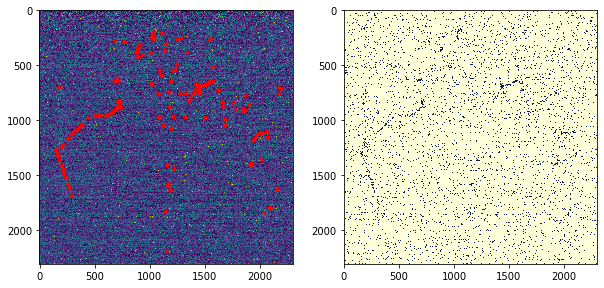

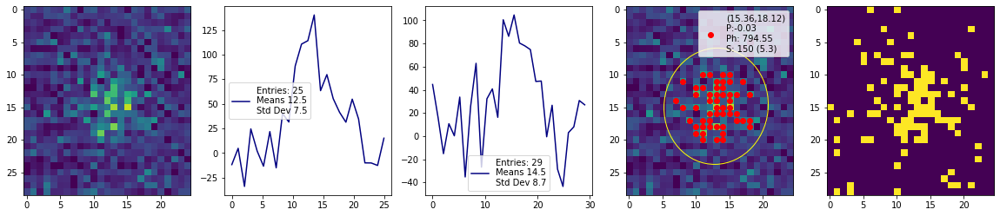

>>>> Processing RUN:  4040 Event:  51
>>>> Processing RUN:  4040 Event:  52
>>>> Processing RUN:  4040 Event:  53
>>>> Processing RUN:  4040 Event:  54
>>>> Processing RUN:  4040 Event:  55
>>>> Processing RUN:  4040 Event:  56
>>>> Processing RUN:  4040 Event:  57
>>>> Processing RUN:  4040 Event:  58
>>>> Processing RUN:  4040 Event:  59
>>>> Processing RUN:  4040 Event:  60
DEBUG: number of points, clusters: 323498 51
Elapsed time: 64.5
['iTr: 60.00', 'cluster_lable: 51.00', 'pixels: 209.00', 'photons: 1227.83', 'ph_pixels: 5.87', 'x0start: 1193.00', 'y0start: 2102.00', 'x0end: 1192.00', 'y0end: 2117.00', 'width: 19.00', 'height: 20.85', 'pearson: 0.11']


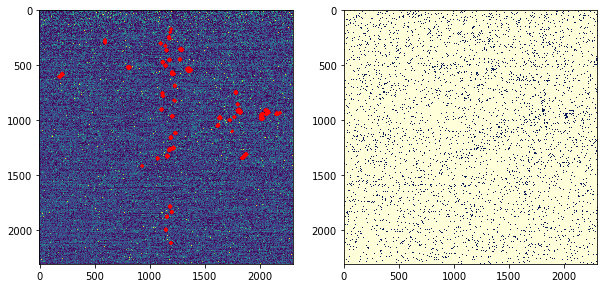

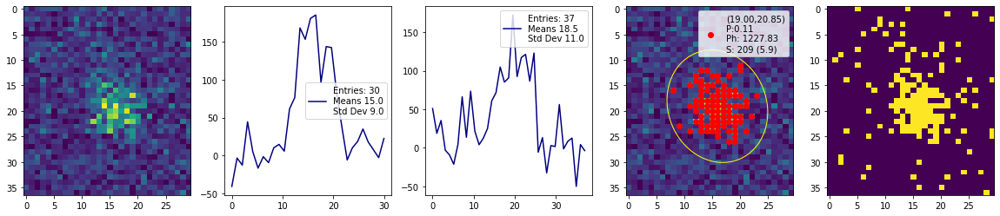

>>>> Processing RUN:  4040 Event:  61
>>>> Processing RUN:  4040 Event:  62
>>>> Processing RUN:  4040 Event:  63
>>>> Processing RUN:  4040 Event:  64
>>>> Processing RUN:  4040 Event:  65
>>>> Processing RUN:  4040 Event:  66
>>>> Processing RUN:  4040 Event:  67
>>>> Processing RUN:  4040 Event:  68
>>>> Processing RUN:  4040 Event:  69
>>>> Processing RUN:  4040 Event:  70
DEBUG: number of points, clusters: 347597 105
Elapsed time: 61.1
['iTr: 70.00', 'cluster_lable: 105.00', 'pixels: 243.00', 'photons: 1202.42', 'ph_pixels: 4.95', 'x0start: 344.00', 'y0start: 2150.00', 'x0end: 342.00', 'y0end: 2162.00', 'width: 21.92', 'height: 20.48', 'pearson: -0.28']


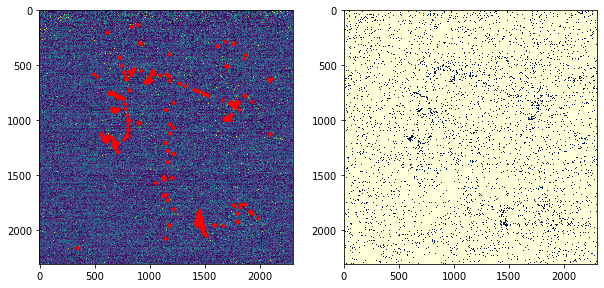

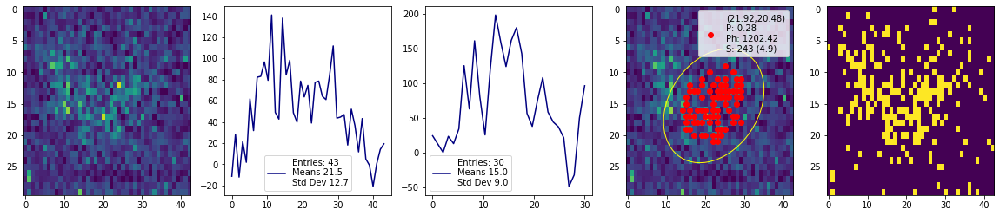

>>>> Processing RUN:  4040 Event:  71
>>>> Processing RUN:  4040 Event:  72
>>>> Processing RUN:  4040 Event:  73
>>>> Processing RUN:  4040 Event:  74
>>>> Processing RUN:  4040 Event:  75
>>>> Processing RUN:  4040 Event:  76
>>>> Processing RUN:  4040 Event:  77
>>>> Processing RUN:  4040 Event:  78
>>>> Processing RUN:  4040 Event:  79
>>>> Processing RUN:  4040 Event:  80
DEBUG: number of points, clusters: 347727 122
Elapsed time: 61.7
['iTr: 80.00', 'cluster_lable: 122.00', 'pixels: 363.00', 'photons: 2178.95', 'ph_pixels: 6.00', 'x0start: 1173.00', 'y0start: 2022.00', 'x0end: 1173.00', 'y0end: 2042.00', 'width: 22.96', 'height: 28.16', 'pearson: 0.02']


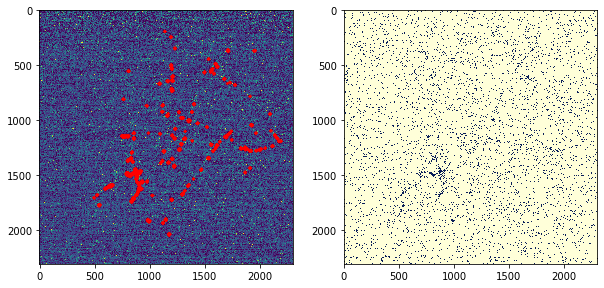

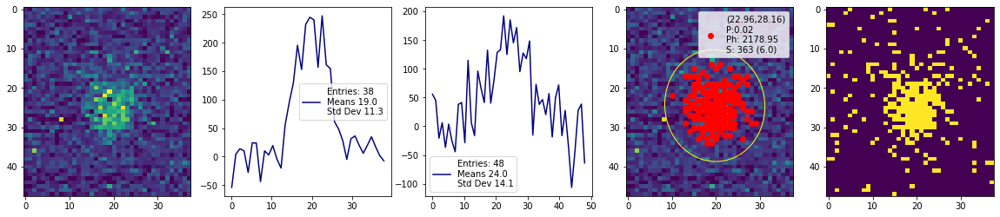

>>>> Processing RUN:  4040 Event:  81
>>>> Processing RUN:  4040 Event:  82
>>>> Processing RUN:  4040 Event:  83
>>>> Processing RUN:  4040 Event:  84
>>>> Processing RUN:  4040 Event:  85
>>>> Processing RUN:  4040 Event:  86
>>>> Processing RUN:  4040 Event:  87
>>>> Processing RUN:  4040 Event:  88
>>>> Processing RUN:  4040 Event:  89
>>>> Processing RUN:  4040 Event:  90
DEBUG: number of points, clusters: 343809 89
Elapsed time: 75.9
['iTr: 90.00', 'cluster_lable: 89.00', 'pixels: 244.00', 'photons: 1484.99', 'ph_pixels: 6.09', 'x0start: 1131.00', 'y0start: 2069.00', 'x0end: 1136.00', 'y0end: 2085.00', 'width: 18.20', 'height: 25.79', 'pearson: -0.07']


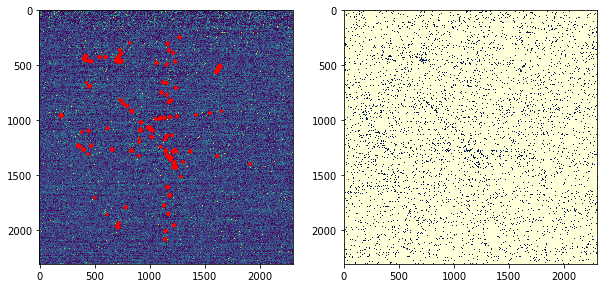

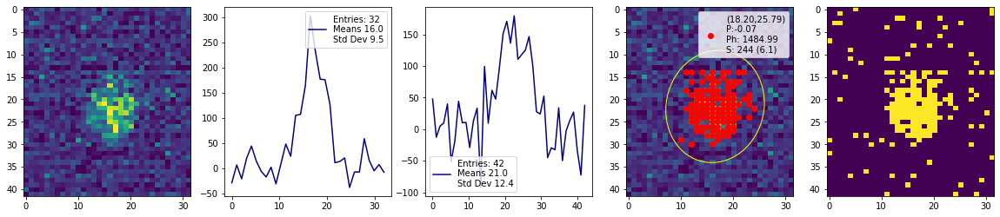

>>>> Processing RUN:  4040 Event:  91
>>>> Processing RUN:  4040 Event:  92
>>>> Processing RUN:  4040 Event:  93
>>>> Processing RUN:  4040 Event:  94
>>>> Processing RUN:  4040 Event:  95
>>>> Processing RUN:  4040 Event:  96
>>>> Processing RUN:  4040 Event:  97
>>>> Processing RUN:  4040 Event:  98
>>>> Processing RUN:  4040 Event:  99
>>>> Processing RUN:  4040 Event:  100
DEBUG: number of points, clusters: 333084 81
Elapsed time: 70.9
['iTr: 100.00', 'cluster_lable: 81.00', 'pixels: 313.00', 'photons: 1744.05', 'ph_pixels: 5.57', 'x0start: 1181.00', 'y0start: 2075.00', 'x0end: 1180.00', 'y0end: 2096.00', 'width: 21.74', 'height: 26.30', 'pearson: -0.00']


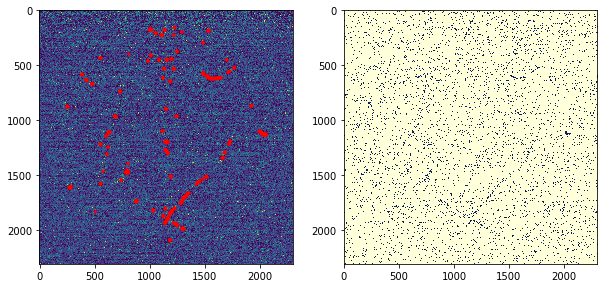

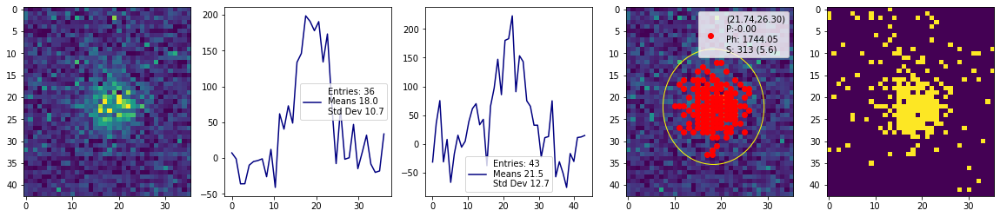

>>>> Processing RUN:  4040 Event:  101
>>>> Processing RUN:  4040 Event:  102
>>>> Processing RUN:  4040 Event:  103
>>>> Processing RUN:  4040 Event:  104
>>>> Processing RUN:  4040 Event:  105
>>>> Processing RUN:  4040 Event:  106
>>>> Processing RUN:  4040 Event:  107
>>>> Processing RUN:  4040 Event:  108
>>>> Processing RUN:  4040 Event:  109
>>>> Processing RUN:  4040 Event:  110
DEBUG: number of points, clusters: 344126 100
Elapsed time: 58.4
['iTr: 110.00', 'cluster_lable: 100.00', 'pixels: 286.00', 'photons: 1583.67', 'ph_pixels: 5.54', 'x0start: 1152.00', 'y0start: 2061.00', 'x0end: 1154.00', 'y0end: 2079.00', 'width: 21.34', 'height: 26.45', 'pearson: -0.03']


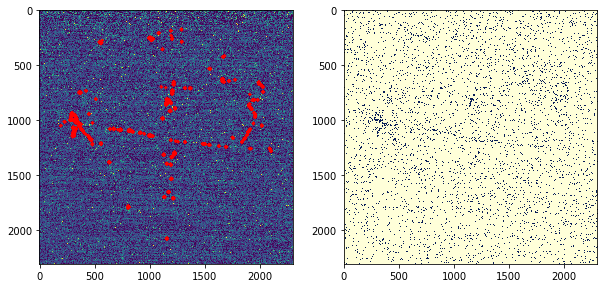

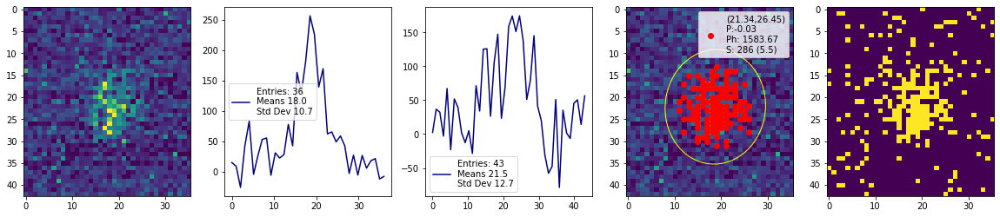

>>>> Processing RUN:  4040 Event:  111
>>>> Processing RUN:  4040 Event:  112
>>>> Processing RUN:  4040 Event:  113
>>>> Processing RUN:  4040 Event:  114
>>>> Processing RUN:  4040 Event:  115
>>>> Processing RUN:  4040 Event:  116
>>>> Processing RUN:  4040 Event:  117
>>>> Processing RUN:  4040 Event:  118
>>>> Processing RUN:  4040 Event:  119
>>>> Processing RUN:  4040 Event:  120
DEBUG: number of points, clusters: 344677 100
Elapsed time: 69.4
['iTr: 120.00', 'cluster_lable: 100.00', 'pixels: 266.00', 'photons: 1677.07', 'ph_pixels: 6.30', 'x0start: 1139.00', 'y0start: 2117.00', 'x0end: 1131.00', 'y0end: 2132.00', 'width: 22.07', 'height: 21.47', 'pearson: 0.00']


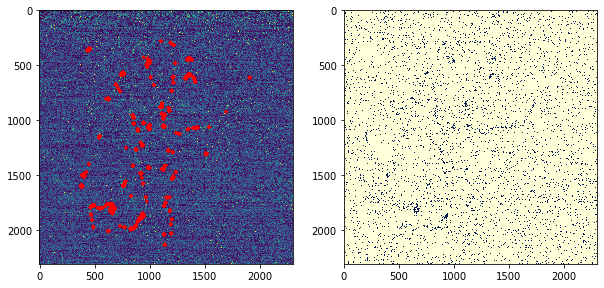

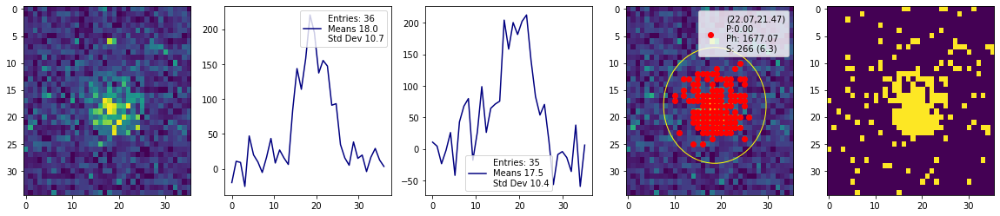

>>>> Processing RUN:  4040 Event:  121
>>>> Processing RUN:  4040 Event:  122
>>>> Processing RUN:  4040 Event:  123
>>>> Processing RUN:  4040 Event:  124
>>>> Processing RUN:  4040 Event:  125
>>>> Processing RUN:  4040 Event:  126
>>>> Processing RUN:  4040 Event:  127
>>>> Processing RUN:  4040 Event:  128
>>>> Processing RUN:  4040 Event:  129
>>>> Processing RUN:  4040 Event:  130
DEBUG: number of points, clusters: 345291 106
Elapsed time: 65.7
['iTr: 130.00', 'cluster_lable: 106.00', 'pixels: 843.00', 'photons: 5574.96', 'ph_pixels: 6.61', 'x0start: 640.00', 'y0start: 1923.00', 'x0end: 634.00', 'y0end: 1951.00', 'width: 33.34', 'height: 43.88', 'pearson: -0.35']


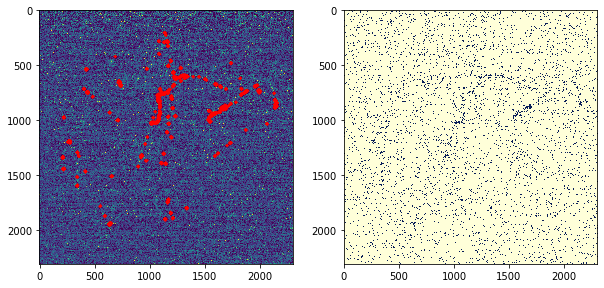

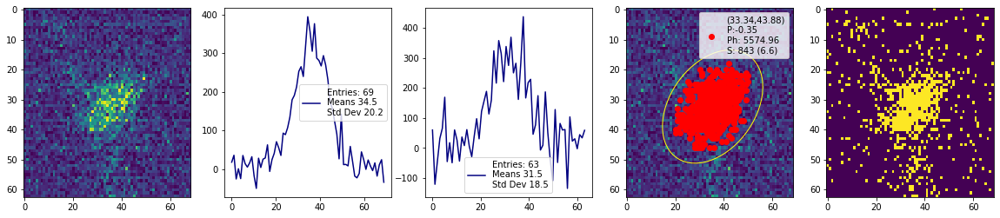

>>>> Processing RUN:  4040 Event:  131
>>>> Processing RUN:  4040 Event:  132
>>>> Processing RUN:  4040 Event:  133
>>>> Processing RUN:  4040 Event:  134
>>>> Processing RUN:  4040 Event:  135
>>>> Processing RUN:  4040 Event:  136
>>>> Processing RUN:  4040 Event:  137
>>>> Processing RUN:  4040 Event:  138
>>>> Processing RUN:  4040 Event:  139
>>>> Processing RUN:  4040 Event:  140
DEBUG: number of points, clusters: 352681 130
Elapsed time: 53.3
['iTr: 140.00', 'cluster_lable: 130.00', 'pixels: 293.00', 'photons: 1547.10', 'ph_pixels: 5.28', 'x0start: 1161.00', 'y0start: 2013.00', 'x0end: 1164.00', 'y0end: 2032.00', 'width: 25.02', 'height: 21.87', 'pearson: 0.11']


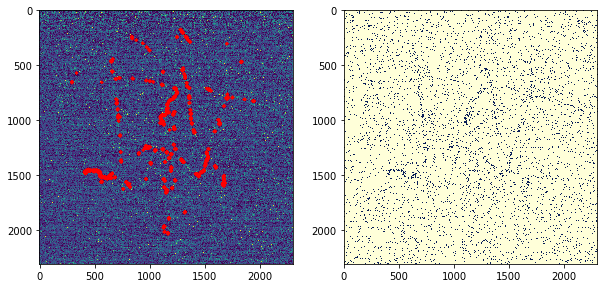

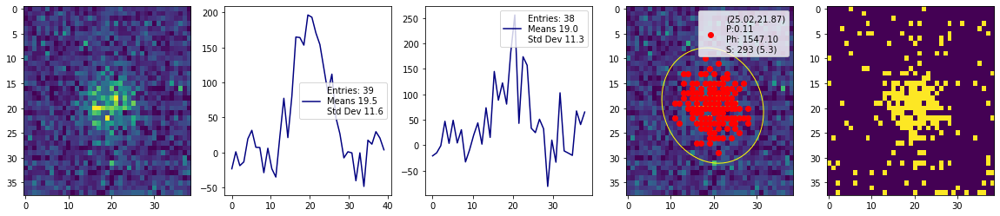

>>>> Processing RUN:  4040 Event:  141
>>>> Processing RUN:  4040 Event:  142
>>>> Processing RUN:  4040 Event:  143
>>>> Processing RUN:  4040 Event:  144
>>>> Processing RUN:  4040 Event:  145
>>>> Processing RUN:  4040 Event:  146
>>>> Processing RUN:  4040 Event:  147
>>>> Processing RUN:  4040 Event:  148
>>>> Processing RUN:  4040 Event:  149
>>>> Processing RUN:  4040 Event:  150
DEBUG: number of points, clusters: 343576 96
Elapsed time: 71.9
['iTr: 150.00', 'cluster_lable: 96.00', 'pixels: 263.00', 'photons: 1512.74', 'ph_pixels: 5.75', 'x0start: 1162.00', 'y0start: 2099.00', 'x0end: 1166.00', 'y0end: 2116.00', 'width: 18.57', 'height: 25.62', 'pearson: -0.12']


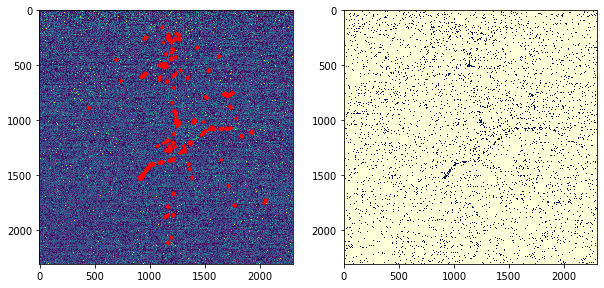

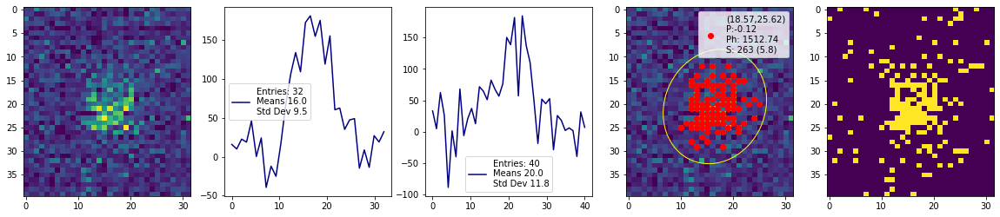

>>>> Processing RUN:  4040 Event:  151
>>>> Processing RUN:  4040 Event:  152
>>>> Processing RUN:  4040 Event:  153
>>>> Processing RUN:  4040 Event:  154
>>>> Processing RUN:  4040 Event:  155
>>>> Processing RUN:  4040 Event:  156
>>>> Processing RUN:  4040 Event:  157
>>>> Processing RUN:  4040 Event:  158
>>>> Processing RUN:  4040 Event:  159
>>>> Processing RUN:  4040 Event:  160
DEBUG: number of points, clusters: 352406 110
Elapsed time: 68.0
['iTr: 160.00', 'cluster_lable: 110.00', 'pixels: 274.00', 'photons: 1639.20', 'ph_pixels: 5.98', 'x0start: 1163.00', 'y0start: 2098.00', 'x0end: 1167.00', 'y0end: 2115.00', 'width: 24.03', 'height: 21.20', 'pearson: 0.13']


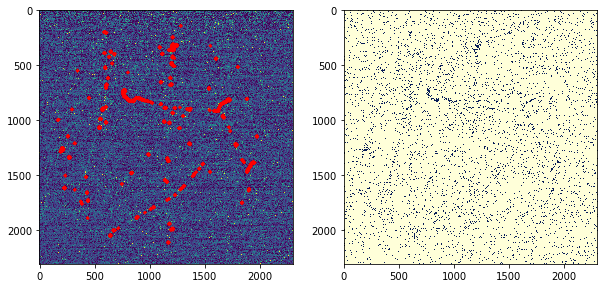

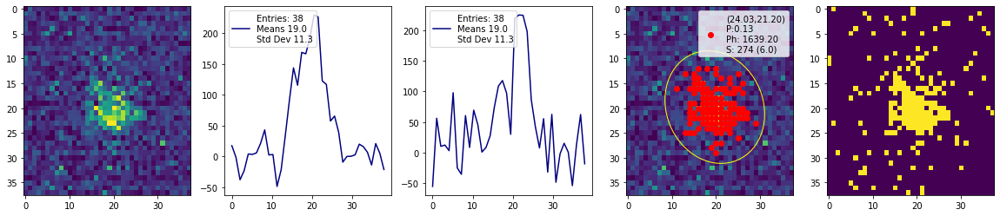

>>>> Processing RUN:  4040 Event:  161
>>>> Processing RUN:  4040 Event:  162
>>>> Processing RUN:  4040 Event:  163
>>>> Processing RUN:  4040 Event:  164
>>>> Processing RUN:  4040 Event:  165
>>>> Processing RUN:  4040 Event:  166
>>>> Processing RUN:  4040 Event:  167
>>>> Processing RUN:  4040 Event:  168
>>>> Processing RUN:  4040 Event:  169
>>>> Processing RUN:  4040 Event:  170
DEBUG: number of points, clusters: 345456 106
Elapsed time: 64.2
['iTr: 170.00', 'cluster_lable: 106.00', 'pixels: 278.00', 'photons: 1535.04', 'ph_pixels: 5.52', 'x0start: 1128.00', 'y0start: 2141.00', 'x0end: 1128.00', 'y0end: 2157.00', 'width: 21.45', 'height: 24.08', 'pearson: -0.11']


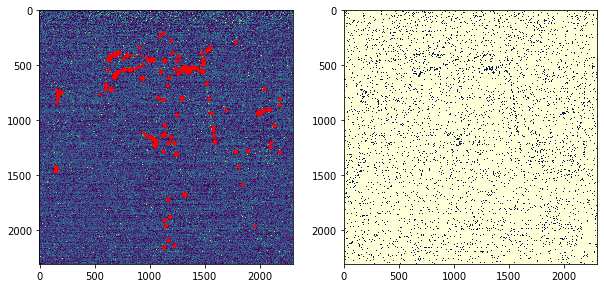

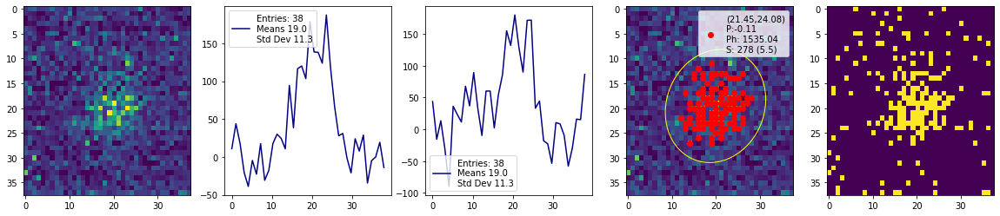

>>>> Processing RUN:  4040 Event:  171
>>>> Processing RUN:  4040 Event:  172
>>>> Processing RUN:  4040 Event:  173
>>>> Processing RUN:  4040 Event:  174
>>>> Processing RUN:  4040 Event:  175
>>>> Processing RUN:  4040 Event:  176
>>>> Processing RUN:  4040 Event:  177
>>>> Processing RUN:  4040 Event:  178
>>>> Processing RUN:  4040 Event:  179
>>>> Processing RUN:  4040 Event:  180
DEBUG: number of points, clusters: 350537 139
Elapsed time: 57.9
['iTr: 180.00', 'cluster_lable: 139.00', 'pixels: 238.00', 'photons: 1308.19', 'ph_pixels: 5.50', 'x0start: 1149.00', 'y0start: 2123.00', 'x0end: 1149.00', 'y0end: 2139.00', 'width: 22.52', 'height: 19.73', 'pearson: 0.22']


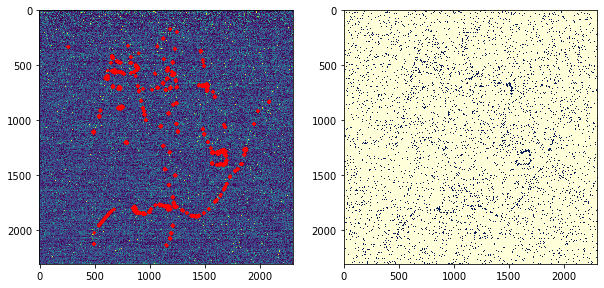

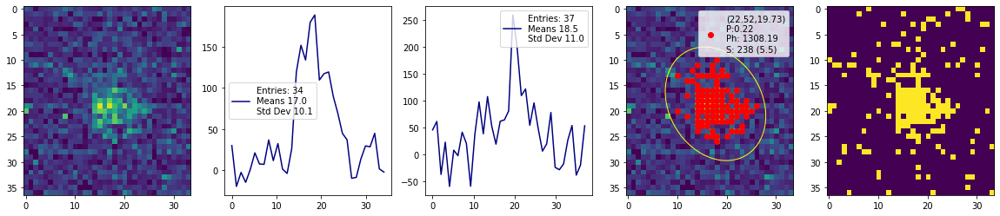

>>>> Processing RUN:  4040 Event:  181
>>>> Processing RUN:  4040 Event:  182
>>>> Processing RUN:  4040 Event:  183
>>>> Processing RUN:  4040 Event:  184
>>>> Processing RUN:  4040 Event:  185
>>>> Processing RUN:  4040 Event:  186
>>>> Processing RUN:  4040 Event:  187
>>>> Processing RUN:  4040 Event:  188
>>>> Processing RUN:  4040 Event:  189
>>>> Processing RUN:  4040 Event:  190
DEBUG: number of points, clusters: 349116 108
Elapsed time: 68.9
['iTr: 190.00', 'cluster_lable: 108.00', 'pixels: 249.00', 'photons: 1492.88', 'ph_pixels: 6.00', 'x0start: 1191.00', 'y0start: 2135.00', 'x0end: 1192.00', 'y0end: 2152.00', 'width: 17.41', 'height: 26.06', 'pearson: -0.14']


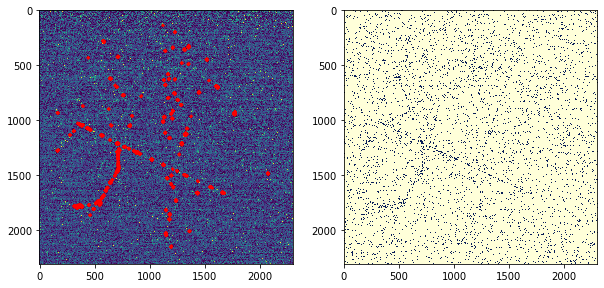

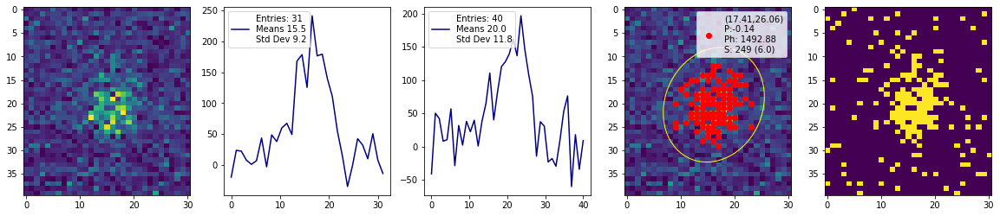

>>>> Processing RUN:  4040 Event:  191
>>>> Processing RUN:  4040 Event:  192
>>>> Processing RUN:  4040 Event:  193
>>>> Processing RUN:  4040 Event:  194
>>>> Processing RUN:  4040 Event:  195
>>>> Processing RUN:  4040 Event:  196
>>>> Processing RUN:  4040 Event:  197
>>>> Processing RUN:  4040 Event:  198
>>>> Processing RUN:  4040 Event:  199
out file /workarea/cloud-storage/mazzitel/out/dbscan_run4040_cmin_0_cmax_500_rescale_2304_nsigma_1.5_ev_200_ped_4038.plk.gz
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04041.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4041 Event:  0
DEBUG: number of points, clusters: 333881 67
Elapsed time: 63.7
['iTr: 0.00', 'cluster_lable: 67.00', 'pixels: 211.00', 'photons: 883.99', 'ph_pixels: 4.19', 'x0start: 1149.00', 'y0start: 2169.00', 'x0end: 1153.00', 'y0end: 2184.00', 'width: 18.88', 'height: 22.40', 'pearson: -0.02']


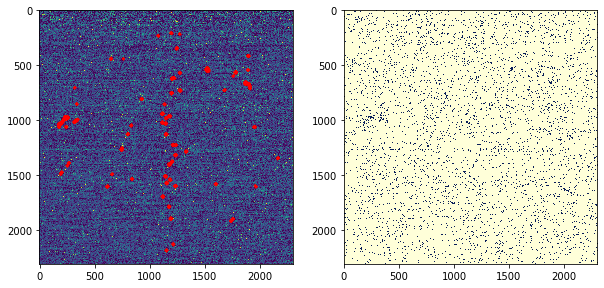

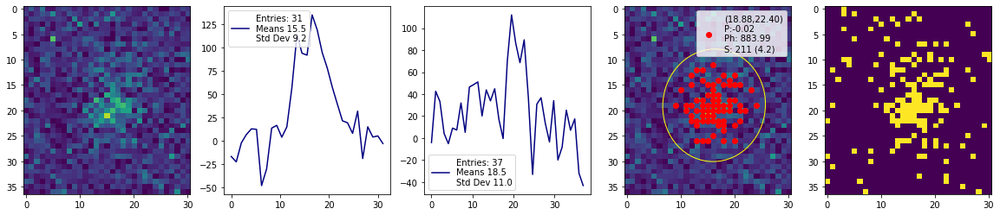

>>>> Processing RUN:  4041 Event:  1
>>>> Processing RUN:  4041 Event:  2
>>>> Processing RUN:  4041 Event:  3
>>>> Processing RUN:  4041 Event:  4
>>>> Processing RUN:  4041 Event:  5
>>>> Processing RUN:  4041 Event:  6
>>>> Processing RUN:  4041 Event:  7
>>>> Processing RUN:  4041 Event:  8
>>>> Processing RUN:  4041 Event:  9
>>>> Processing RUN:  4041 Event:  10
DEBUG: number of points, clusters: 339684 90
Elapsed time: 71.0
['iTr: 10.00', 'cluster_lable: 90.00', 'pixels: 275.00', 'photons: 1809.55', 'ph_pixels: 6.58', 'x0start: 1134.00', 'y0start: 2027.00', 'x0end: 1132.00', 'y0end: 2045.00', 'width: 20.84', 'height: 24.78', 'pearson: -0.09']


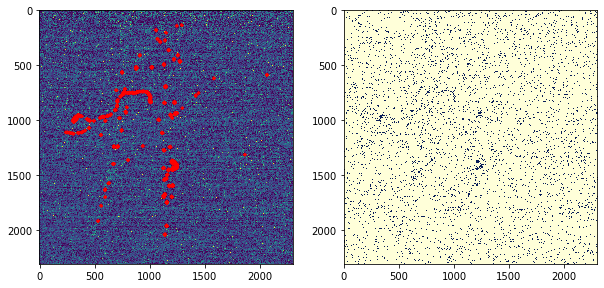

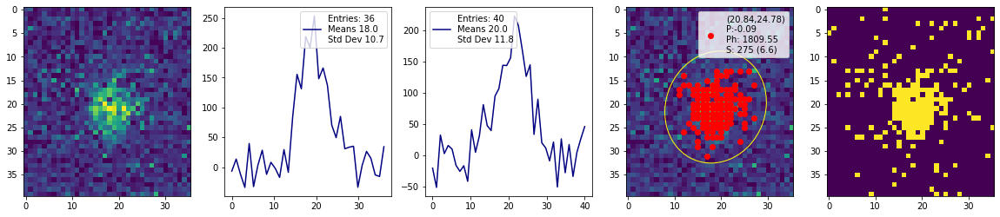

>>>> Processing RUN:  4041 Event:  11
>>>> Processing RUN:  4041 Event:  12
>>>> Processing RUN:  4041 Event:  13
>>>> Processing RUN:  4041 Event:  14
>>>> Processing RUN:  4041 Event:  15
>>>> Processing RUN:  4041 Event:  16
>>>> Processing RUN:  4041 Event:  17
>>>> Processing RUN:  4041 Event:  18
>>>> Processing RUN:  4041 Event:  19
>>>> Processing RUN:  4041 Event:  20
DEBUG: number of points, clusters: 328318 60
Elapsed time: 58.5
['iTr: 20.00', 'cluster_lable: 60.00', 'pixels: 288.00', 'photons: 1543.52', 'ph_pixels: 5.36', 'x0start: 1132.00', 'y0start: 2169.00', 'x0end: 1136.00', 'y0end: 2185.00', 'width: 24.56', 'height: 21.84', 'pearson: -0.01']


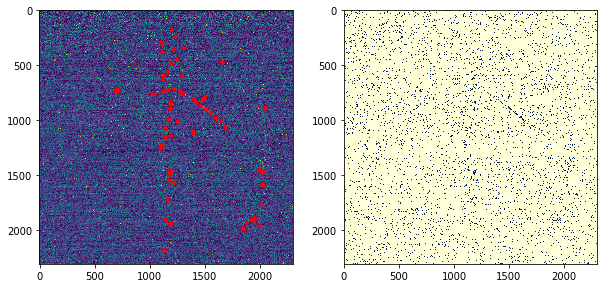

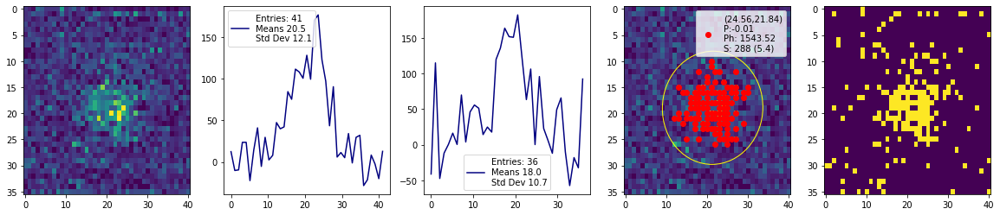

>>>> Processing RUN:  4041 Event:  21
>>>> Processing RUN:  4041 Event:  22
>>>> Processing RUN:  4041 Event:  23
>>>> Processing RUN:  4041 Event:  24
>>>> Processing RUN:  4041 Event:  25
>>>> Processing RUN:  4041 Event:  26
>>>> Processing RUN:  4041 Event:  27
>>>> Processing RUN:  4041 Event:  28
>>>> Processing RUN:  4041 Event:  29
>>>> Processing RUN:  4041 Event:  30
DEBUG: number of points, clusters: 346306 94
Elapsed time: 56.7
['iTr: 30.00', 'cluster_lable: 94.00', 'pixels: 265.00', 'photons: 1371.12', 'ph_pixels: 5.17', 'x0start: 1012.00', 'y0start: 2163.00', 'x0end: 1019.00', 'y0end: 2177.00', 'width: 21.80', 'height: 20.82', 'pearson: 0.07']


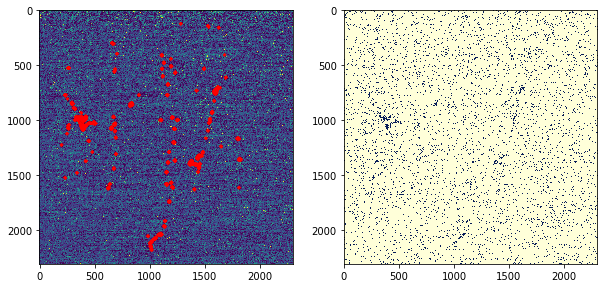

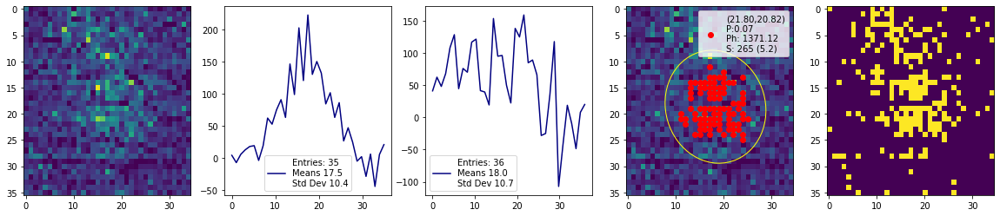

>>>> Processing RUN:  4041 Event:  31
>>>> Processing RUN:  4041 Event:  32
>>>> Processing RUN:  4041 Event:  33
>>>> Processing RUN:  4041 Event:  34
>>>> Processing RUN:  4041 Event:  35
>>>> Processing RUN:  4041 Event:  36
>>>> Processing RUN:  4041 Event:  37
>>>> Processing RUN:  4041 Event:  38
>>>> Processing RUN:  4041 Event:  39
>>>> Processing RUN:  4041 Event:  40


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


DEBUG: number of points, clusters: 368885 144
Elapsed time: 59.6
['iTr: 40.00', 'cluster_lable: 144.00', 'pixels: 417.00', 'photons: 2101.93', 'ph_pixels: 5.04', 'x0start: 1400.00', 'y0start: 2145.00', 'x0end: 1403.00', 'y0end: 2166.00', 'width: 29.11', 'height: 26.49', 'pearson: 0.17']


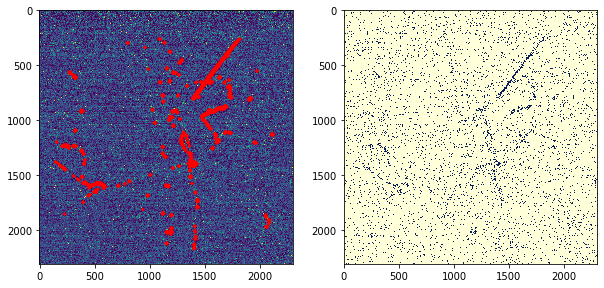

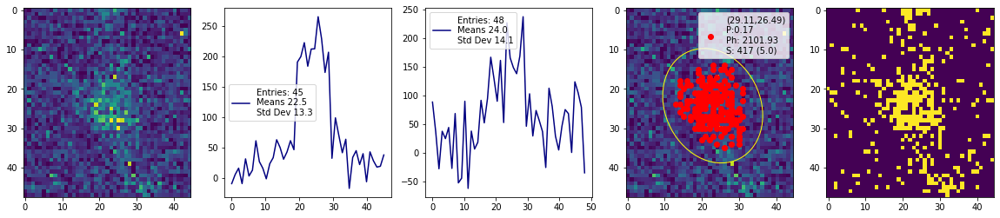

>>>> Processing RUN:  4041 Event:  41
>>>> Processing RUN:  4041 Event:  42
>>>> Processing RUN:  4041 Event:  43
>>>> Processing RUN:  4041 Event:  44
>>>> Processing RUN:  4041 Event:  45
>>>> Processing RUN:  4041 Event:  46
>>>> Processing RUN:  4041 Event:  47
>>>> Processing RUN:  4041 Event:  48
>>>> Processing RUN:  4041 Event:  49
>>>> Processing RUN:  4041 Event:  50
DEBUG: number of points, clusters: 344586 101
Elapsed time: 68.9
['iTr: 50.00', 'cluster_lable: 101.00', 'pixels: 336.00', 'photons: 2228.39', 'ph_pixels: 6.63', 'x0start: 1188.00', 'y0start: 1959.00', 'x0end: 1190.00', 'y0end: 1979.00', 'width: 24.23', 'height: 25.12', 'pearson: 0.07']


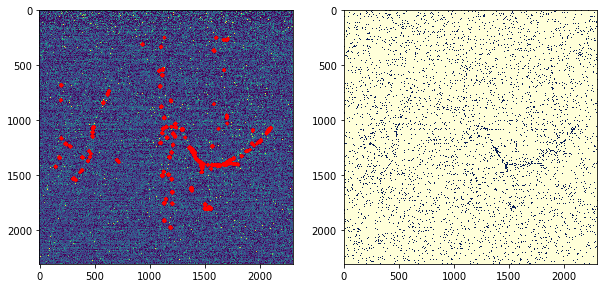

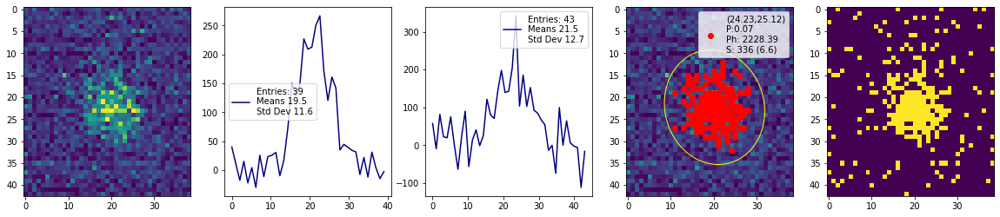

>>>> Processing RUN:  4041 Event:  51
>>>> Processing RUN:  4041 Event:  52
>>>> Processing RUN:  4041 Event:  53
>>>> Processing RUN:  4041 Event:  54
>>>> Processing RUN:  4041 Event:  55
>>>> Processing RUN:  4041 Event:  56
>>>> Processing RUN:  4041 Event:  57
>>>> Processing RUN:  4041 Event:  58
>>>> Processing RUN:  4041 Event:  59
>>>> Processing RUN:  4041 Event:  60
DEBUG: number of points, clusters: 341268 99
Elapsed time: 70.2
['iTr: 60.00', 'cluster_lable: 99.00', 'pixels: 295.00', 'photons: 1401.92', 'ph_pixels: 4.75', 'x0start: 1019.00', 'y0start: 2123.00', 'x0end: 1018.00', 'y0end: 2139.00', 'width: 25.96', 'height: 20.69', 'pearson: 0.03']


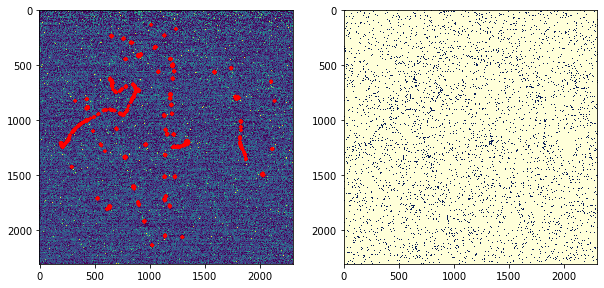

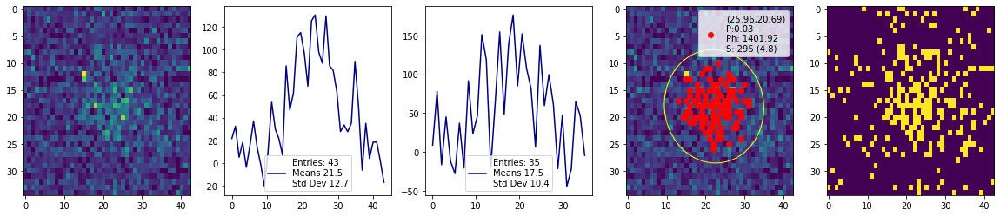

>>>> Processing RUN:  4041 Event:  61
>>>> Processing RUN:  4041 Event:  62
>>>> Processing RUN:  4041 Event:  63
>>>> Processing RUN:  4041 Event:  64
>>>> Processing RUN:  4041 Event:  65
>>>> Processing RUN:  4041 Event:  66
>>>> Processing RUN:  4041 Event:  67
>>>> Processing RUN:  4041 Event:  68
>>>> Processing RUN:  4041 Event:  69
>>>> Processing RUN:  4041 Event:  70
DEBUG: number of points, clusters: 328504 65
Elapsed time: 62.8
['iTr: 70.00', 'cluster_lable: 65.00', 'pixels: 259.00', 'photons: 1543.41', 'ph_pixels: 5.96', 'x0start: 1163.00', 'y0start: 2122.00', 'x0end: 1167.00', 'y0end: 2140.00', 'width: 22.26', 'height: 22.66', 'pearson: 0.14']


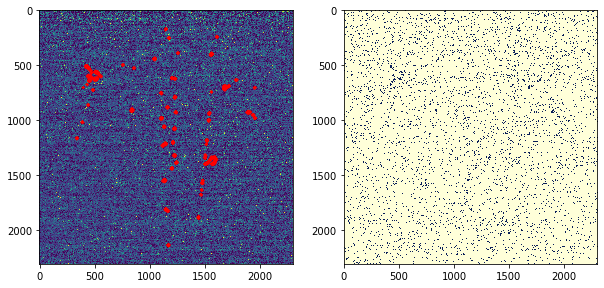

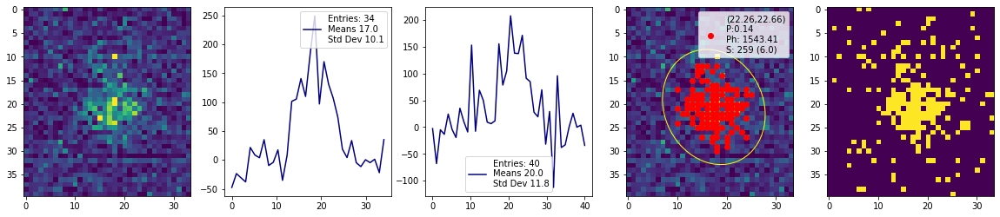

>>>> Processing RUN:  4041 Event:  71
>>>> Processing RUN:  4041 Event:  72
>>>> Processing RUN:  4041 Event:  73
>>>> Processing RUN:  4041 Event:  74
>>>> Processing RUN:  4041 Event:  75
>>>> Processing RUN:  4041 Event:  76
>>>> Processing RUN:  4041 Event:  77
>>>> Processing RUN:  4041 Event:  78
>>>> Processing RUN:  4041 Event:  79
>>>> Processing RUN:  4041 Event:  80
DEBUG: number of points, clusters: 338308 85
Elapsed time: 68.4
['iTr: 80.00', 'cluster_lable: 85.00', 'pixels: 208.00', 'photons: 900.16', 'ph_pixels: 4.33', 'x0start: 421.00', 'y0start: 2049.00', 'x0end: 421.00', 'y0end: 2063.00', 'width: 19.58', 'height: 18.25', 'pearson: 0.06']


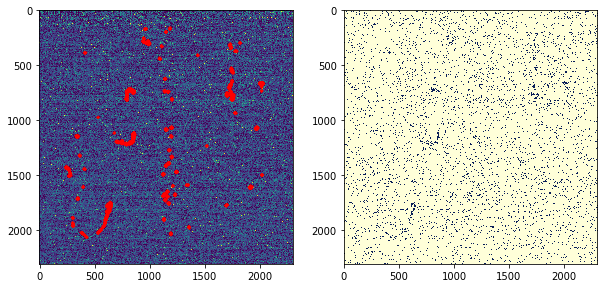

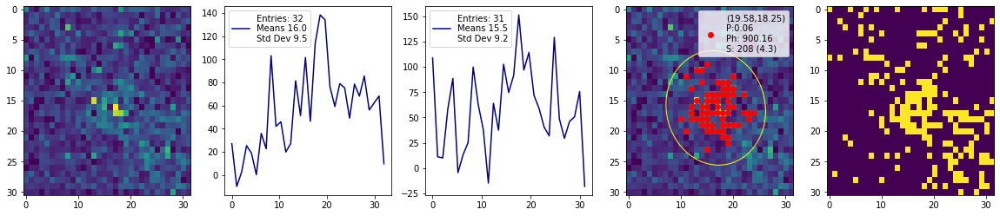

>>>> Processing RUN:  4041 Event:  81
>>>> Processing RUN:  4041 Event:  82
>>>> Processing RUN:  4041 Event:  83
>>>> Processing RUN:  4041 Event:  84
>>>> Processing RUN:  4041 Event:  85
>>>> Processing RUN:  4041 Event:  86
>>>> Processing RUN:  4041 Event:  87
>>>> Processing RUN:  4041 Event:  88
>>>> Processing RUN:  4041 Event:  89
>>>> Processing RUN:  4041 Event:  90
DEBUG: number of points, clusters: 335425 83
Elapsed time: 63.4
['iTr: 90.00', 'cluster_lable: 83.00', 'pixels: 300.00', 'photons: 1599.58', 'ph_pixels: 5.33', 'x0start: 1162.00', 'y0start: 2105.00', 'x0end: 1159.00', 'y0end: 2122.00', 'width: 26.65', 'height: 20.74', 'pearson: 0.04']


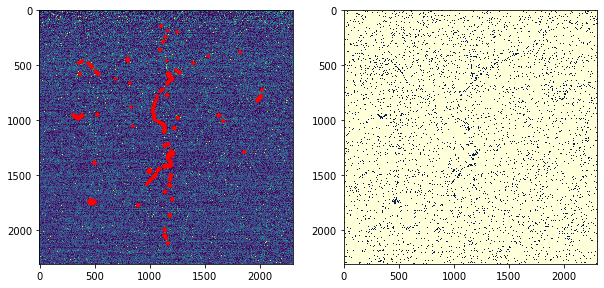

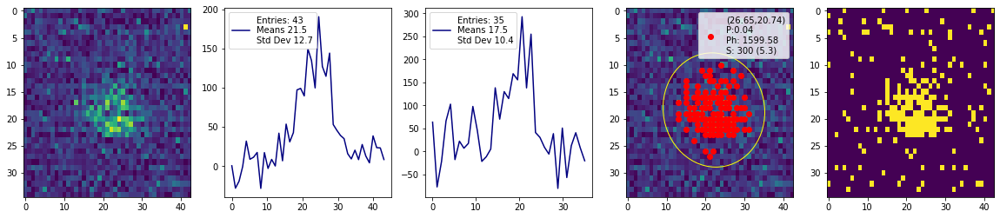

>>>> Processing RUN:  4041 Event:  91
>>>> Processing RUN:  4041 Event:  92
>>>> Processing RUN:  4041 Event:  93
>>>> Processing RUN:  4041 Event:  94
>>>> Processing RUN:  4041 Event:  95
>>>> Processing RUN:  4041 Event:  96
>>>> Processing RUN:  4041 Event:  97
>>>> Processing RUN:  4041 Event:  98
>>>> Processing RUN:  4041 Event:  99
>>>> Processing RUN:  4041 Event:  100
DEBUG: number of points, clusters: 346183 105
Elapsed time: 70.4
['iTr: 100.00', 'cluster_lable: 105.00', 'pixels: 395.00', 'photons: 2410.81', 'ph_pixels: 6.10', 'x0start: 1102.00', 'y0start: 2139.00', 'x0end: 1104.00', 'y0end: 2163.00', 'width: 22.45', 'height: 32.07', 'pearson: -0.02']


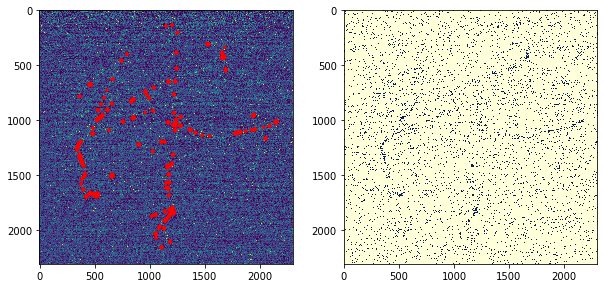

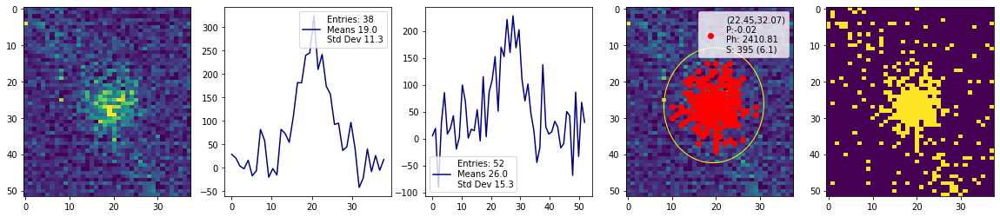

>>>> Processing RUN:  4041 Event:  101
>>>> Processing RUN:  4041 Event:  102
>>>> Processing RUN:  4041 Event:  103
>>>> Processing RUN:  4041 Event:  104
>>>> Processing RUN:  4041 Event:  105
>>>> Processing RUN:  4041 Event:  106
>>>> Processing RUN:  4041 Event:  107
>>>> Processing RUN:  4041 Event:  108
>>>> Processing RUN:  4041 Event:  109
>>>> Processing RUN:  4041 Event:  110
DEBUG: number of points, clusters: 345944 118
Elapsed time: 68.6
['iTr: 110.00', 'cluster_lable: 118.00', 'pixels: 352.00', 'photons: 2044.12', 'ph_pixels: 5.81', 'x0start: 1167.00', 'y0start: 2057.00', 'x0end: 1175.00', 'y0end: 2076.00', 'width: 24.49', 'height: 26.26', 'pearson: -0.01']


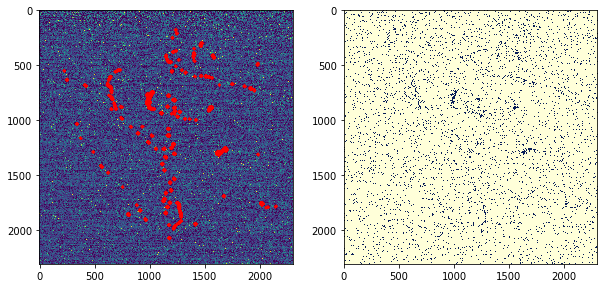

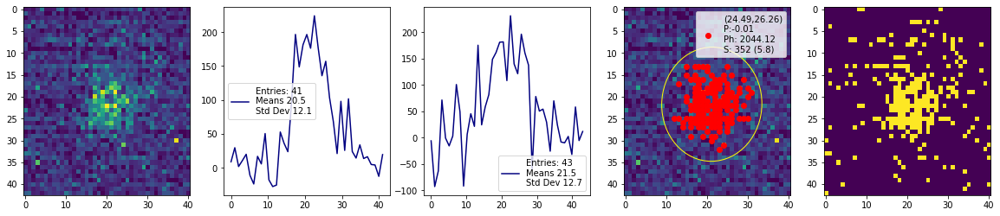

>>>> Processing RUN:  4041 Event:  111
>>>> Processing RUN:  4041 Event:  112
>>>> Processing RUN:  4041 Event:  113
>>>> Processing RUN:  4041 Event:  114
>>>> Processing RUN:  4041 Event:  115
>>>> Processing RUN:  4041 Event:  116
>>>> Processing RUN:  4041 Event:  117
>>>> Processing RUN:  4041 Event:  118
>>>> Processing RUN:  4041 Event:  119
>>>> Processing RUN:  4041 Event:  120
DEBUG: number of points, clusters: 326862 36
Elapsed time: 72.3
['iTr: 120.00', 'cluster_lable: 36.00', 'pixels: 375.00', 'photons: 2530.10', 'ph_pixels: 6.75', 'x0start: 1195.00', 'y0start: 1811.00', 'x0end: 1201.00', 'y0end: 1830.00', 'width: 28.22', 'height: 24.23', 'pearson: 0.15']


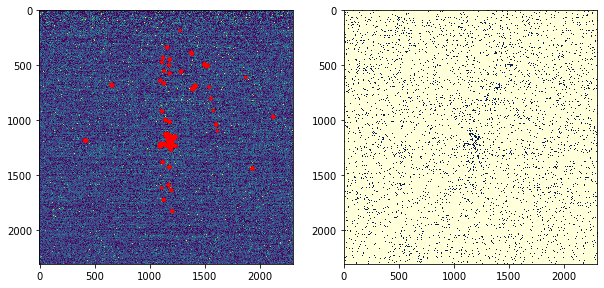

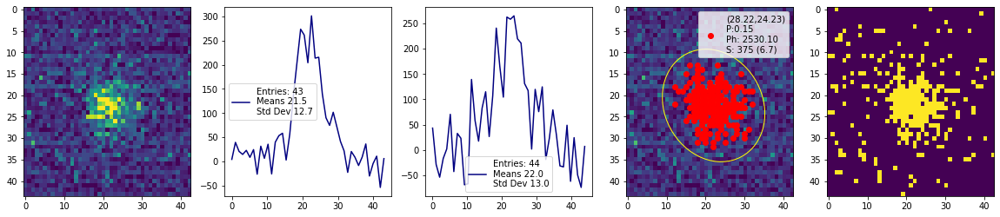

>>>> Processing RUN:  4041 Event:  121
>>>> Processing RUN:  4041 Event:  122
>>>> Processing RUN:  4041 Event:  123
>>>> Processing RUN:  4041 Event:  124
>>>> Processing RUN:  4041 Event:  125
>>>> Processing RUN:  4041 Event:  126
>>>> Processing RUN:  4041 Event:  127
>>>> Processing RUN:  4041 Event:  128
>>>> Processing RUN:  4041 Event:  129
>>>> Processing RUN:  4041 Event:  130
DEBUG: number of points, clusters: 326210 58
Elapsed time: 60.5
['iTr: 130.00', 'cluster_lable: 58.00', 'pixels: 153.00', 'photons: 682.72', 'ph_pixels: 4.46', 'x0start: 250.00', 'y0start: 1710.00', 'x0end: 249.00', 'y0end: 1722.00', 'width: 14.18', 'height: 19.83', 'pearson: -0.19']


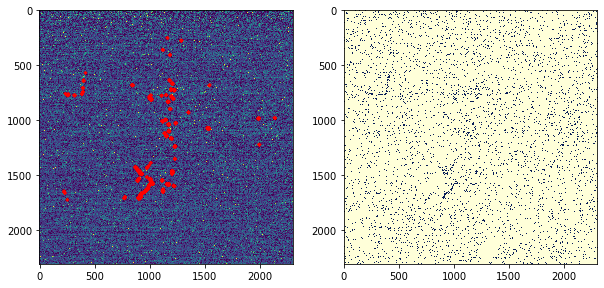

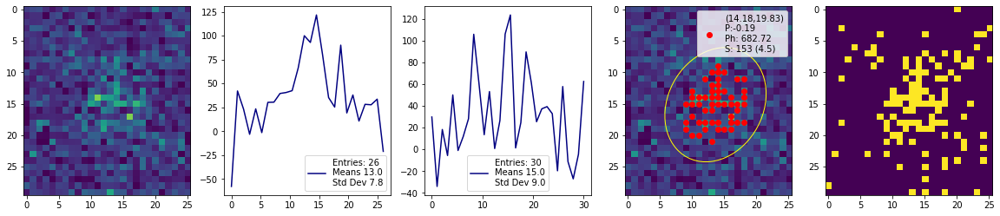

>>>> Processing RUN:  4041 Event:  131
>>>> Processing RUN:  4041 Event:  132
>>>> Processing RUN:  4041 Event:  133
>>>> Processing RUN:  4041 Event:  134
>>>> Processing RUN:  4041 Event:  135
>>>> Processing RUN:  4041 Event:  136
>>>> Processing RUN:  4041 Event:  137
>>>> Processing RUN:  4041 Event:  138
>>>> Processing RUN:  4041 Event:  139
>>>> Processing RUN:  4041 Event:  140
DEBUG: number of points, clusters: 340171 93
Elapsed time: 60.7
['iTr: 140.00', 'cluster_lable: 93.00', 'pixels: 155.00', 'photons: 819.17', 'ph_pixels: 5.29', 'x0start: 1449.00', 'y0start: 1944.00', 'x0end: 1450.00', 'y0end: 1956.00', 'width: 14.49', 'height: 18.27', 'pearson: -0.03']


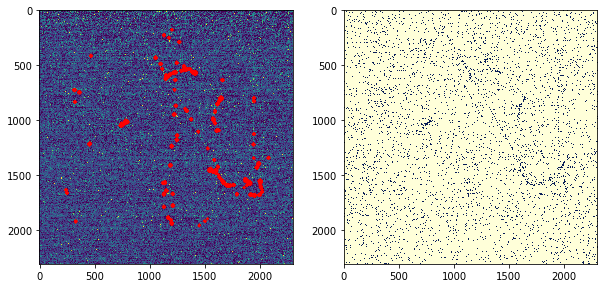

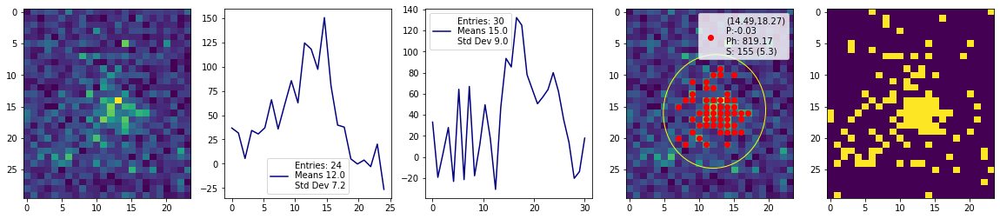

>>>> Processing RUN:  4041 Event:  141


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4041 Event:  142
>>>> Processing RUN:  4041 Event:  143
>>>> Processing RUN:  4041 Event:  144
>>>> Processing RUN:  4041 Event:  145
>>>> Processing RUN:  4041 Event:  146
>>>> Processing RUN:  4041 Event:  147
>>>> Processing RUN:  4041 Event:  148
>>>> Processing RUN:  4041 Event:  149
>>>> Processing RUN:  4041 Event:  150
DEBUG: number of points, clusters: 329472 67
Elapsed time: 60.2
['iTr: 150.00', 'cluster_lable: 67.00', 'pixels: 378.00', 'photons: 2279.37', 'ph_pixels: 6.03', 'x0start: 1160.00', 'y0start: 1872.00', 'x0end: 1167.00', 'y0end: 1891.00', 'width: 25.62', 'height: 27.59', 'pearson: 0.03']


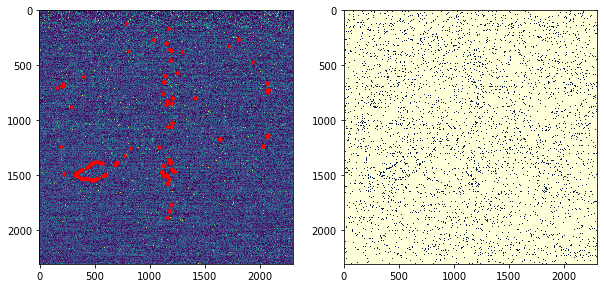

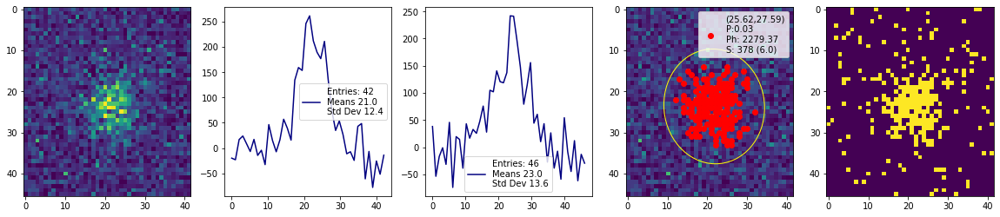

>>>> Processing RUN:  4041 Event:  151
>>>> Processing RUN:  4041 Event:  152
>>>> Processing RUN:  4041 Event:  153
>>>> Processing RUN:  4041 Event:  154
>>>> Processing RUN:  4041 Event:  155
>>>> Processing RUN:  4041 Event:  156
>>>> Processing RUN:  4041 Event:  157
>>>> Processing RUN:  4041 Event:  158
>>>> Processing RUN:  4041 Event:  159
>>>> Processing RUN:  4041 Event:  160
DEBUG: number of points, clusters: 351959 115
Elapsed time: 70.2
['iTr: 160.00', 'cluster_lable: 115.00', 'pixels: 429.00', 'photons: 2544.47', 'ph_pixels: 5.93', 'x0start: 1147.00', 'y0start: 1826.00', 'x0end: 1148.00', 'y0end: 1848.00', 'width: 25.23', 'height: 31.76', 'pearson: -0.04']


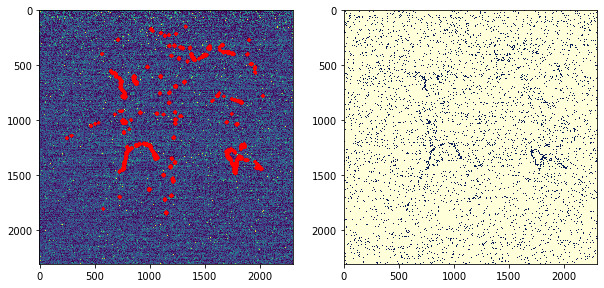

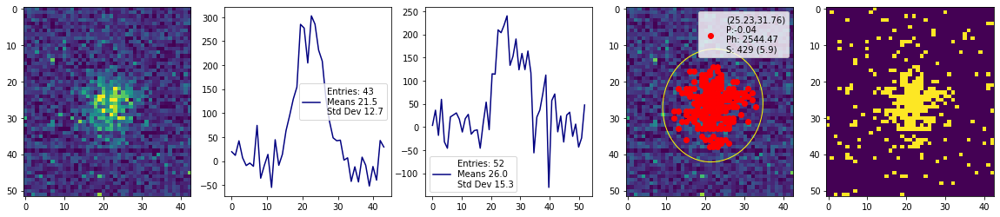

>>>> Processing RUN:  4041 Event:  161
>>>> Processing RUN:  4041 Event:  162
>>>> Processing RUN:  4041 Event:  163
>>>> Processing RUN:  4041 Event:  164
>>>> Processing RUN:  4041 Event:  165
>>>> Processing RUN:  4041 Event:  166
>>>> Processing RUN:  4041 Event:  167
>>>> Processing RUN:  4041 Event:  168
>>>> Processing RUN:  4041 Event:  169
>>>> Processing RUN:  4041 Event:  170
DEBUG: number of points, clusters: 335404 80
Elapsed time: 62.0
['iTr: 170.00', 'cluster_lable: 80.00', 'pixels: 345.00', 'photons: 1972.91', 'ph_pixels: 5.72', 'x0start: 1136.00', 'y0start: 2138.00', 'x0end: 1143.00', 'y0end: 2155.00', 'width: 26.62', 'height: 23.98', 'pearson: 0.03']


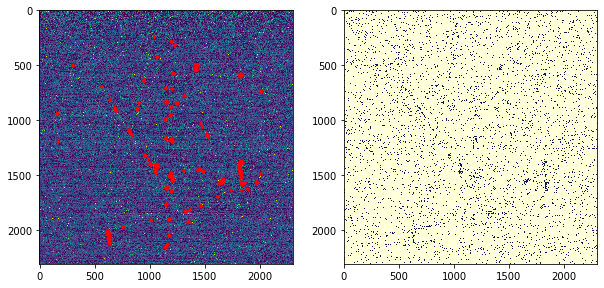

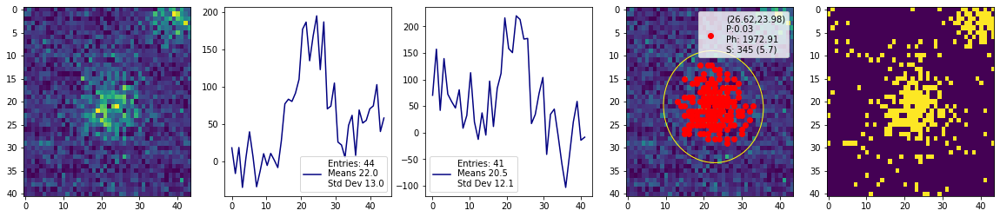

>>>> Processing RUN:  4041 Event:  171
>>>> Processing RUN:  4041 Event:  172
>>>> Processing RUN:  4041 Event:  173
>>>> Processing RUN:  4041 Event:  174
>>>> Processing RUN:  4041 Event:  175
>>>> Processing RUN:  4041 Event:  176
>>>> Processing RUN:  4041 Event:  177
>>>> Processing RUN:  4041 Event:  178
>>>> Processing RUN:  4041 Event:  179
>>>> Processing RUN:  4041 Event:  180
DEBUG: number of points, clusters: 333171 97
Elapsed time: 63.2
['iTr: 180.00', 'cluster_lable: 97.00', 'pixels: 312.00', 'photons: 1720.03', 'ph_pixels: 5.51', 'x0start: 1148.00', 'y0start: 2145.00', 'x0end: 1147.00', 'y0end: 2160.00', 'width: 24.83', 'height: 22.85', 'pearson: -0.12']


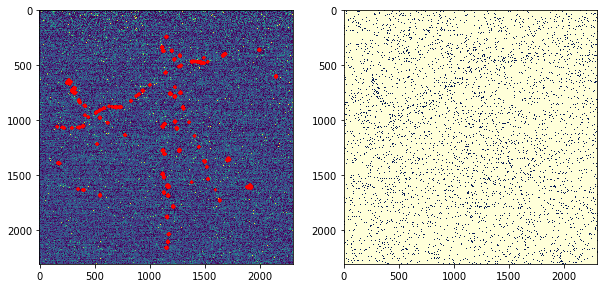

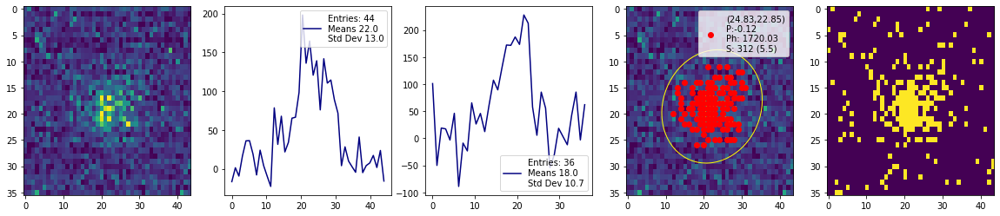

>>>> Processing RUN:  4041 Event:  181
>>>> Processing RUN:  4041 Event:  182
>>>> Processing RUN:  4041 Event:  183
>>>> Processing RUN:  4041 Event:  184
>>>> Processing RUN:  4041 Event:  185
>>>> Processing RUN:  4041 Event:  186
>>>> Processing RUN:  4041 Event:  187
>>>> Processing RUN:  4041 Event:  188
>>>> Processing RUN:  4041 Event:  189
>>>> Processing RUN:  4041 Event:  190
DEBUG: number of points, clusters: 341992 98
Elapsed time: 62.0
['iTr: 190.00', 'cluster_lable: 98.00', 'pixels: 156.00', 'photons: 705.75', 'ph_pixels: 4.52', 'x0start: 1201.00', 'y0start: 2162.00', 'x0end: 1198.00', 'y0end: 2174.00', 'width: 18.00', 'height: 16.84', 'pearson: -0.02']


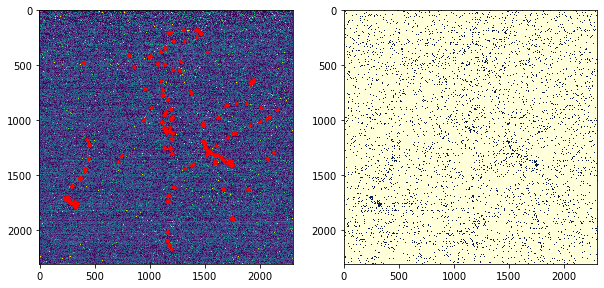

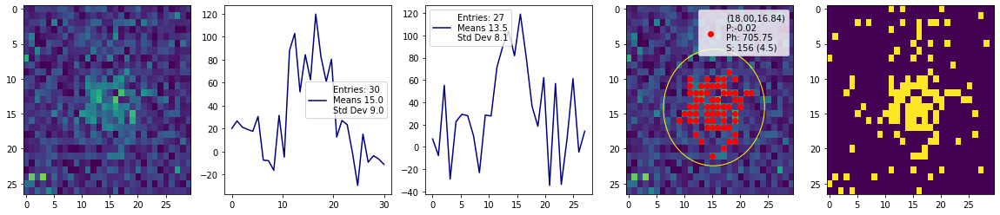

>>>> Processing RUN:  4041 Event:  191
>>>> Processing RUN:  4041 Event:  192
>>>> Processing RUN:  4041 Event:  193
>>>> Processing RUN:  4041 Event:  194
>>>> Processing RUN:  4041 Event:  195
>>>> Processing RUN:  4041 Event:  196
>>>> Processing RUN:  4041 Event:  197
>>>> Processing RUN:  4041 Event:  198
>>>> Processing RUN:  4041 Event:  199
out file /workarea/cloud-storage/mazzitel/out/dbscan_run4041_cmin_0_cmax_500_rescale_2304_nsigma_1.5_ev_200_ped_4038.plk.gz
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04042.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4042 Event:  0
DEBUG: number of points, clusters: 341370 104
Elapsed time: 65.8
['iTr: 0.00', 'cluster_lable: 104.00', 'pixels: 304.00', 'photons: 1543.06', 'ph_pixels: 5.08', 'x0start: 1102.00', 'y0start: 1989.00', 'x0end: 1105.00', 'y0end: 2008.00', 'width: 31.61', 'height: 17.73', 'pearson: 0.56']


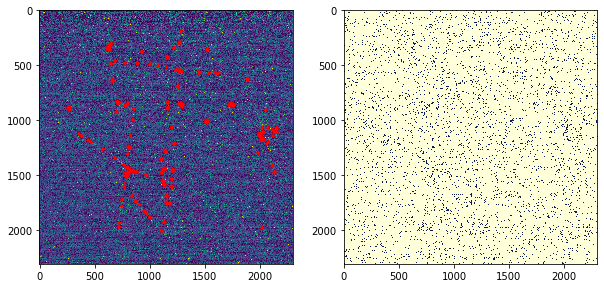

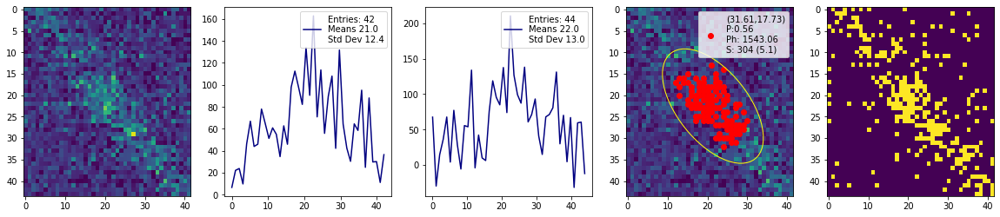

>>>> Processing RUN:  4042 Event:  1
>>>> Processing RUN:  4042 Event:  2
>>>> Processing RUN:  4042 Event:  3
>>>> Processing RUN:  4042 Event:  4
>>>> Processing RUN:  4042 Event:  5
>>>> Processing RUN:  4042 Event:  6
>>>> Processing RUN:  4042 Event:  7
>>>> Processing RUN:  4042 Event:  8
>>>> Processing RUN:  4042 Event:  9
>>>> Processing RUN:  4042 Event:  10
DEBUG: number of points, clusters: 344195 114
Elapsed time: 63.1
['iTr: 10.00', 'cluster_lable: 114.00', 'pixels: 255.00', 'photons: 1547.24', 'ph_pixels: 6.07', 'x0start: 1144.00', 'y0start: 1976.00', 'x0end: 1147.00', 'y0end: 1993.00', 'width: 18.82', 'height: 24.43', 'pearson: -0.10']


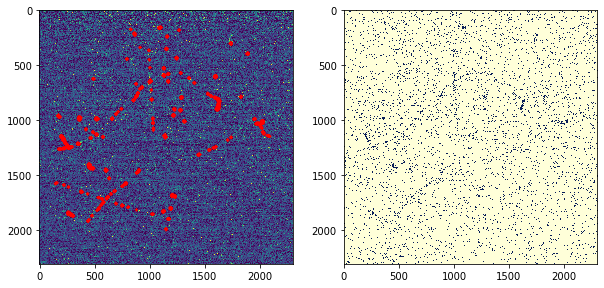

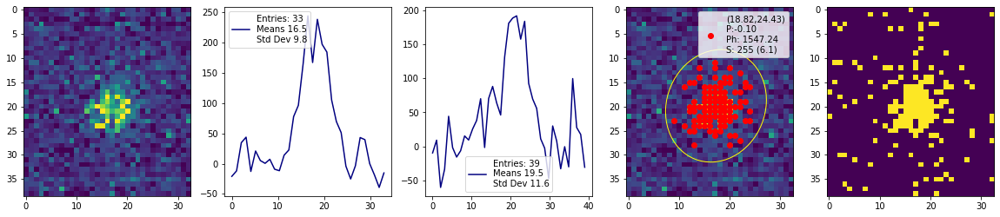

>>>> Processing RUN:  4042 Event:  11
>>>> Processing RUN:  4042 Event:  12
>>>> Processing RUN:  4042 Event:  13
>>>> Processing RUN:  4042 Event:  14
>>>> Processing RUN:  4042 Event:  15
>>>> Processing RUN:  4042 Event:  16
>>>> Processing RUN:  4042 Event:  17
>>>> Processing RUN:  4042 Event:  18
>>>> Processing RUN:  4042 Event:  19
>>>> Processing RUN:  4042 Event:  20
DEBUG: number of points, clusters: 354072 106
Elapsed time: 65.2
['iTr: 20.00', 'cluster_lable: 106.00', 'pixels: 343.00', 'photons: 1985.90', 'ph_pixels: 5.79', 'x0start: 1138.00', 'y0start: 2067.00', 'x0end: 1137.00', 'y0end: 2086.00', 'width: 24.13', 'height: 26.53', 'pearson: -0.02']


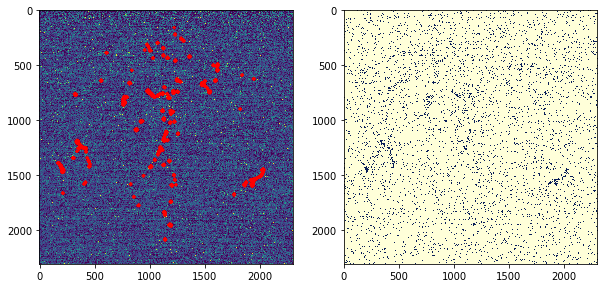

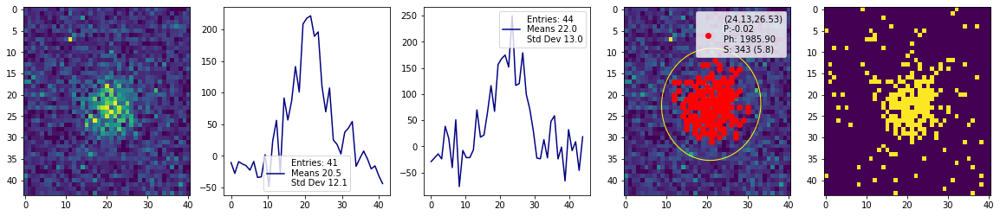

>>>> Processing RUN:  4042 Event:  21
>>>> Processing RUN:  4042 Event:  22
>>>> Processing RUN:  4042 Event:  23
>>>> Processing RUN:  4042 Event:  24


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4042 Event:  25
>>>> Processing RUN:  4042 Event:  26
>>>> Processing RUN:  4042 Event:  27
>>>> Processing RUN:  4042 Event:  28
>>>> Processing RUN:  4042 Event:  29
>>>> Processing RUN:  4042 Event:  30


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


DEBUG: number of points, clusters: 365378 151
Elapsed time: 65.2
['iTr: 30.00', 'cluster_lable: 151.00', 'pixels: 313.00', 'photons: 1464.02', 'ph_pixels: 4.68', 'x0start: 1132.00', 'y0start: 2164.00', 'x0end: 1139.00', 'y0end: 2179.00', 'width: 25.90', 'height: 23.46', 'pearson: 0.00']


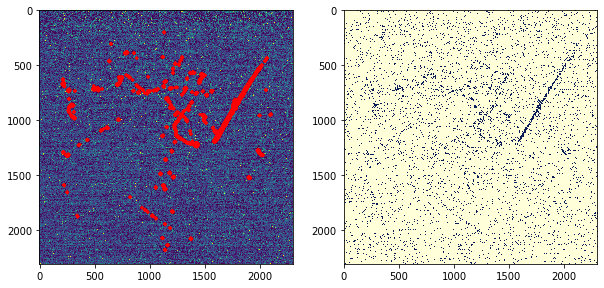

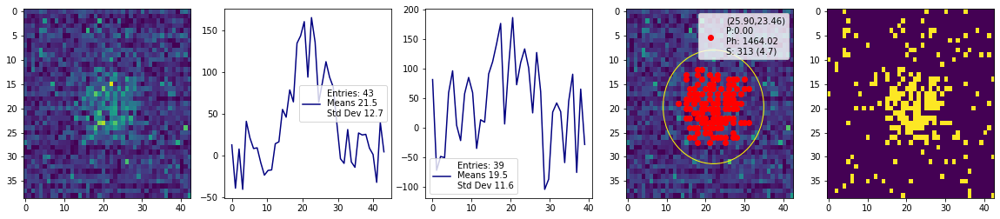

>>>> Processing RUN:  4042 Event:  31
>>>> Processing RUN:  4042 Event:  32
>>>> Processing RUN:  4042 Event:  33
>>>> Processing RUN:  4042 Event:  34
>>>> Processing RUN:  4042 Event:  35
>>>> Processing RUN:  4042 Event:  36
>>>> Processing RUN:  4042 Event:  37
>>>> Processing RUN:  4042 Event:  38
>>>> Processing RUN:  4042 Event:  39
>>>> Processing RUN:  4042 Event:  40
DEBUG: number of points, clusters: 365235 169
Elapsed time: 78.6
['iTr: 40.00', 'cluster_lable: 169.00', 'pixels: 631.00', 'photons: 4120.67', 'ph_pixels: 6.53', 'x0start: 1110.00', 'y0start: 2058.00', 'x0end: 1105.00', 'y0end: 2087.00', 'width: 25.21', 'height: 44.83', 'pearson: -0.29']


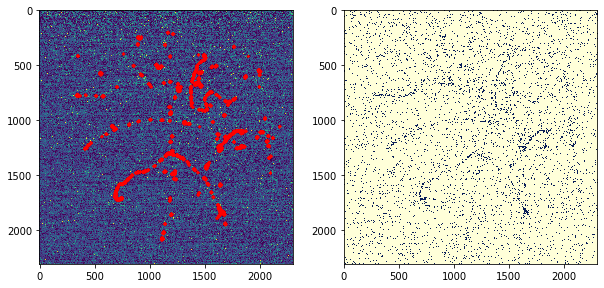

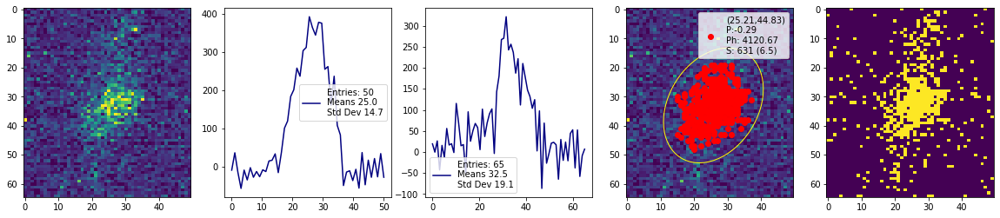

>>>> Processing RUN:  4042 Event:  41
>>>> Processing RUN:  4042 Event:  42
>>>> Processing RUN:  4042 Event:  43
>>>> Processing RUN:  4042 Event:  44
>>>> Processing RUN:  4042 Event:  45
>>>> Processing RUN:  4042 Event:  46
>>>> Processing RUN:  4042 Event:  47
>>>> Processing RUN:  4042 Event:  48
>>>> Processing RUN:  4042 Event:  49
>>>> Processing RUN:  4042 Event:  50
DEBUG: number of points, clusters: 342138 70
Elapsed time: 59.9
['iTr: 50.00', 'cluster_lable: 70.00', 'pixels: 347.00', 'photons: 2003.37', 'ph_pixels: 5.77', 'x0start: 1159.00', 'y0start: 2079.00', 'x0end: 1166.00', 'y0end: 2097.00', 'width: 25.61', 'height: 23.58', 'pearson: 0.18']


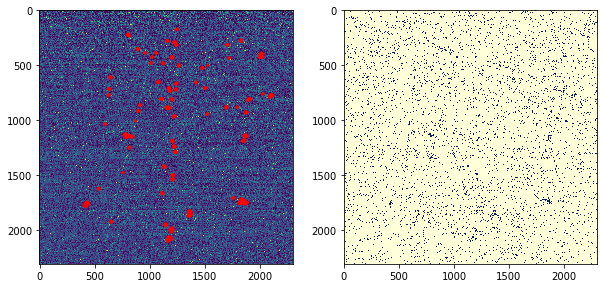

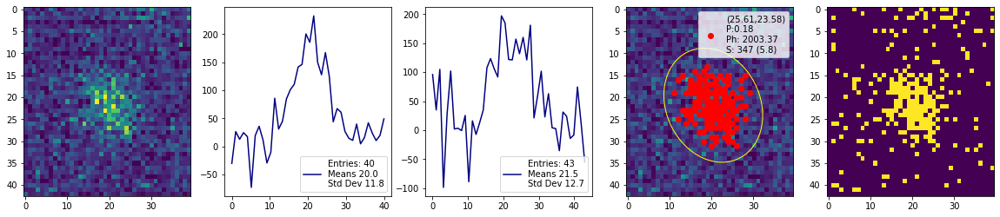

>>>> Processing RUN:  4042 Event:  51
>>>> Processing RUN:  4042 Event:  52
>>>> Processing RUN:  4042 Event:  53
>>>> Processing RUN:  4042 Event:  54
>>>> Processing RUN:  4042 Event:  55


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4042 Event:  56
>>>> Processing RUN:  4042 Event:  57
>>>> Processing RUN:  4042 Event:  58
>>>> Processing RUN:  4042 Event:  59
>>>> Processing RUN:  4042 Event:  60
DEBUG: number of points, clusters: 359691 154
Elapsed time: 67.8
['iTr: 60.00', 'cluster_lable: 154.00', 'pixels: 140.00', 'photons: 758.96', 'ph_pixels: 5.42', 'x0start: 1223.00', 'y0start: 2127.00', 'x0end: 1224.00', 'y0end: 2136.00', 'width: 16.59', 'height: 14.49', 'pearson: 0.11']


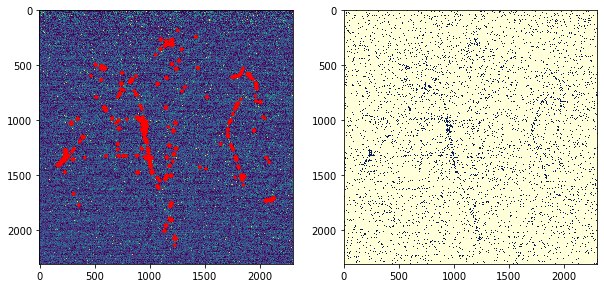

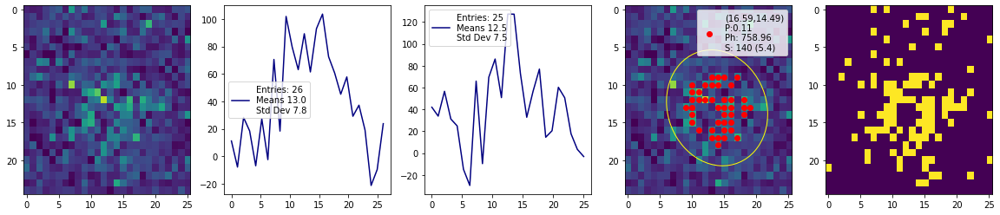

>>>> Processing RUN:  4042 Event:  61
>>>> Processing RUN:  4042 Event:  62
>>>> Processing RUN:  4042 Event:  63
>>>> Processing RUN:  4042 Event:  64
>>>> Processing RUN:  4042 Event:  65
>>>> Processing RUN:  4042 Event:  66
>>>> Processing RUN:  4042 Event:  67
>>>> Processing RUN:  4042 Event:  68
>>>> Processing RUN:  4042 Event:  69
>>>> Processing RUN:  4042 Event:  70
DEBUG: number of points, clusters: 359441 131
Elapsed time: 68.0
['iTr: 70.00', 'cluster_lable: 131.00', 'pixels: 364.00', 'photons: 2012.37', 'ph_pixels: 5.53', 'x0start: 1127.00', 'y0start: 2153.00', 'x0end: 1129.00', 'y0end: 2173.00', 'width: 27.27', 'height: 25.10', 'pearson: 0.09']


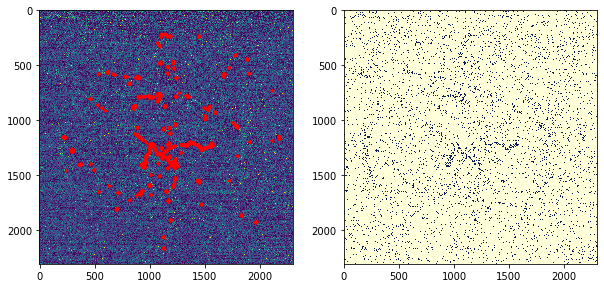

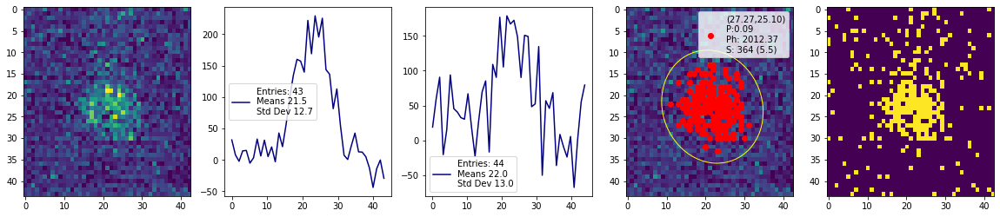

>>>> Processing RUN:  4042 Event:  71
>>>> Processing RUN:  4042 Event:  72
>>>> Processing RUN:  4042 Event:  73
>>>> Processing RUN:  4042 Event:  74
>>>> Processing RUN:  4042 Event:  75
>>>> Processing RUN:  4042 Event:  76
>>>> Processing RUN:  4042 Event:  77
>>>> Processing RUN:  4042 Event:  78
>>>> Processing RUN:  4042 Event:  79
>>>> Processing RUN:  4042 Event:  80
DEBUG: number of points, clusters: 340573 86
Elapsed time: 60.4
['iTr: 80.00', 'cluster_lable: 86.00', 'pixels: 441.00', 'photons: 2727.24', 'ph_pixels: 6.18', 'x0start: 1159.00', 'y0start: 1930.00', 'x0end: 1166.00', 'y0end: 1952.00', 'width: 26.93', 'height: 30.83', 'pearson: 0.01']


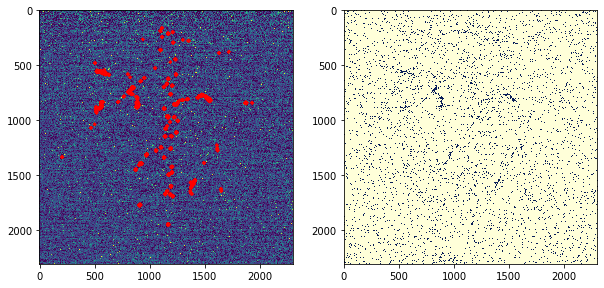

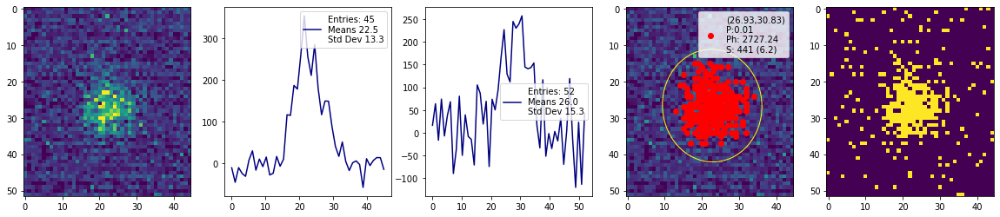

>>>> Processing RUN:  4042 Event:  81
>>>> Processing RUN:  4042 Event:  82
>>>> Processing RUN:  4042 Event:  83
>>>> Processing RUN:  4042 Event:  84
>>>> Processing RUN:  4042 Event:  85
>>>> Processing RUN:  4042 Event:  86
>>>> Processing RUN:  4042 Event:  87
>>>> Processing RUN:  4042 Event:  88
>>>> Processing RUN:  4042 Event:  89
>>>> Processing RUN:  4042 Event:  90
DEBUG: number of points, clusters: 350310 123
Elapsed time: 70.6
['iTr: 90.00', 'cluster_lable: 123.00', 'pixels: 338.00', 'photons: 1725.72', 'ph_pixels: 5.11', 'x0start: 2050.00', 'y0start: 1974.00', 'x0end: 2052.00', 'y0end: 1991.00', 'width: 22.16', 'height: 25.49', 'pearson: -0.05']


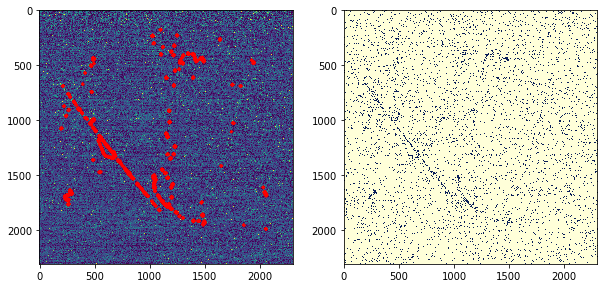

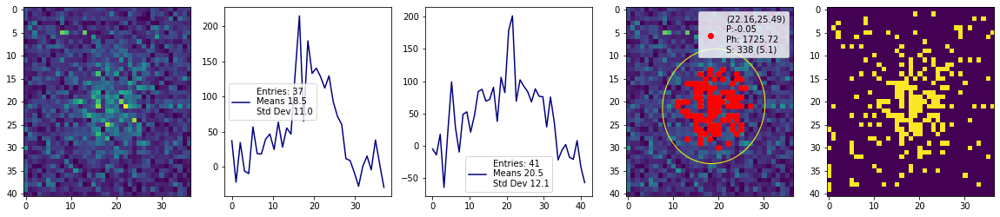

>>>> Processing RUN:  4042 Event:  91
>>>> Processing RUN:  4042 Event:  92
>>>> Processing RUN:  4042 Event:  93
>>>> Processing RUN:  4042 Event:  94
>>>> Processing RUN:  4042 Event:  95
>>>> Processing RUN:  4042 Event:  96
>>>> Processing RUN:  4042 Event:  97
>>>> Processing RUN:  4042 Event:  98
>>>> Processing RUN:  4042 Event:  99
>>>> Processing RUN:  4042 Event:  100
DEBUG: number of points, clusters: 347006 112
Elapsed time: 61.8
['iTr: 100.00', 'cluster_lable: 112.00', 'pixels: 395.00', 'photons: 2085.47', 'ph_pixels: 5.28', 'x0start: 1184.00', 'y0start: 2008.00', 'x0end: 1190.00', 'y0end: 2030.00', 'width: 24.43', 'height: 30.31', 'pearson: 0.09']


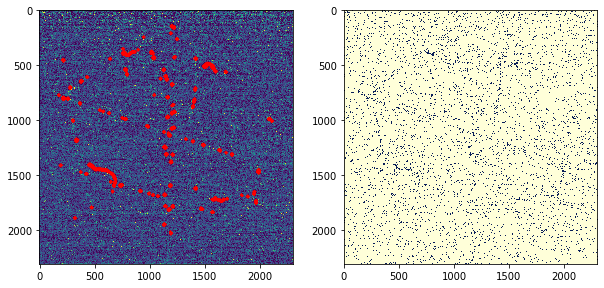

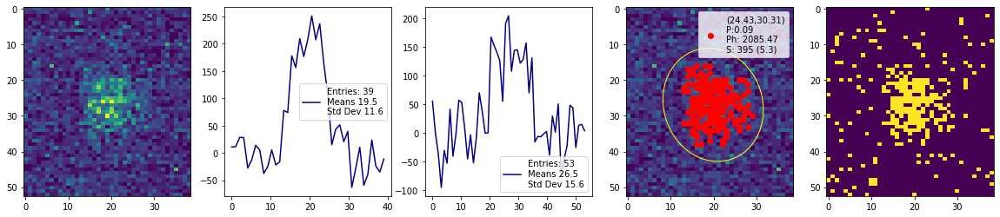

>>>> Processing RUN:  4042 Event:  101
>>>> Processing RUN:  4042 Event:  102
>>>> Processing RUN:  4042 Event:  103
>>>> Processing RUN:  4042 Event:  104
>>>> Processing RUN:  4042 Event:  105
>>>> Processing RUN:  4042 Event:  106
>>>> Processing RUN:  4042 Event:  107
>>>> Processing RUN:  4042 Event:  108
>>>> Processing RUN:  4042 Event:  109
>>>> Processing RUN:  4042 Event:  110
DEBUG: number of points, clusters: 335907 89
Elapsed time: 61.2
['iTr: 110.00', 'cluster_lable: 89.00', 'pixels: 294.00', 'photons: 1516.22', 'ph_pixels: 5.16', 'x0start: 1175.00', 'y0start: 2160.00', 'x0end: 1178.00', 'y0end: 2176.00', 'width: 19.13', 'height: 27.73', 'pearson: -0.30']


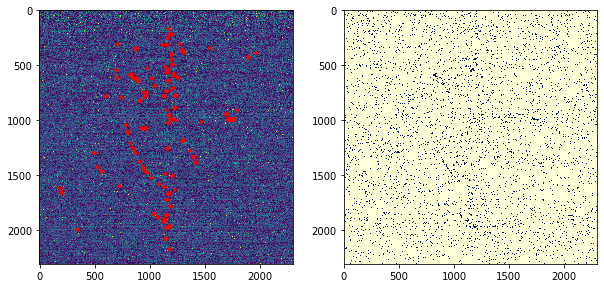

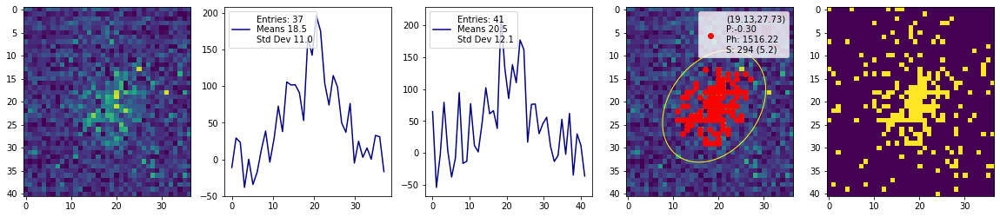

>>>> Processing RUN:  4042 Event:  111
>>>> Processing RUN:  4042 Event:  112
>>>> Processing RUN:  4042 Event:  113
>>>> Processing RUN:  4042 Event:  114
>>>> Processing RUN:  4042 Event:  115
>>>> Processing RUN:  4042 Event:  116
>>>> Processing RUN:  4042 Event:  117
>>>> Processing RUN:  4042 Event:  118
>>>> Processing RUN:  4042 Event:  119
>>>> Processing RUN:  4042 Event:  120
DEBUG: number of points, clusters: 357113 127
Elapsed time: 63.0
['iTr: 120.00', 'cluster_lable: 127.00', 'pixels: 298.00', 'photons: 1607.89', 'ph_pixels: 5.40', 'x0start: 1161.00', 'y0start: 2170.00', 'x0end: 1163.00', 'y0end: 2186.00', 'width: 23.30', 'height: 23.26', 'pearson: 0.01']


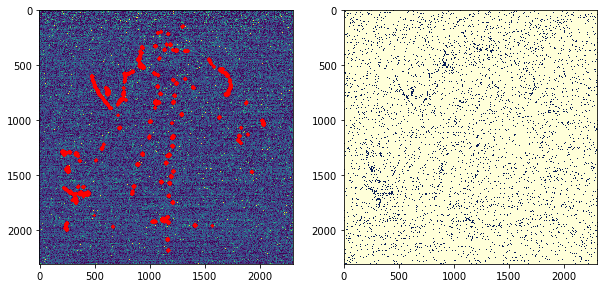

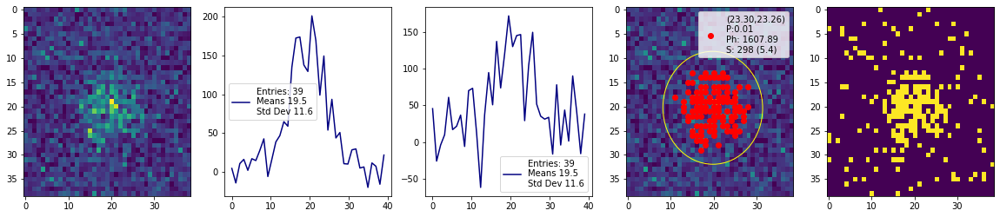

>>>> Processing RUN:  4042 Event:  121
>>>> Processing RUN:  4042 Event:  122
>>>> Processing RUN:  4042 Event:  123
>>>> Processing RUN:  4042 Event:  124
>>>> Processing RUN:  4042 Event:  125
>>>> Processing RUN:  4042 Event:  126
>>>> Processing RUN:  4042 Event:  127
>>>> Processing RUN:  4042 Event:  128
>>>> Processing RUN:  4042 Event:  129
>>>> Processing RUN:  4042 Event:  130
DEBUG: number of points, clusters: 332364 59
Elapsed time: 68.2
['iTr: 130.00', 'cluster_lable: 59.00', 'pixels: 372.00', 'photons: 2106.96', 'ph_pixels: 5.66', 'x0start: 1167.00', 'y0start: 2103.00', 'x0end: 1176.00', 'y0end: 2121.00', 'width: 29.34', 'height: 23.89', 'pearson: 0.07']


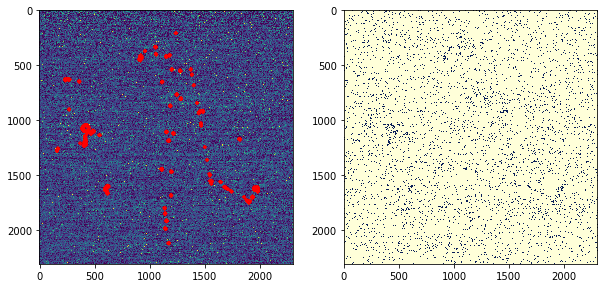

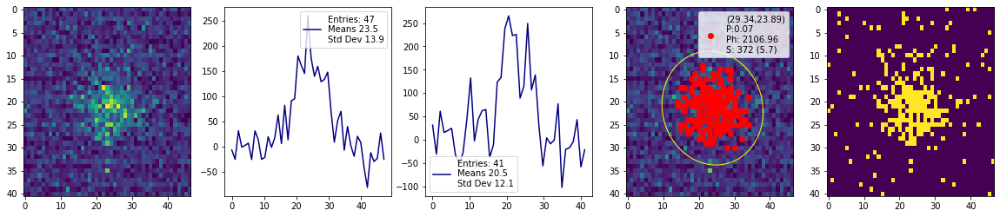

>>>> Processing RUN:  4042 Event:  131
>>>> Processing RUN:  4042 Event:  132
>>>> Processing RUN:  4042 Event:  133
>>>> Processing RUN:  4042 Event:  134
>>>> Processing RUN:  4042 Event:  135
>>>> Processing RUN:  4042 Event:  136
>>>> Processing RUN:  4042 Event:  137
>>>> Processing RUN:  4042 Event:  138
>>>> Processing RUN:  4042 Event:  139
>>>> Processing RUN:  4042 Event:  140
DEBUG: number of points, clusters: 365866 160
Elapsed time: 65.5
['iTr: 140.00', 'cluster_lable: 160.00', 'pixels: 342.00', 'photons: 1948.10', 'ph_pixels: 5.70', 'x0start: 1170.00', 'y0start: 2132.00', 'x0end: 1174.00', 'y0end: 2152.00', 'width: 21.93', 'height: 29.90', 'pearson: -0.08']


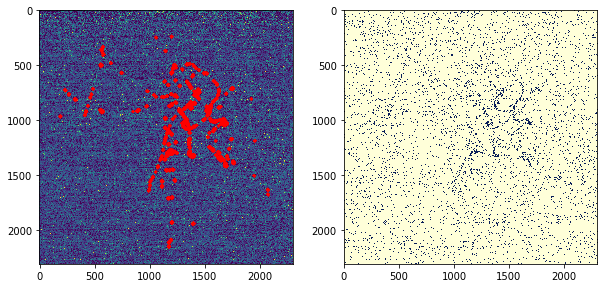

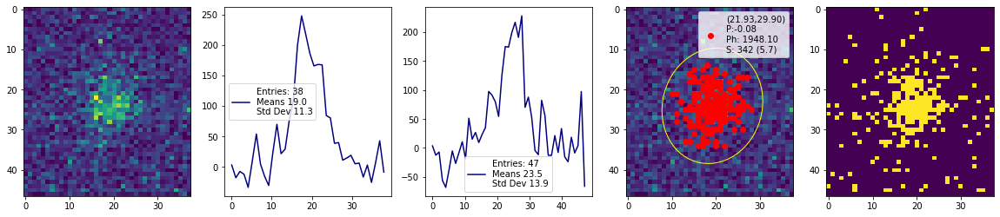

>>>> Processing RUN:  4042 Event:  141
>>>> Processing RUN:  4042 Event:  142
>>>> Processing RUN:  4042 Event:  143
>>>> Processing RUN:  4042 Event:  144
>>>> Processing RUN:  4042 Event:  145
>>>> Processing RUN:  4042 Event:  146
>>>> Processing RUN:  4042 Event:  147
>>>> Processing RUN:  4042 Event:  148
>>>> Processing RUN:  4042 Event:  149
>>>> Processing RUN:  4042 Event:  150
DEBUG: number of points, clusters: 359237 136
Elapsed time: 64.2
['iTr: 150.00', 'cluster_lable: 136.00', 'pixels: 423.00', 'photons: 2337.93', 'ph_pixels: 5.53', 'x0start: 1128.00', 'y0start: 2000.00', 'x0end: 1126.00', 'y0end: 2021.00', 'width: 26.87', 'height: 29.02', 'pearson: -0.02']


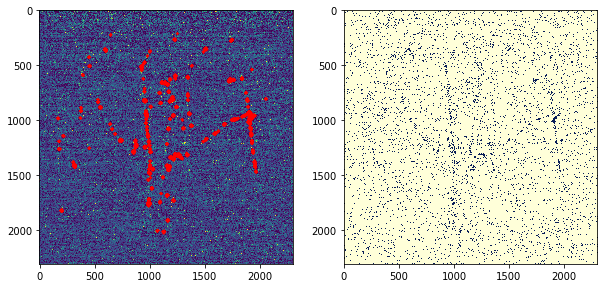

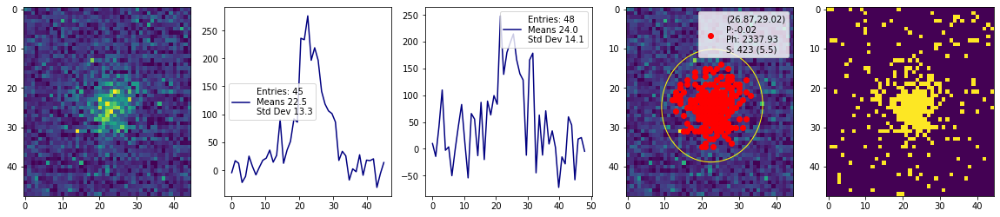

>>>> Processing RUN:  4042 Event:  151
>>>> Processing RUN:  4042 Event:  152
>>>> Processing RUN:  4042 Event:  153
>>>> Processing RUN:  4042 Event:  154
>>>> Processing RUN:  4042 Event:  155
>>>> Processing RUN:  4042 Event:  156
>>>> Processing RUN:  4042 Event:  157
>>>> Processing RUN:  4042 Event:  158
>>>> Processing RUN:  4042 Event:  159
>>>> Processing RUN:  4042 Event:  160
DEBUG: number of points, clusters: 341652 82
Elapsed time: 66.2
['iTr: 160.00', 'cluster_lable: 82.00', 'pixels: 380.00', 'photons: 2120.03', 'ph_pixels: 5.58', 'x0start: 1145.00', 'y0start: 2152.00', 'x0end: 1152.00', 'y0end: 2172.00', 'width: 27.64', 'height: 25.83', 'pearson: 0.06']


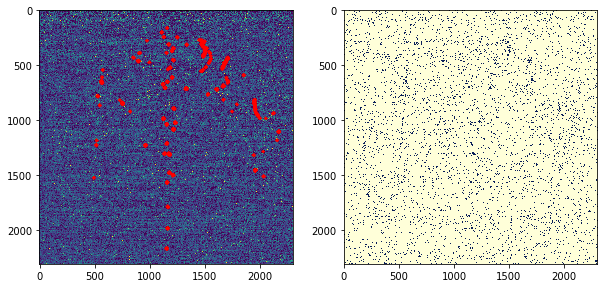

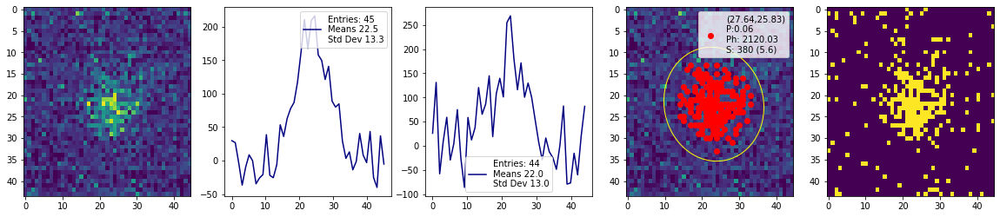

>>>> Processing RUN:  4042 Event:  161
>>>> Processing RUN:  4042 Event:  162
>>>> Processing RUN:  4042 Event:  163
>>>> Processing RUN:  4042 Event:  164
>>>> Processing RUN:  4042 Event:  165
>>>> Processing RUN:  4042 Event:  166
>>>> Processing RUN:  4042 Event:  167
>>>> Processing RUN:  4042 Event:  168
>>>> Processing RUN:  4042 Event:  169
>>>> Processing RUN:  4042 Event:  170
DEBUG: number of points, clusters: 350055 118
Elapsed time: 60.3
['iTr: 170.00', 'cluster_lable: 118.00', 'pixels: 384.00', 'photons: 1749.49', 'ph_pixels: 4.56', 'x0start: 506.00', 'y0start: 2040.00', 'x0end: 503.00', 'y0end: 2059.00', 'width: 22.60', 'height: 29.19', 'pearson: -0.25']


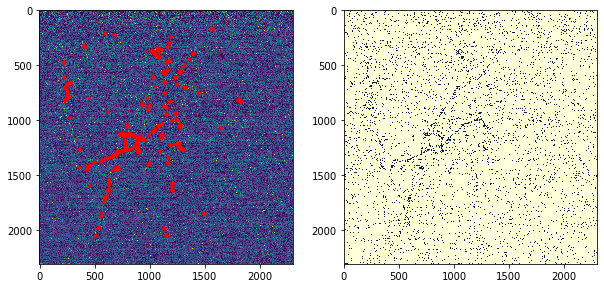

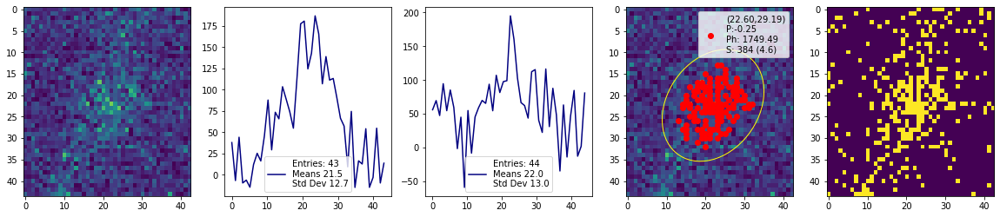

>>>> Processing RUN:  4042 Event:  171
>>>> Processing RUN:  4042 Event:  172
>>>> Processing RUN:  4042 Event:  173
>>>> Processing RUN:  4042 Event:  174
>>>> Processing RUN:  4042 Event:  175
>>>> Processing RUN:  4042 Event:  176
>>>> Processing RUN:  4042 Event:  177
>>>> Processing RUN:  4042 Event:  178
>>>> Processing RUN:  4042 Event:  179
>>>> Processing RUN:  4042 Event:  180
DEBUG: number of points, clusters: 354626 94
Elapsed time: 63.9
['iTr: 180.00', 'cluster_lable: 94.00', 'pixels: 354.00', 'photons: 2120.55', 'ph_pixels: 5.99', 'x0start: 1190.00', 'y0start: 2042.00', 'x0end: 1193.00', 'y0end: 2063.00', 'width: 22.88', 'height: 28.63', 'pearson: -0.02']


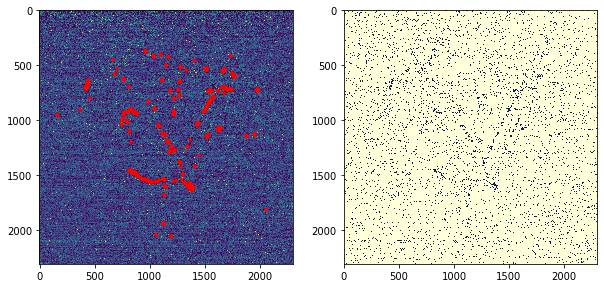

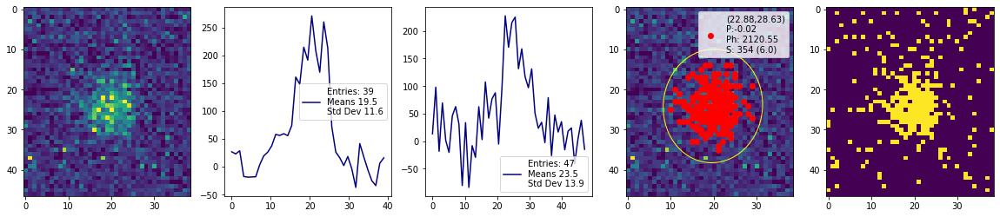

>>>> Processing RUN:  4042 Event:  181
>>>> Processing RUN:  4042 Event:  182
>>>> Processing RUN:  4042 Event:  183
>>>> Processing RUN:  4042 Event:  184
>>>> Processing RUN:  4042 Event:  185
>>>> Processing RUN:  4042 Event:  186
>>>> Processing RUN:  4042 Event:  187
>>>> Processing RUN:  4042 Event:  188
>>>> Processing RUN:  4042 Event:  189
>>>> Processing RUN:  4042 Event:  190
DEBUG: number of points, clusters: 335616 85
Elapsed time: 66.1
['iTr: 190.00', 'cluster_lable: 85.00', 'pixels: 325.00', 'photons: 2052.39', 'ph_pixels: 6.32', 'x0start: 1131.00', 'y0start: 2001.00', 'x0end: 1125.00', 'y0end: 2020.00', 'width: 22.95', 'height: 23.86', 'pearson: 0.07']


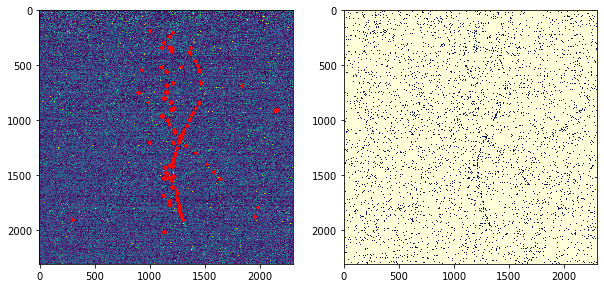

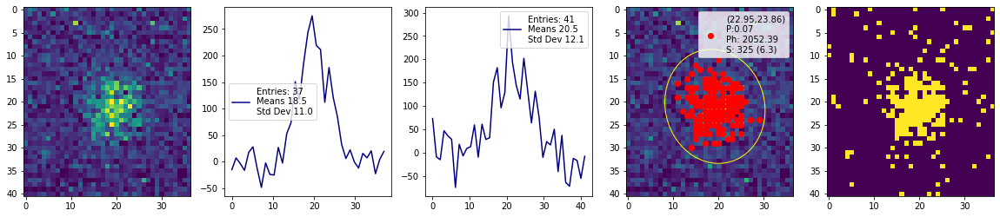

>>>> Processing RUN:  4042 Event:  191
>>>> Processing RUN:  4042 Event:  192
>>>> Processing RUN:  4042 Event:  193
>>>> Processing RUN:  4042 Event:  194
>>>> Processing RUN:  4042 Event:  195
>>>> Processing RUN:  4042 Event:  196
>>>> Processing RUN:  4042 Event:  197
>>>> Processing RUN:  4042 Event:  198
>>>> Processing RUN:  4042 Event:  199
out file /workarea/cloud-storage/mazzitel/out/dbscan_run4042_cmin_0_cmax_500_rescale_2304_nsigma_1.5_ev_200_ped_4038.plk.gz
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04043.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4043 Event:  0
DEBUG: number of points, clusters: 338304 83
Elapsed time: 69.8
['iTr: 0.00', 'cluster_lable: 83.00', 'pixels: 383.00', 'photons: 2092.36', 'ph_pixels: 5.46', 'x0start: 1175.00', 'y0start: 2135.00', 'x0end: 1177.00', 'y0end: 2155.00', 'width: 24.93', 'height: 28.70', 'pearson: 0.03']


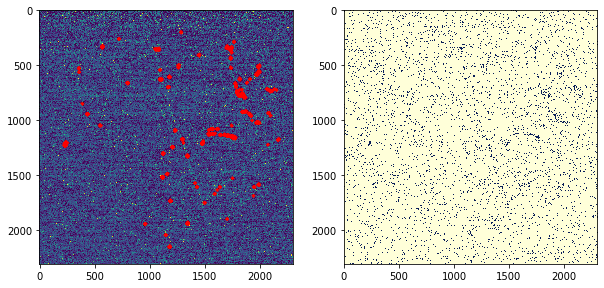

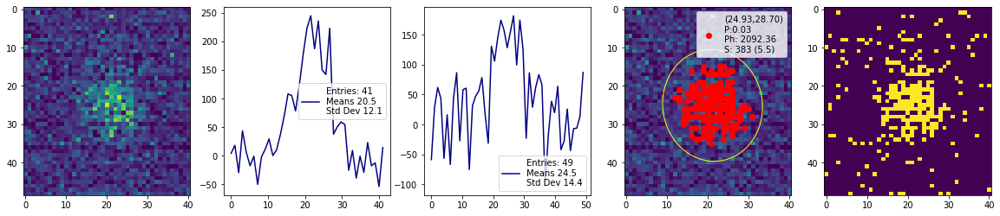

>>>> Processing RUN:  4043 Event:  1
>>>> Processing RUN:  4043 Event:  2
>>>> Processing RUN:  4043 Event:  3
>>>> Processing RUN:  4043 Event:  4
>>>> Processing RUN:  4043 Event:  5
>>>> Processing RUN:  4043 Event:  6
>>>> Processing RUN:  4043 Event:  7
>>>> Processing RUN:  4043 Event:  8
>>>> Processing RUN:  4043 Event:  9
>>>> Processing RUN:  4043 Event:  10
DEBUG: number of points, clusters: 355755 129
Elapsed time: 58.2
['iTr: 10.00', 'cluster_lable: 129.00', 'pixels: 392.00', 'photons: 2577.85', 'ph_pixels: 6.58', 'x0start: 1197.00', 'y0start: 1909.00', 'x0end: 1203.00', 'y0end: 1930.00', 'width: 27.03', 'height: 26.50', 'pearson: 0.07']


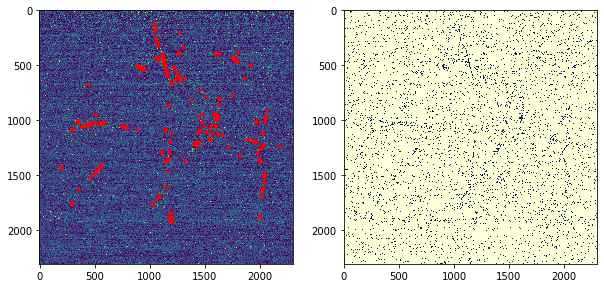

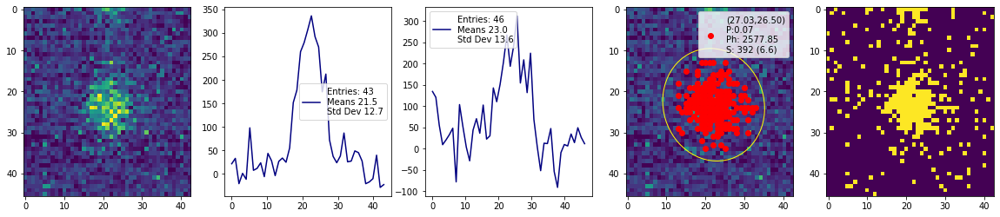

>>>> Processing RUN:  4043 Event:  11
>>>> Processing RUN:  4043 Event:  12
>>>> Processing RUN:  4043 Event:  13
>>>> Processing RUN:  4043 Event:  14
>>>> Processing RUN:  4043 Event:  15
>>>> Processing RUN:  4043 Event:  16
>>>> Processing RUN:  4043 Event:  17
>>>> Processing RUN:  4043 Event:  18
>>>> Processing RUN:  4043 Event:  19
>>>> Processing RUN:  4043 Event:  20
DEBUG: number of points, clusters: 335347 63
Elapsed time: 53.7
['iTr: 20.00', 'cluster_lable: 63.00', 'pixels: 357.00', 'photons: 2025.35', 'ph_pixels: 5.67', 'x0start: 1194.00', 'y0start: 2047.00', 'x0end: 1198.00', 'y0end: 2069.00', 'width: 24.72', 'height: 26.76', 'pearson: 0.17']


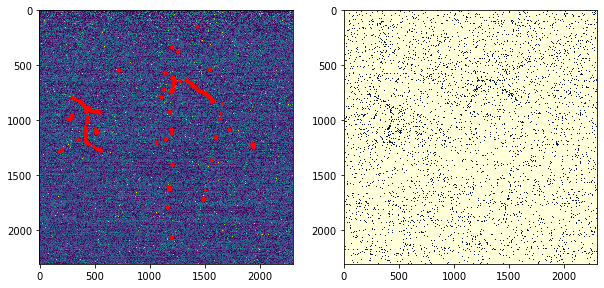

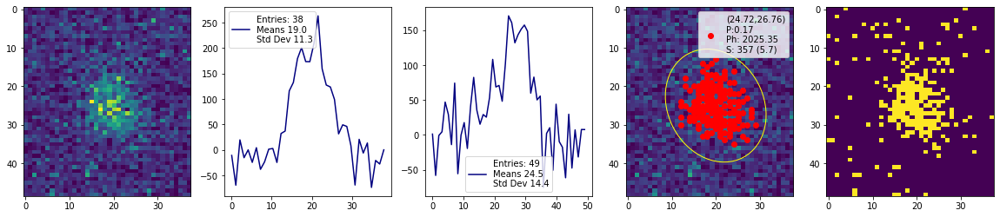

>>>> Processing RUN:  4043 Event:  21
>>>> Processing RUN:  4043 Event:  22
>>>> Processing RUN:  4043 Event:  23
>>>> Processing RUN:  4043 Event:  24
>>>> Processing RUN:  4043 Event:  25
>>>> Processing RUN:  4043 Event:  26
>>>> Processing RUN:  4043 Event:  27
>>>> Processing RUN:  4043 Event:  28
>>>> Processing RUN:  4043 Event:  29
>>>> Processing RUN:  4043 Event:  30
DEBUG: number of points, clusters: 330789 72
Elapsed time: 60.6
['iTr: 30.00', 'cluster_lable: 72.00', 'pixels: 249.00', 'photons: 1346.41', 'ph_pixels: 5.41', 'x0start: 667.00', 'y0start: 2074.00', 'x0end: 659.00', 'y0end: 2089.00', 'width: 20.22', 'height: 24.94', 'pearson: -0.58']


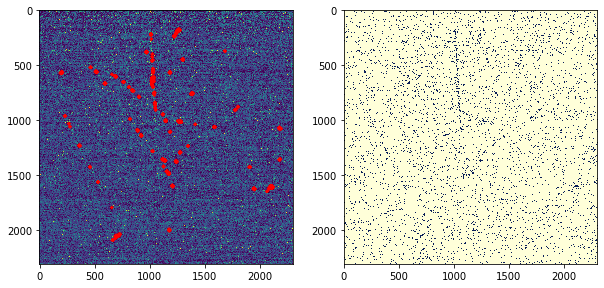

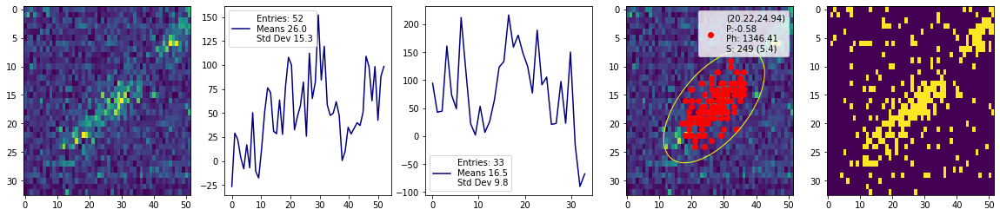

>>>> Processing RUN:  4043 Event:  31
>>>> Processing RUN:  4043 Event:  32


/usr/local/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in double_scalars


>>>> Processing RUN:  4043 Event:  33
>>>> Processing RUN:  4043 Event:  34
>>>> Processing RUN:  4043 Event:  35
>>>> Processing RUN:  4043 Event:  36
>>>> Processing RUN:  4043 Event:  37
>>>> Processing RUN:  4043 Event:  38
>>>> Processing RUN:  4043 Event:  39
>>>> Processing RUN:  4043 Event:  40
DEBUG: number of points, clusters: 351579 88
Elapsed time: 75.9
['iTr: 40.00', 'cluster_lable: 88.00', 'pixels: 362.00', 'photons: 2012.44', 'ph_pixels: 5.56', 'x0start: 777.00', 'y0start: 1871.00', 'x0end: 778.00', 'y0end: 1897.00', 'width: 13.74', 'height: 48.82', 'pearson: -0.31']


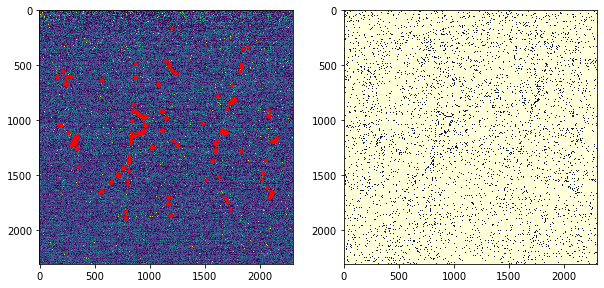

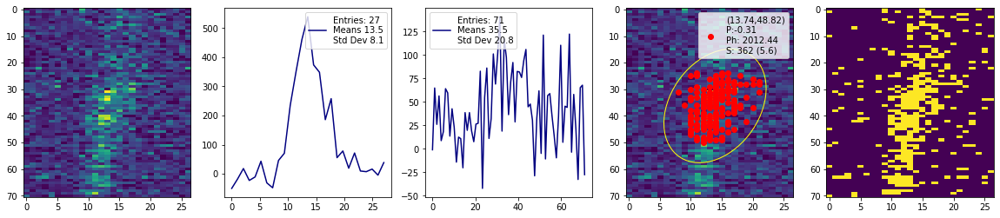

>>>> Processing RUN:  4043 Event:  41
>>>> Processing RUN:  4043 Event:  42
>>>> Processing RUN:  4043 Event:  43
>>>> Processing RUN:  4043 Event:  44
>>>> Processing RUN:  4043 Event:  45
>>>> Processing RUN:  4043 Event:  46
>>>> Processing RUN:  4043 Event:  47
>>>> Processing RUN:  4043 Event:  48
>>>> Processing RUN:  4043 Event:  49
>>>> Processing RUN:  4043 Event:  50
DEBUG: number of points, clusters: 351044 93
Elapsed time: 74.2
['iTr: 50.00', 'cluster_lable: 93.00', 'pixels: 358.00', 'photons: 1932.26', 'ph_pixels: 5.40', 'x0start: 1152.00', 'y0start: 2112.00', 'x0end: 1154.00', 'y0end: 2131.00', 'width: 21.78', 'height: 28.76', 'pearson: -0.06']


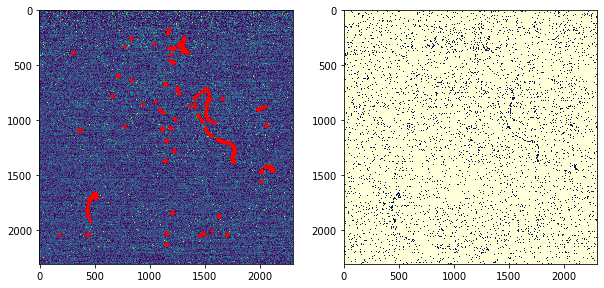

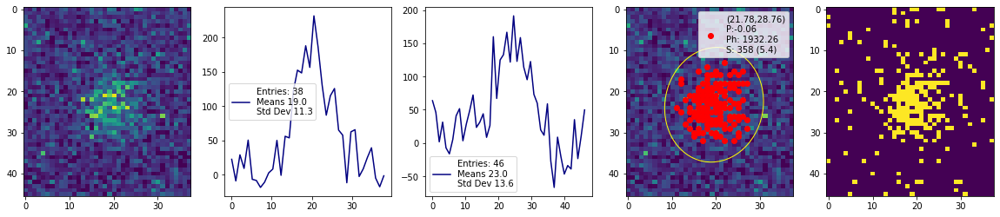

>>>> Processing RUN:  4043 Event:  51
>>>> Processing RUN:  4043 Event:  52
>>>> Processing RUN:  4043 Event:  53
>>>> Processing RUN:  4043 Event:  54
>>>> Processing RUN:  4043 Event:  55
>>>> Processing RUN:  4043 Event:  56
>>>> Processing RUN:  4043 Event:  57
>>>> Processing RUN:  4043 Event:  58
>>>> Processing RUN:  4043 Event:  59
>>>> Processing RUN:  4043 Event:  60
DEBUG: number of points, clusters: 332837 64
Elapsed time: 61.5
['iTr: 60.00', 'cluster_lable: 64.00', 'pixels: 281.00', 'photons: 1416.29', 'ph_pixels: 5.04', 'x0start: 1100.00', 'y0start: 2085.00', 'x0end: 1108.00', 'y0end: 2099.00', 'width: 23.62', 'height: 20.67', 'pearson: 0.17']


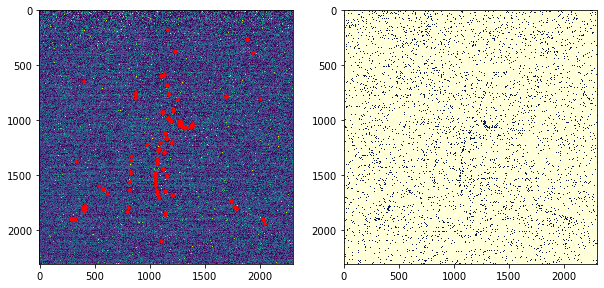

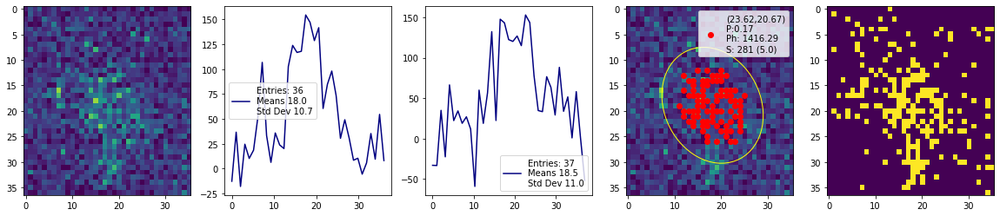

>>>> Processing RUN:  4043 Event:  61
>>>> Processing RUN:  4043 Event:  62
>>>> Processing RUN:  4043 Event:  63
>>>> Processing RUN:  4043 Event:  64
>>>> Processing RUN:  4043 Event:  65
>>>> Processing RUN:  4043 Event:  66
>>>> Processing RUN:  4043 Event:  67
>>>> Processing RUN:  4043 Event:  68
>>>> Processing RUN:  4043 Event:  69
>>>> Processing RUN:  4043 Event:  70
DEBUG: number of points, clusters: 334454 54
Elapsed time: 58.3
['iTr: 70.00', 'cluster_lable: 54.00', 'pixels: 368.00', 'photons: 1692.86', 'ph_pixels: 4.60', 'x0start: 965.00', 'y0start: 2113.00', 'x0end: 966.00', 'y0end: 2133.00', 'width: 21.32', 'height: 32.03', 'pearson: -0.14']


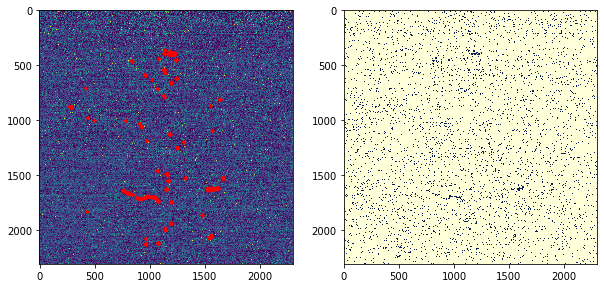

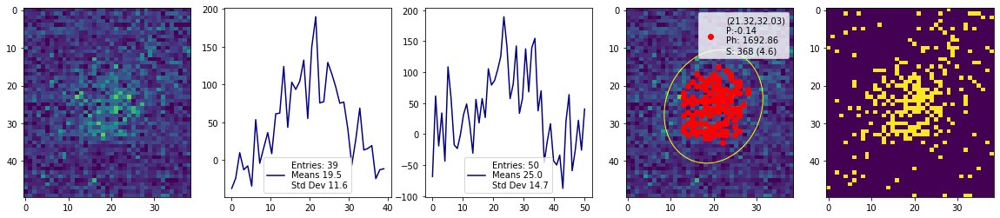

>>>> Processing RUN:  4043 Event:  71
>>>> Processing RUN:  4043 Event:  72
>>>> Processing RUN:  4043 Event:  73
>>>> Processing RUN:  4043 Event:  74
>>>> Processing RUN:  4043 Event:  75
>>>> Processing RUN:  4043 Event:  76
>>>> Processing RUN:  4043 Event:  77
>>>> Processing RUN:  4043 Event:  78
>>>> Processing RUN:  4043 Event:  79
>>>> Processing RUN:  4043 Event:  80
DEBUG: number of points, clusters: 330225 53
Elapsed time: 63.0
['iTr: 80.00', 'cluster_lable: 53.00', 'pixels: 910.00', 'photons: 4447.23', 'ph_pixels: 4.89', 'x0start: 1194.00', 'y0start: 2064.00', 'x0end: 1183.00', 'y0end: 2096.00', 'width: 31.28', 'height: 55.59', 'pearson: -0.64']


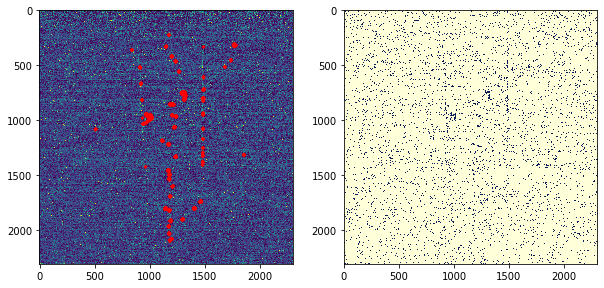

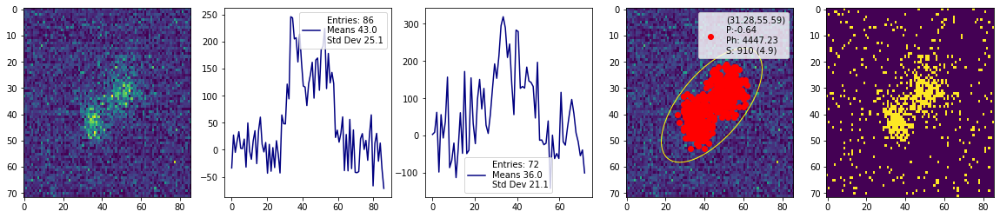

>>>> Processing RUN:  4043 Event:  81
>>>> Processing RUN:  4043 Event:  82
>>>> Processing RUN:  4043 Event:  83
>>>> Processing RUN:  4043 Event:  84
>>>> Processing RUN:  4043 Event:  85
>>>> Processing RUN:  4043 Event:  86
>>>> Processing RUN:  4043 Event:  87
>>>> Processing RUN:  4043 Event:  88
>>>> Processing RUN:  4043 Event:  89
>>>> Processing RUN:  4043 Event:  90
DEBUG: number of points, clusters: 355569 98
Elapsed time: 55.7
['iTr: 90.00', 'cluster_lable: 98.00', 'pixels: 156.00', 'photons: 853.88', 'ph_pixels: 5.47', 'x0start: 1419.00', 'y0start: 1931.00', 'x0end: 1424.00', 'y0end: 1940.00', 'width: 16.62', 'height: 15.28', 'pearson: 0.01']


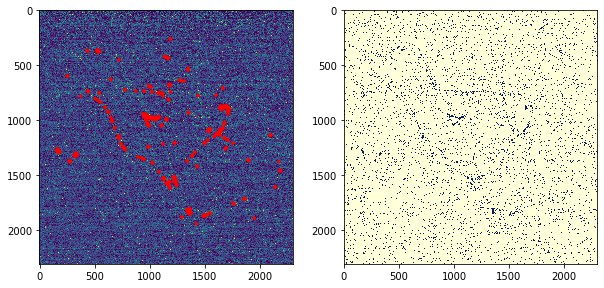

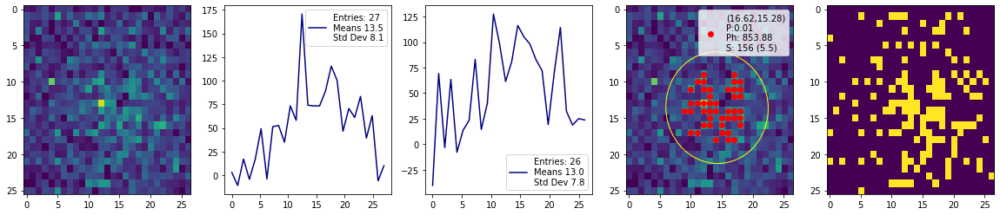

>>>> Processing RUN:  4043 Event:  91
>>>> Processing RUN:  4043 Event:  92
>>>> Processing RUN:  4043 Event:  93
>>>> Processing RUN:  4043 Event:  94
>>>> Processing RUN:  4043 Event:  95
>>>> Processing RUN:  4043 Event:  96
>>>> Processing RUN:  4043 Event:  97
>>>> Processing RUN:  4043 Event:  98
>>>> Processing RUN:  4043 Event:  99
>>>> Processing RUN:  4043 Event:  100
DEBUG: number of points, clusters: 344030 104
Elapsed time: 65.8
['iTr: 100.00', 'cluster_lable: 104.00', 'pixels: 249.00', 'photons: 1421.06', 'ph_pixels: 5.71', 'x0start: 1230.00', 'y0start: 1760.00', 'x0end: 1234.00', 'y0end: 1775.00', 'width: 19.23', 'height: 23.45', 'pearson: -0.00']


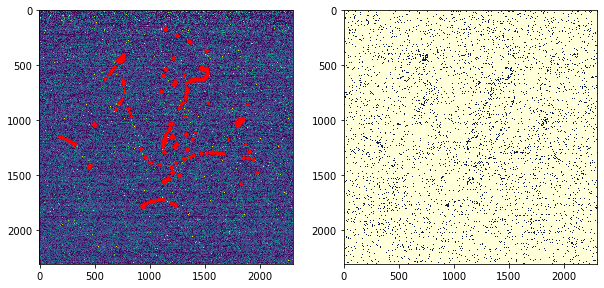

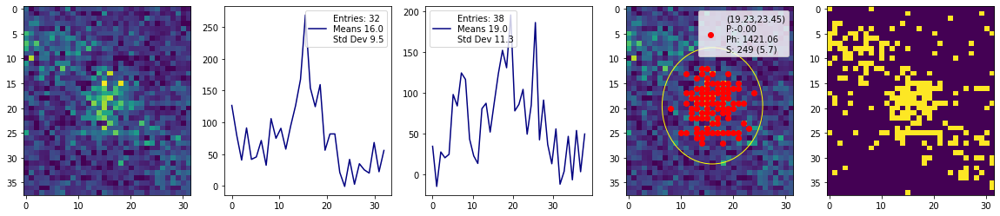

>>>> Processing RUN:  4043 Event:  101
>>>> Processing RUN:  4043 Event:  102
>>>> Processing RUN:  4043 Event:  103
>>>> Processing RUN:  4043 Event:  104
>>>> Processing RUN:  4043 Event:  105
>>>> Processing RUN:  4043 Event:  106
>>>> Processing RUN:  4043 Event:  107
>>>> Processing RUN:  4043 Event:  108
>>>> Processing RUN:  4043 Event:  109
>>>> Processing RUN:  4043 Event:  110
DEBUG: number of points, clusters: 338783 76
Elapsed time: 52.3
['iTr: 110.00', 'cluster_lable: 76.00', 'pixels: 127.00', 'photons: 685.70', 'ph_pixels: 5.40', 'x0start: 1529.00', 'y0start: 1880.00', 'x0end: 1529.00', 'y0end: 1890.00', 'width: 14.29', 'height: 16.50', 'pearson: -0.16']


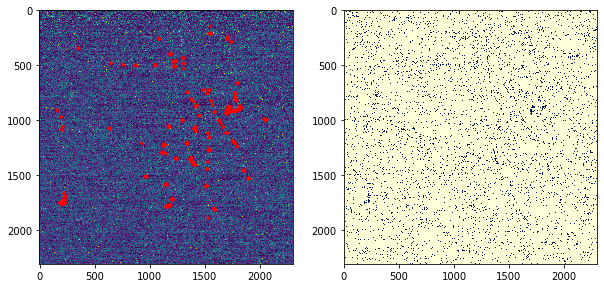

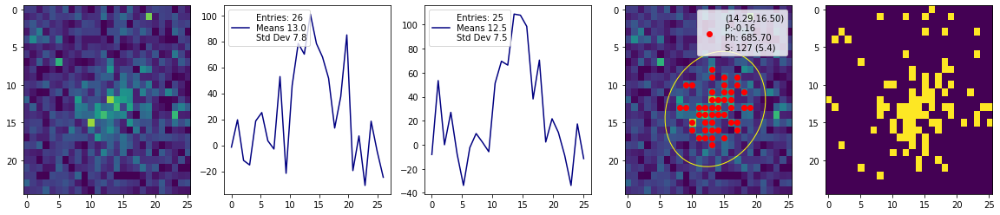

>>>> Processing RUN:  4043 Event:  111
>>>> Processing RUN:  4043 Event:  112
>>>> Processing RUN:  4043 Event:  113
>>>> Processing RUN:  4043 Event:  114
>>>> Processing RUN:  4043 Event:  115
>>>> Processing RUN:  4043 Event:  116
>>>> Processing RUN:  4043 Event:  117
>>>> Processing RUN:  4043 Event:  118
>>>> Processing RUN:  4043 Event:  119
>>>> Processing RUN:  4043 Event:  120
DEBUG: number of points, clusters: 351197 97
Elapsed time: 56.2
['iTr: 120.00', 'cluster_lable: 97.00', 'pixels: 444.00', 'photons: 2768.28', 'ph_pixels: 6.23', 'x0start: 894.00', 'y0start: 1845.00', 'x0end: 893.00', 'y0end: 1868.00', 'width: 22.63', 'height: 35.24', 'pearson: -0.36']


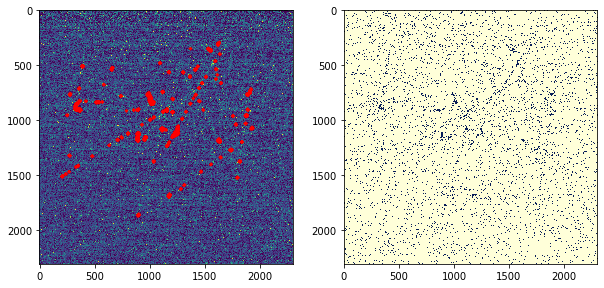

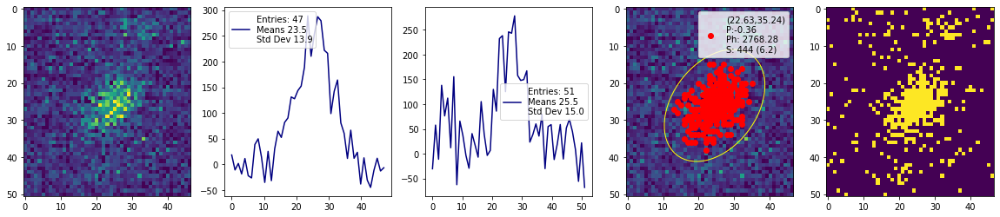

>>>> Processing RUN:  4043 Event:  121
>>>> Processing RUN:  4043 Event:  122
>>>> Processing RUN:  4043 Event:  123
>>>> Processing RUN:  4043 Event:  124
>>>> Processing RUN:  4043 Event:  125
>>>> Processing RUN:  4043 Event:  126
>>>> Processing RUN:  4043 Event:  127
>>>> Processing RUN:  4043 Event:  128
>>>> Processing RUN:  4043 Event:  129
>>>> Processing RUN:  4043 Event:  130
DEBUG: number of points, clusters: 345790 98
Elapsed time: 55.2
['iTr: 130.00', 'cluster_lable: 98.00', 'pixels: 298.00', 'photons: 1706.49', 'ph_pixels: 5.73', 'x0start: 1153.00', 'y0start: 2137.00', 'x0end: 1154.00', 'y0end: 2153.00', 'width: 25.43', 'height: 22.37', 'pearson: -0.04']


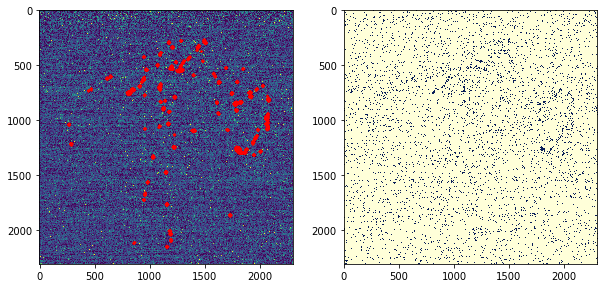

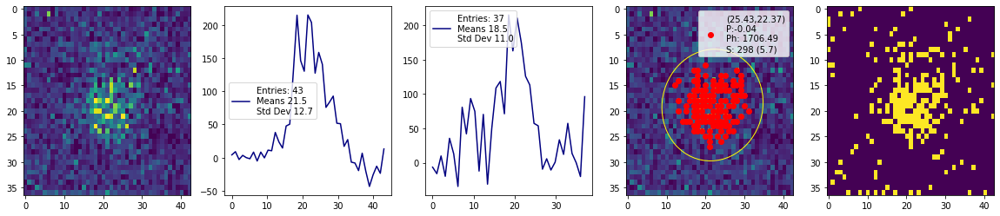

>>>> Processing RUN:  4043 Event:  131
>>>> Processing RUN:  4043 Event:  132
>>>> Processing RUN:  4043 Event:  133
>>>> Processing RUN:  4043 Event:  134
>>>> Processing RUN:  4043 Event:  135
>>>> Processing RUN:  4043 Event:  136
>>>> Processing RUN:  4043 Event:  137
>>>> Processing RUN:  4043 Event:  138
>>>> Processing RUN:  4043 Event:  139
>>>> Processing RUN:  4043 Event:  140
DEBUG: number of points, clusters: 337327 92
Elapsed time: 65.2
['iTr: 140.00', 'cluster_lable: 92.00', 'pixels: 390.00', 'photons: 2166.03', 'ph_pixels: 5.55', 'x0start: 1139.00', 'y0start: 2098.00', 'x0end: 1148.00', 'y0end: 2117.00', 'width: 24.21', 'height: 27.78', 'pearson: 0.06']


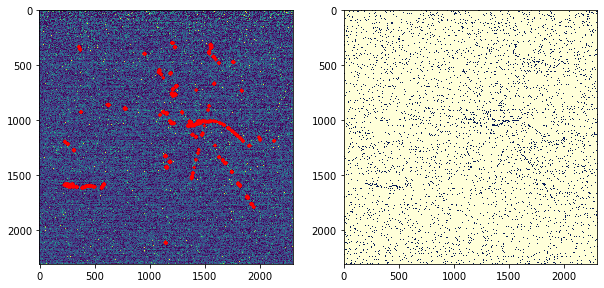

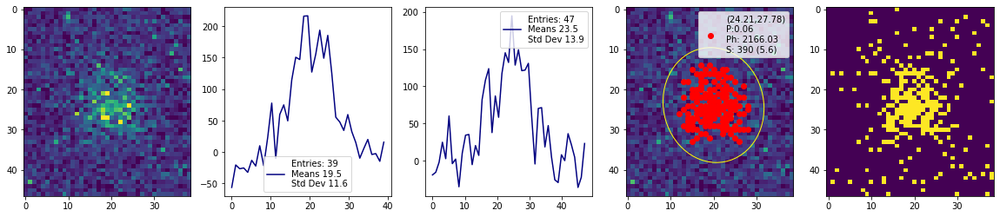

>>>> Processing RUN:  4043 Event:  141
>>>> Processing RUN:  4043 Event:  142
>>>> Processing RUN:  4043 Event:  143
>>>> Processing RUN:  4043 Event:  144
>>>> Processing RUN:  4043 Event:  145
>>>> Processing RUN:  4043 Event:  146
>>>> Processing RUN:  4043 Event:  147
>>>> Processing RUN:  4043 Event:  148
>>>> Processing RUN:  4043 Event:  149
>>>> Processing RUN:  4043 Event:  150
DEBUG: number of points, clusters: 332691 61
Elapsed time: 55.6
['iTr: 150.00', 'cluster_lable: 61.00', 'pixels: 1632.00', 'photons: 18315.85', 'ph_pixels: 11.22', 'x0start: 1281.00', 'y0start: 1892.00', 'x0end: 1300.00', 'y0end: 1933.00', 'width: 64.22', 'height: 43.56', 'pearson: 0.33']


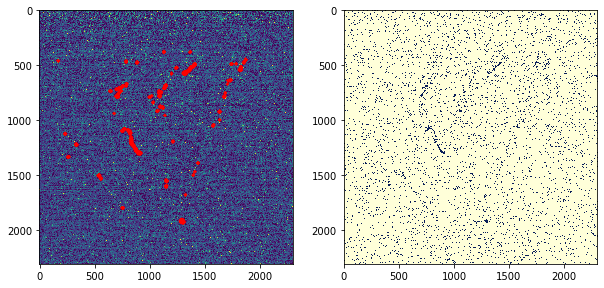

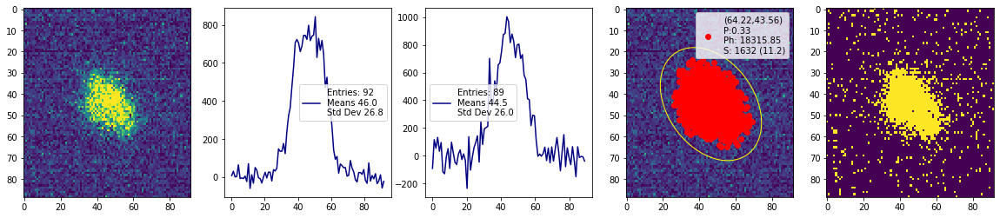

>>>> Processing RUN:  4043 Event:  151
>>>> Processing RUN:  4043 Event:  152
>>>> Processing RUN:  4043 Event:  153
>>>> Processing RUN:  4043 Event:  154
>>>> Processing RUN:  4043 Event:  155
>>>> Processing RUN:  4043 Event:  156
>>>> Processing RUN:  4043 Event:  157
>>>> Processing RUN:  4043 Event:  158
>>>> Processing RUN:  4043 Event:  159
>>>> Processing RUN:  4043 Event:  160
DEBUG: number of points, clusters: 343373 92
Elapsed time: 55.3
['iTr: 160.00', 'cluster_lable: 92.00', 'pixels: 400.00', 'photons: 2375.98', 'ph_pixels: 5.94', 'x0start: 1167.00', 'y0start: 1972.00', 'x0end: 1167.00', 'y0end: 1994.00', 'width: 26.19', 'height: 29.13', 'pearson: -0.03']


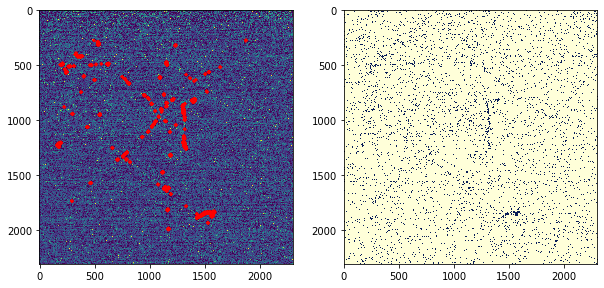

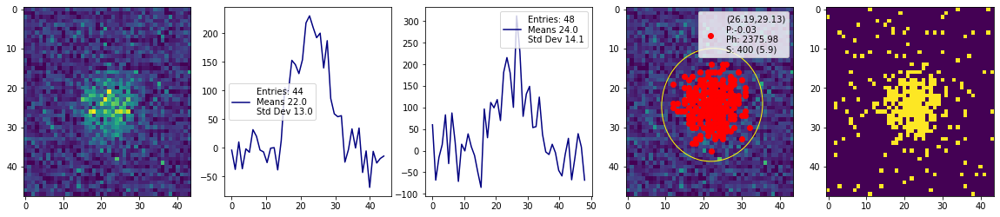

>>>> Processing RUN:  4043 Event:  161
>>>> Processing RUN:  4043 Event:  162
>>>> Processing RUN:  4043 Event:  163
>>>> Processing RUN:  4043 Event:  164
>>>> Processing RUN:  4043 Event:  165
>>>> Processing RUN:  4043 Event:  166
>>>> Processing RUN:  4043 Event:  167
>>>> Processing RUN:  4043 Event:  168
>>>> Processing RUN:  4043 Event:  169
>>>> Processing RUN:  4043 Event:  170
DEBUG: number of points, clusters: 333268 78
Elapsed time: 61.6
['iTr: 170.00', 'cluster_lable: 78.00', 'pixels: 155.00', 'photons: 902.54', 'ph_pixels: 5.82', 'x0start: 1382.00', 'y0start: 1893.00', 'x0end: 1384.00', 'y0end: 1906.00', 'width: 20.43', 'height: 14.04', 'pearson: 0.45']


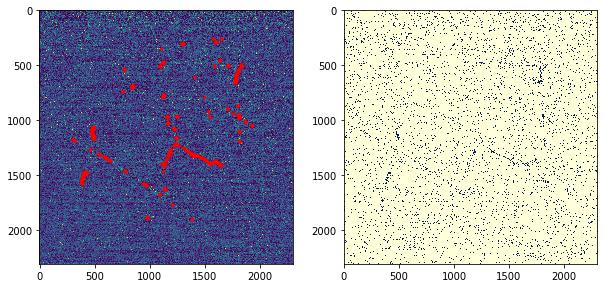

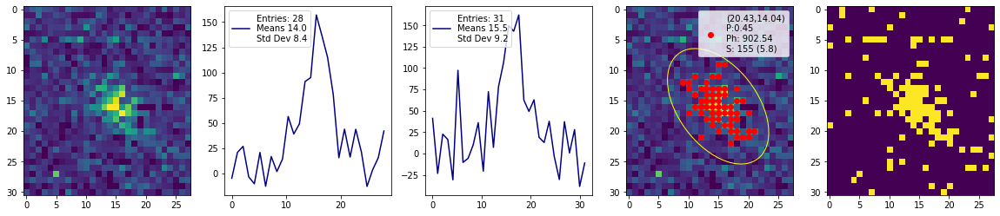

>>>> Processing RUN:  4043 Event:  171
>>>> Processing RUN:  4043 Event:  172
>>>> Processing RUN:  4043 Event:  173
>>>> Processing RUN:  4043 Event:  174
>>>> Processing RUN:  4043 Event:  175
>>>> Processing RUN:  4043 Event:  176
>>>> Processing RUN:  4043 Event:  177
>>>> Processing RUN:  4043 Event:  178
>>>> Processing RUN:  4043 Event:  179
>>>> Processing RUN:  4043 Event:  180
DEBUG: number of points, clusters: 328317 77
Elapsed time: 53.1
['iTr: 180.00', 'cluster_lable: 77.00', 'pixels: 468.00', 'photons: 2507.92', 'ph_pixels: 5.36', 'x0start: 1139.00', 'y0start: 2091.00', 'x0end: 1144.00', 'y0end: 2113.00', 'width: 29.06', 'height: 29.51', 'pearson: 0.01']


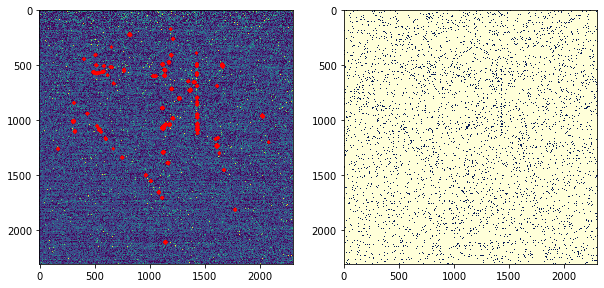

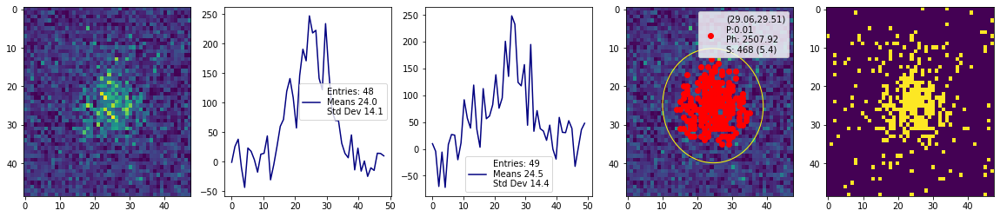

>>>> Processing RUN:  4043 Event:  181
>>>> Processing RUN:  4043 Event:  182
>>>> Processing RUN:  4043 Event:  183
>>>> Processing RUN:  4043 Event:  184
>>>> Processing RUN:  4043 Event:  185
>>>> Processing RUN:  4043 Event:  186
>>>> Processing RUN:  4043 Event:  187
>>>> Processing RUN:  4043 Event:  188
>>>> Processing RUN:  4043 Event:  189
>>>> Processing RUN:  4043 Event:  190
DEBUG: number of points, clusters: 340653 90
Elapsed time: 62.7
['iTr: 190.00', 'cluster_lable: 90.00', 'pixels: 322.00', 'photons: 1627.03', 'ph_pixels: 5.05', 'x0start: 1167.00', 'y0start: 2163.00', 'x0end: 1170.00', 'y0end: 2181.00', 'width: 23.10', 'height: 25.03', 'pearson: 0.14']


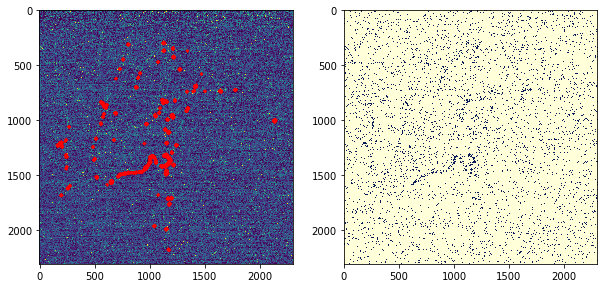

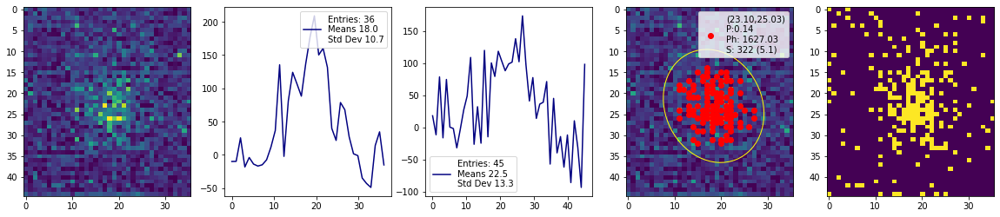

>>>> Processing RUN:  4043 Event:  191
>>>> Processing RUN:  4043 Event:  192
>>>> Processing RUN:  4043 Event:  193
>>>> Processing RUN:  4043 Event:  194
>>>> Processing RUN:  4043 Event:  195
>>>> Processing RUN:  4043 Event:  196
>>>> Processing RUN:  4043 Event:  197
>>>> Processing RUN:  4043 Event:  198
>>>> Processing RUN:  4043 Event:  199
out file /workarea/cloud-storage/mazzitel/out/dbscan_run4043_cmin_0_cmax_500_rescale_2304_nsigma_1.5_ev_200_ped_4038.plk.gz
Open file: /workarea/cloud-storage/cygnus/Data/LAB/histograms_Run04044.root
Find Keys: 200
# of Images (TH2) Files: 200 
# of Waveform (TH2) Files: 0 
Camera X, Y pixel: 2304 2304 
>>>> Processing RUN:  4044 Event:  0
DEBUG: number of points, clusters: 338313 63
Elapsed time: 66.2
['iTr: 0.00', 'cluster_lable: 63.00', 'pixels: 353.00', 'photons: 2015.46', 'ph_pixels: 5.71', 'x0start: 645.00', 'y0start: 2127.00', 'x0end: 651.00', 'y0end: 2146.00', 'width: 34.33', 'height: 19.00', 'pearson: 0.37']


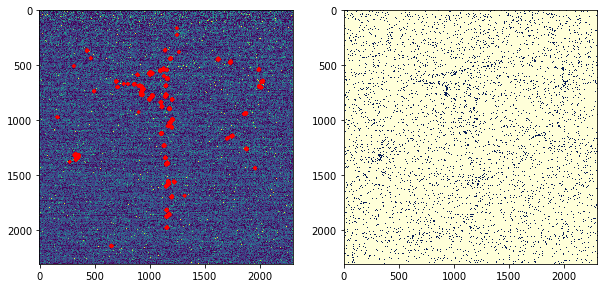

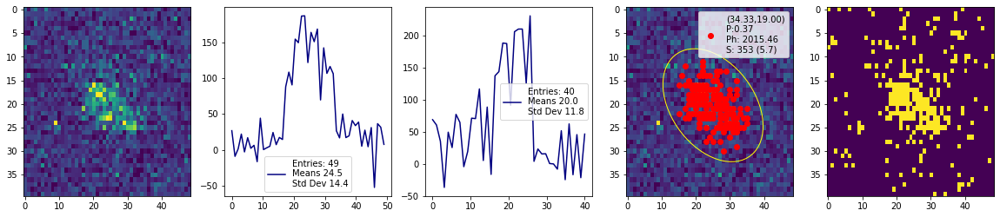

>>>> Processing RUN:  4044 Event:  1
>>>> Processing RUN:  4044 Event:  2
>>>> Processing RUN:  4044 Event:  3
>>>> Processing RUN:  4044 Event:  4
>>>> Processing RUN:  4044 Event:  5
>>>> Processing RUN:  4044 Event:  6
>>>> Processing RUN:  4044 Event:  7
>>>> Processing RUN:  4044 Event:  8
>>>> Processing RUN:  4044 Event:  9
>>>> Processing RUN:  4044 Event:  10


In [ ]:
######################## INIT ###############################
# bandella
runI          = [4184, 4176, 4168, 4160, 4152, 4144, 4136, 4128, 4120] 
run_ped       = 4183
# KFC
runI          = [4039, 4040, 4041, 4042, 4043, 4044, 4045, 4046, 4047]
run_ped       = 4038 
# # KFC cosmici
# runI          = [4035]
# run_ped       = 4034

cimax         = 500
cimin         = 0 
tag           = 'LAB'
nsigma        = 1.5 
fast          = False
doRescale     = False
###############################################################
cfile = cy.open_(runI[0], tag=tag, posix=posix, verbose=False)
if cfile.x_resolution == 2048:
    rescale = 512 # orca flash
else:
    rescale = 576 # fusion


if not doRescale: 
    rescale = cfile.x_resolution
    eps=5
    min_samples = 40
    
    
else:
    eps=2
    min_samples = 5

        
tscale = int(cfile.x_resolution/rescale)
print("rascale: ", tscale)

################################################################
debug         = False
columns = ["iTr", "cluster_lable", "pixels", "photons", "ph_pixels", "x0start", "y0start", 
          "x0end", "y0end", "width", "height", "pearson"]


######################### Load PED #############################

m_image, s_image = cy.ped_(run_ped, path=mybasepath+'ped/')

#########################

th_image   = np.round(m_image + nsigma*s_image)
print ("light over Th: %.2f " % (th_image.sum()-m_image.sum()))

start_time = time.time()
# loop sui fle da analizaare
for nRi in range(len(runI)):
    try:
        # open file
        cfile = cy.open_(runI[nRi], tag=tag, posix=posix, verbose=True)
    except:
        print ('Problem in open file: ', runI[nRi])
        break
    #
    # crea un db vuoto da riempire 
    df = pd.DataFrame(columns = columns)
    # crea nome file di output
    file_out = (mybasepath+"out/dbscan_run%d_cmin_%d_cmax_%d_rescale_%d_nsigma_%.1f_ev_%d_ped_%d.plk.gz" % 
                (runI[nRi], cimin, cimax, rescale, nsigma, cfile.max_image, run_ped))
    #
######## main loop sulle imagini da analizzare ###########
    for iTr in range(0, cfile.max_image): # cfile.max_image
        #if iTr % 10 == 0: 
          # running & debug ...
        print ('>>>> Processing RUN: ', runI[nRi], 'Event: ', iTr)
          # end 

        image = rtnp.hist2array(cfile.file.Get(cfile.pic[iTr])).T
        raw_image       = (image-m_image)
        rebin_image     = cy.rebin(raw_image, (rescale, rescale))  
        rebin_th_image  = cy.rebin((th_image-m_image), (rescale, rescale))
        edges           = (rebin_image > rebin_th_image) & (rebin_image < cimax)         
        points          = np.array(np.nonzero(edges)).T.astype(float) 
        
        # X_scaled        = StandardScaler().fit_transform(cy.poit_3d(points, rebin_image)) # 3D
        # dbscan          = DBSCAN(eps=0.045, min_samples = 20).fit(X_scaled) # eps=0.08 per 3D 0.04 2D
        
        dbscan          = DBSCAN(eps=eps, min_samples = min_samples).fit(points) 
        clusters        = dbscan.labels_
        n_points      = len(clusters>-1)
        if debug: print ("Clustering Elapsed time: {:.1f}".format(time.time() - start_time))
        for ic in range (0, max(clusters)+1):
            width = height = pearson = ph = dim = 0
            yc = points[:,0][clusters==ic]
            xc = points[:,1][clusters==ic]
            
            if fast:
                            #
            # attenzine NORMALIZZAZIONE per per rscale
            #
                ph, dim = cy.cluster_par(xc, yc, rebin_image) 
                width, height, pearson, _, _ = cy.confidence_ellipse_par(xc,yc)
                ph     = ph*tscale*tscale
                dim    = dim*tscale*tscale
                width  = width*tscale
                height = height*tscale            
                if debug: print ("Elapsed time fast: {:.1f}".format(time.time() - start_time))
            else:
                zx1 = int(xc.mean() - 5*xc.std())
                zx2 = int(xc.mean() + 5*xc.std())
                zy1 = int(yc.mean() - 5*yc.std())
                zy2 = int(yc.mean() + 5*yc.std())
                
                izoom = raw_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]            
                width, height, pearson, ph, dim = cy.confidence_ellipse_par((xc-zx1)*tscale, (yc-zy1)*tscale, 
                                                                            image = izoom)
                if debug: print ("Elapsed time slow: {:.1f}".format(time.time() - start_time))

            for j in range(0, xc.shape[0]):
                x=int(xc[j])
                y=int(yc[j])
                #ph += rebin_image[y,x]
                if j == 0:
                    x0start = x*tscale
                    y0start = y*tscale
            x0end = x*tscale
            y0end = y*tscale

            
            # 
            # salva info per ogni cluster
            #
            df = df.append({columns[0]:iTr, columns[1]:ic, columns[2]:dim, columns[3]:ph, columns[4]:ph/dim, 
                            columns[5]:x0start, columns[6]:y0start, columns[7]:x0end, columns[8]:y0end, 
                            columns[9]:width, columns[10]:height, columns[11]:pearson},
                            ignore_index=True)
########### Debug  #####################################
        if iTr % 10 == 0 or debug:
            print ("DEBUG: number of points, clusters: " +str(n_points), ic) 
            print ("Elapsed time 10 events: {:.1f}".format(time.time() - start_time))
            print ([str(columns[i])+': {:.2f}'.format(x) for i, x in enumerate (df.tail(1).values[0])])
            fig, ax = plt.subplots (1,2, figsize=(10,5))
            ax[0].imshow(rebin_image, vmin=-5, vmax=20)
            yc = points[:,0][clusters>-1]
            xc = points[:,1][clusters>-1]
            ax[0].plot(xc,yc, 'r.', markersize=1, label="ic"+str(ic))
            ax[1].imshow(edges, cmap='YlGnBu', vmin=0,vmax=1)
            plt.show()

            if ic>0:
                fig, ax = plt.subplots(1,5, figsize=(20,4))
                yc = points[:,0][clusters==ic]
                xc = points[:,1][clusters==ic]

                zx1 = int(xc.mean() - 5*xc.std())
                zx2 = int(xc.mean() + 5*xc.std())
                zy1 = int(yc.mean() - 5*yc.std())
                zy2 = int(yc.mean() + 5*yc.std())
                izoom = raw_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale] 
                ax[0].imshow(izoom, vmin=-5, vmax=30, aspect="auto")
                
                py = np.sum(izoom, axis=0)
                px = np.sum(izoom, axis=1)
                
                x = np.linspace(0, py.size, py.size)
                ax[1].plot(x,py, "navy", label='Entries: {:d}\nMeans {:.1f}\nStd Dev {:.1f}'.format(x.size, 
                                                                                                    x.mean(), x.std()))
                x = np.linspace(0, px.size, px.size)
                ax[2].plot(x,px, "navy", label='Entries: {:d}\nMeans {:.1f}\nStd Dev {:.1f}'.format(x.size, 
                                                                                                    x.mean(), x.std()))

                ax[3].imshow(rebin_image[zy1:zy2,zx1:zx2], vmin=-5, vmax=30, aspect="auto")
                el_plt, el_par = cy.confidence_ellipse(xc-zx1, yc-zy1, ax[3], edgecolor='yellow')
                ax[3].scatter(xc-zx1, yc-zy1, color='red', label = ('(%.2f,%.2f)\nP:%.2f\nPh: %.2f\nS: %d (%.1f)' %
                                        (width, height, pearson, ph, dim, ph/dim)))
                ax[4].imshow(edges[zy1:zy2,zx1:zx2], aspect="auto")
                ax[1].legend()
                ax[2].legend()
                ax[3].legend()
                plt.show()
            start_time = time.time()
#################### close and save ################
    df.to_pickle(file_out, compression='gzip')
    print ("out file", file_out)

# debug and test

In [12]:

print(cy.cluster_par(xc, yc, rebin_image) )
print(cy.confidence_ellipse_par(xc,yc))
print(cy.confidence_ellipse_par((xc-zx1)*tscale, (yc-zy1)*tscale, image = izoom))

(2816575.904999923, 335591)
(3984.063026100433, 3936.873663228316, 0.0161281196789527, 0.0, 0)
(3984.063026100432, 3936.873663228316, 0.016128119678952696, 1786.4199999999998, 555)


number of points, closters: 357012 -1
3 -1 335591 2816575.904999923 8.39288272033494 32 0 1153 1962 3984.063026100433 3936.873663228316 0.0161281196789527


/usr/local/lib/python3.6/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


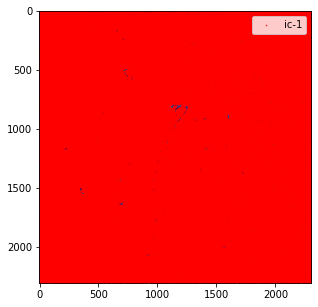

In [13]:
print ("number of points, closters: " +str(n_points), ic)
print(iTr, ic, dim, ph, ph/dim,x0start,y0start,x0end, y0end, width, height,pearson)
fig = plt.figure(figsize=(5,5))
plt.imshow(rebin_image, vmin=-5, vmax=30)
yc = points[:,1][clusters==ic]
xc = points[:,0][clusters==ic]
plt.plot(xc,yc, 'r.', markersize=1, label="ic"+str(ic))
plt.legend()
plt.show()

IndexError: boolean index did not match indexed array along dimension 0; dimension is 341982 but corresponding boolean dimension is 349463

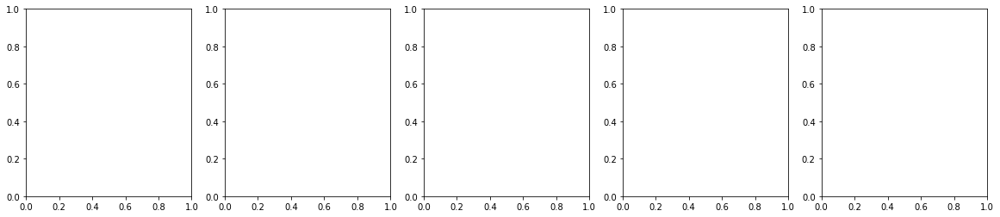

In [6]:
fig, ax = plt.subplots(1,5, figsize=(20,4))
ic = 10
yc = points[:,0][clusters==ic]
xc = points[:,1][clusters==ic]

dd = 20/tscale
zx1 = int(xc.mean() - dd)
zx2 = int(xc.mean() + dd)
zy1 = int(yc.mean() - dd)
zy2 = int(yc.mean() + dd)
#izoom = image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]-m_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]
izoom = raw_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]
ax[0].imshow(izoom, vmin=-5, vmax=30)
py = np.mean(izoom, axis=0)
px = np.mean(izoom, axis=1)
x = np.linspace(0, py.size, py.size)
ax[1].plot(x,py, "navy", label='Entries: {:d}\nMeans {:.1f}\nStd Dev {:.1f}'.format(x.size, x.mean(), x.std()))
ax[2].plot(x,px, "navy", label='Entries: {:d}\nMeans {:.1f}\nStd Dev {:.1f}'.format(x.size, x.mean(), x.std()))

ax[3].imshow(rebin_image[zy1:zy2,zx1:zx2], vmin=-5, vmax=30)


_, _ = cy.confidence_ellipse(xc-zx1, yc-zy1, ax[3], edgecolor='yellow')

ph, dim = cy.cluster_par(xc, yc, rebin_image)
width, height, pearson, _, _ = cy.confidence_ellipse_par(xc, yc)
ax[3].scatter(xc-zx1, yc-zy1, color='red', label = ('(%.2f,%.2f)\nP:%.2f\nPh: %.2f\nS: %d (%.1f)' %
                                    (width, height, pearson, ph, dim, ph/dim)))
ax[4].imshow(edges[zy1:zy2,zx1:zx2])

print(iTr, ic, dim, ph, width, height, pearson)

ph = ph*tscale*tscale
dim = dim*tscale*tscale
width = width*tscale
height = height*tscale
print(iTr, ic, dim, ph, width, height, pearson)


ax[1].legend()
ax[2].legend()
ax[3].legend()
plt.show()


In [ ]:
def n_std_rectangle(x, y, ax, image = np.array([]), n_std=3.0, facecolor='none', **kwargs):
    from matplotlib.patches import Rectangle
    mean_x = x.mean()
    mean_y = y.mean()
    std_x = x.std()
    std_y = y.std()
    half_width = n_std * std_x
    half_height = n_std * std_y
    if image.any():
        rimage = image*0
        xs = int(mean_x - half_width)+1
        xe = int(mean_x + half_width)+1
        ys = int(mean_y - half_height)+1
        ye = int(mean_y + half_height)+1
        # print(ys,ye, xs,xe)
        rimage[ys:ye, xs:xe]=image[ys:ye, xs:xe]
        # print (rimage)
        # print(rimage.sum())
        
    rectangle = Rectangle(
        (mean_x - half_width, mean_y - half_height),
        2 * half_width, 2 * half_height, facecolor=facecolor, **kwargs)
    return ax.add_patch(rectangle), rimage  

def confidence_ellipse(x, y, ax, image = np.array([]), n_std=3.0, facecolor='none', **kwargs):
    from matplotlib.patches import Ellipse
    import matplotlib.transforms as transforms
    import numpy as np

    if x.size != y.size:
        raise ValueError("x and y must be the same size")

    cov = np.cov(x, y)
    pearson = cov[0, 1]/np.sqrt(cov[0, 0] * cov[1, 1])
    # Using a special case to obtain the eigenvalues of this
    # two-dimensionl dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0),
        width=ell_radius_x * 2,
        height=ell_radius_y * 2,
        facecolor=facecolor,
        **kwargs)

    # Calculating the stdandard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0, 0]) * n_std
    mean_x = np.mean(x)

    # calculating the stdandard deviation of y ...
    scale_y = np.sqrt(cov[1, 1]) * n_std
    mean_y = np.mean(y)
    if image.any():
        # ellsisse e' (x-x0)**2/a**2 + (y-y0)**2/b**2 < 1
        # print (mean_x, mean_y, ell_radius_x*scale_x, ell_radius_y*scale_y)
        rimage = image*0
        ar = abs(pearson)
        for x in range(image.shape[1]):
            for y in range(image.shape[0]):
                xr = (y-mean_y)*np.sin(ar)+(x-mean_x)*np.cos(ar)
                yr = (y-mean_y)*np.cos(ar)-(x-mean_x)*np.sin(ar)
                if (xr)**2/(ell_radius_x*scale_x)**2 + (yr)**2/(ell_radius_y*scale_y)**2 < 1:
                    rimage[y,x]=image[y, x]
        # print (rimage)
        # print(rimage.sum())
    
    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(mean_x, mean_y)

    ellipse.set_transform(transf + ax.transData)

    return ax.add_patch(ellipse), rimage 


def confidence_ellipse_par(x, y, image = np.array([]), n_std=3.0, facecolor='none', **kwargs):
    import numpy as np

    if x.size != y.size:
        raise ValueError("x and y must be the same size")

    cov = np.cov(x, y)
    pearson = cov[0, 1]/np.sqrt(cov[0, 0] * cov[1, 1])

    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
                           
    scale_x = np.sqrt(cov[0, 0]) * n_std
    mean_x = np.mean(x)

    scale_y = np.sqrt(cov[1, 1]) * n_std
    mean_y = np.mean(y)
                           
    width=scale_x*ell_radius_x * 2 
    height=scale_y*ell_radius_y * 2              
    if image.any():
        # ellsisse e' (x-x0)**2/a**2 + (y-y0)**2/b**2 < 1
        # print (mean_x, mean_y, ell_radius_x*scale_x, ell_radius_y*scale_y)
        rimage = image*0
        ar = abs(pearson)
        for x in range(image.shape[1]):
            for y in range(image.shape[0]):
                xr = (y-mean_y)*np.sin(ar)+(x-mean_x)*np.cos(ar)
                yr = (y-mean_y)*np.cos(ar)-(x-mean_x)*np.sin(ar)
                if (xr)**2/(ell_radius_x*scale_x)**2 + (yr)**2/(ell_radius_y*scale_y)**2 < 1:
                    rimage[y,x]=image[y, x]
        # print (rimage)
        # print(rimage.sum())
    else:
        rimage = np.array([])

    
    return width, height, pearson, rimage.sum(), np.size(rimage[rimage>0])


scaled ph: -13.0 dim: 94
real sq ph -119.7 dim: 59
real el ph -51.3 dim: 121
975
(15.822726519082194, 22.50599042769216, 0.08439339785215864, -51.250000000000014, 121)


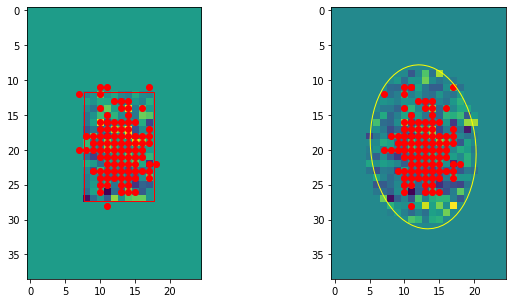

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import matplotlib.transforms as transforms

zx1 = int(xc.mean() - 5*xc.std())
zx2 = int(xc.mean() + 5*xc.std())
zy1 = int(yc.mean() - 5*yc.std())
zy2 = int(yc.mean() + 5*yc.std())
#izoom = image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]-m_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]
izoom = raw_image[zy1*tscale:zy2*tscale,zx1*tscale:zx2*tscale]

ph, dim = cy.cluster_par(xc, yc, rebin_image)
print ("scaled ph: {:.1f} dim: {:d}".format(ph*tscale*tscale, dim*tscale*tscale))

fig, ax = plt.subplots(1,2, figsize=(10,5))
ax[0].imshow(izoom, vmin=-5, vmax=30)
_, rimage1 = cy.n_std_rectangle((xc-zx1)*tscale, (yc-zy1)*tscale, ax[0], edgecolor='red', image=izoom,n_std=2.0)
ax[0].scatter((xc-zx1)*tscale, (yc-zy1)*tscale, color='red')
ax[0].imshow(rimage1)
print ("real sq ph {:.1f} dim: {:d}".format(rimage1.sum(), np.size(rimage1[rimage1>0])))
ax[1].imshow(izoom, vmin=-5, vmax=30)
_, rimage2 = cy.confidence_ellipse((xc-zx1)*tscale, (yc-zy1)*tscale, ax[1], edgecolor='yellow',image=izoom, n_std=3.0)
print ("real el ph {:.1f} dim: {:d}".format(rimage2.sum(), np.size(rimage2[rimage2>0])))
print(np.size(rimage2))
ax[1].imshow(rimage2)
ax[1].scatter((xc-zx1)*tscale, (yc-zy1)*tscale, color='red')

print(cy.confidence_ellipse_par((xc-zx1)*tscale, (yc-zy1)*tscale, image = izoom))

plt.show()

In [9]:
%timeit  cy.confidence_ellipse_par((xc-zx1)*tscale, (yc-zy1)*tscale, image = izoom)

43 s ± 2.1 s per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [10]:
def di2(xc, yc, rebin_image):
    cy.cluster_par(xc, yc, rebin_image) 
    cy.confidence_ellipse_par(xc,yc)
%timeit di2(xc, yc, rebin_image)

273 ms ± 9.52 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


[[2.1 2.2]
 [3.1 3.2]]
[[0.  0.  0.  0. ]
 [0.  2.1 2.2 0. ]
 [0.  3.1 3.2 0. ]
 [0.  0.  0.  0. ]]


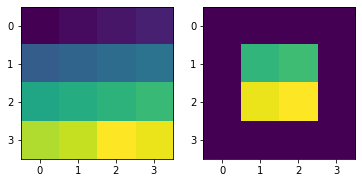

In [8]:
a = np.array([[1.0,1.1,1.2, 1.3], [2.0,2.1,2.2,2.3], [3.0,3.1,3.2,3.3], [4.0,4.1,4.4,4.3]])
b = a*0.

print (a[1:3, 1:3])
b[1:3, 1:3]=a[1:3, 1:3]
print (b)
fig, ax = plt.subplots(1,2)
ax[0].imshow(a)
ax[1].imshow(b)
plt.show()

# analisi

In [48]:
#
# carica i dati dal file
#
VarNames=["iTr", "cluster_lable", "pixels", "photons", "ph_pixels", "x0start", "y0start", 
          "x0end", "y0end", "width", "height", "pearson"]

#C_file = 'https://raw.githubusercontent.com/gmazzitelli/cygno/master/data/dbscan_run2359_cmin_0_cmax_300_rescale_576_nsigma_1.5_ev_1000_ped_2358.txt'
#df = pd.read_csv(C_file, sep=" ", dtype='float64', names=VarNames)
try: 
    print("file"+file_out)
except NameError:
    file_out=mybasepath+"out/dbscan_run3957_cmin_0_cmax_500_rescale_2048_nsigma_1.5_ev_100_ped_3965.plk.gz"
    print("file"+file_out)
file_out=mybasepath+"out/dbscan_run3957_cmin_0_cmax_500_rescale_2048_nsigma_2.0_ev_100_ped_3965.plk.gz"

#file_out=mybasepath+"out/dbscan_run3957_cmin_0_cmax_500_rescale_512_nsigma_1.5_ev_100_ped_3965.plk.gz"
df = pd.read_pickle(file_out, compression='gzip')

# range
# charge distribution
# charge asimettriy

df['length'] = np.sqrt((df['x0end'] - df['x0start'])**2 + (df['y0end'] - df['y0start'])**2)
df['x0c'] = (df['x0end'] + df['x0start'])/2.
df['y0c'] = (df['y0end'] + df['y0start'])/2.
df = df[(df['cluster_lable'] > -1) & (df['width'] > 0) & (df['height'] > 0)]

file/workarea/cloud-storage/mazzitel/out/dbscan_run4184_cmin_0_cmax_500_rescale_576_nsigma_1.5_ev_200_ped_4183.plk.gz


In [49]:
df

,iTr,cluster_lable,pixels,photons,ph_pixels,x0start,y0start,x0end,y0end,width,height,pearson,length,x0c,y0c
1,0.0,0.0,302.0,1255.30,4.156623,569.0,678.0,567.0,689.0,24.441281,18.467426,-0.100873,11.180340,568.0,683.5
2,0.0,1.0,272.0,1380.18,5.074191,950.0,715.0,957.0,730.0,21.985324,20.518196,-0.076855,16.552945,953.5,722.5
3,0.0,2.0,255.0,1197.35,4.695490,1389.0,733.0,1384.0,749.0,18.780050,23.559121,-0.116497,16.763055,1386.5,741.0
4,0.0,3.0,325.0,2089.41,6.428954,818.0,804.0,820.0,823.0,22.748394,24.425927,-0.008475,19.104973,819.0,813.5
5,0.0,4.0,299.0,1750.01,5.852876,1735.0,821.0,1740.0,839.0,20.530386,25.787957,-0.093072,18.681542,1737.5,830.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11174,99.0,97.0,246.0,1281.35,5.208740,1478.0,1644.0,1480.0,1658.0,16.120323,25.259304,-0.335523,14.142136,1479.0,1651.0
11175,99.0,98.0,204.0,928.97,4.553775,1621.0,1667.0,1628.0,1679.0,19.994139,16.926348,0.020101,13.892444,1624.5,1673.0
11176,99.0,99.0,437.0,2576.72,5.896384,1320.0,1686.0,1321.0,1709.0,21.396490,33.661619,-0.053449,23.021729,1320.5,1697.5
11177,99.0,100.0,300.0,1430.06,4.766867,814.0,1786.0,817.0,1801.0,27.315851,19.474437,0.073968,15.297059,815.5,1793.5


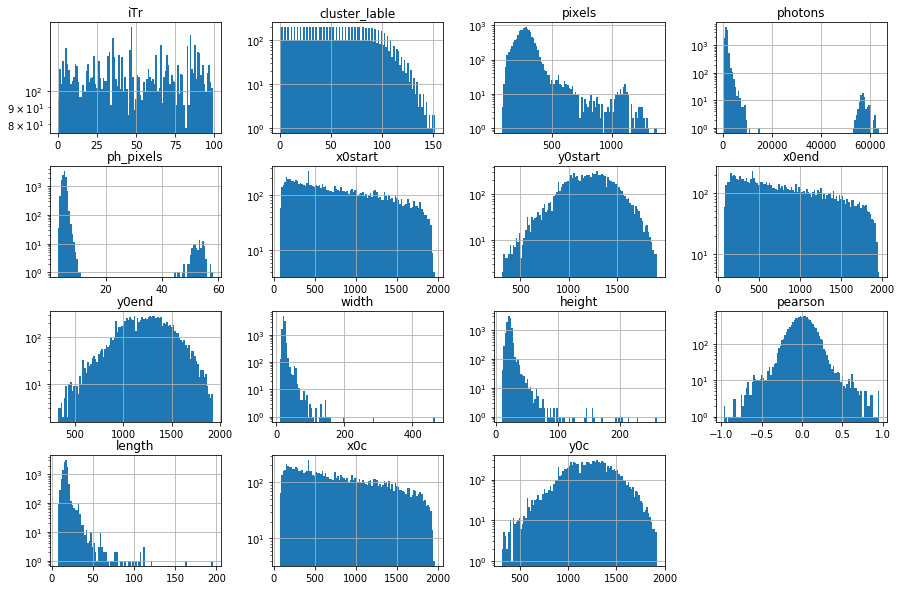

In [50]:
#
# Visulizza tutte le Varibili
#
df.hist(bins=100, figsize=(15,10), log=True)
plt.show()

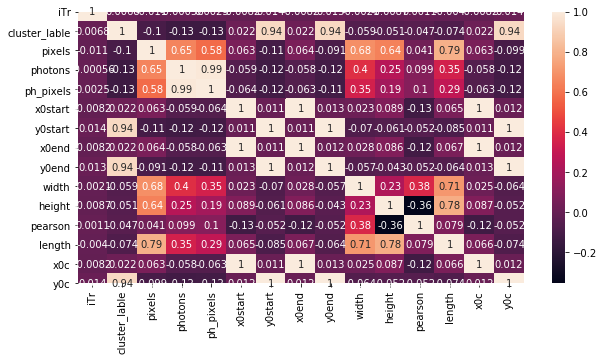

In [51]:
import seaborn as sns
plt.figure(figsize = (10,5))
sns.heatmap(df.corr(), annot=True)
plt.show()

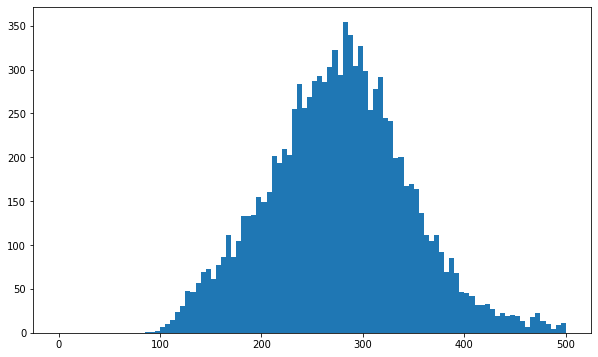

In [52]:
fig, ax = plt.subplots(figsize=(10,6))
ax.hist(df.pixels, 100, range=(0,500))
#ax.set_yscale('log')
plt.show()

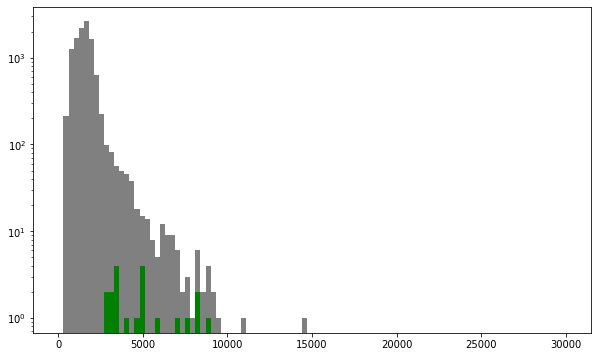

In [53]:
fig, ax = plt.subplots(figsize=(10,6))
ax.hist(df.photons, 100, range=(0,30000), color="gray")
ax.hist(df.photons[df.pearson>0.8], 100, range=(0,30000), color="green")
ax.set_yscale('log')
plt.show()

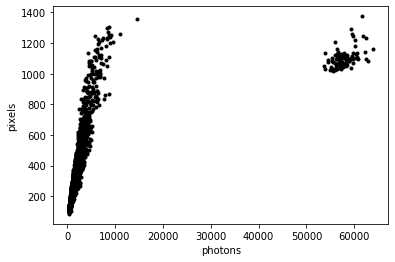

In [54]:
plt.plot(df.photons.values, df.pixels.values, 'k.')
plt.xlabel('photons')
plt.ylabel('pixels')
plt.show()

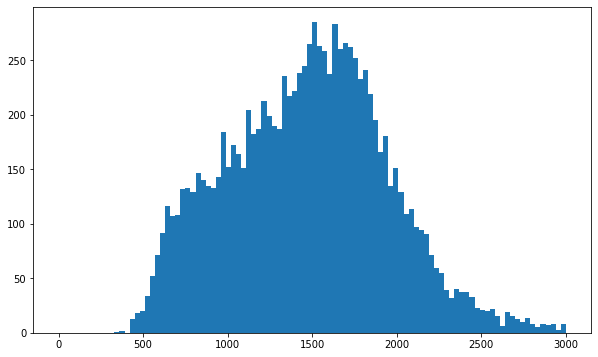

In [55]:
#
# Visualizziamo i fotoni
#
fig, ax = plt.subplots(figsize=(10,6))
ax.hist(df.photons[(df.pixels>40) & (abs(df.pearson)<0.5)], 100, range=(0,3000))
plt.show()

Fidical Ellips: 100.00, 120.00 [mm]


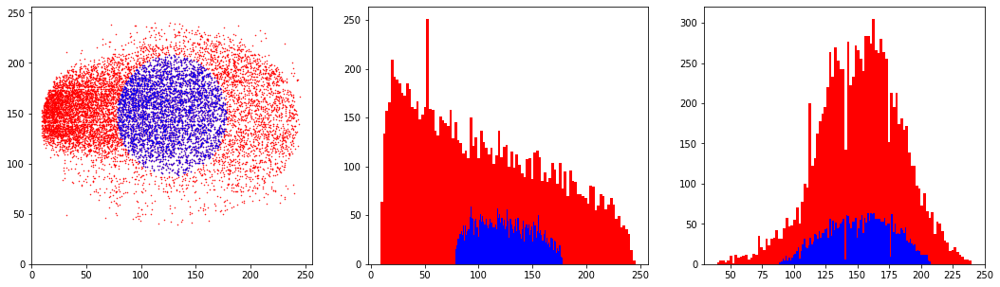

In [56]:
pd.set_option('mode.chained_assignment', None)
dfc = df[(df['cluster_lable'] > -1) & (df['width'] > 0) & (df['height'] > 0)]

# Normalization

phKev       = 2045.15/5.9
pixelscale  = 0.125 
x_resolution = y_resolution = 2048
xyscale = 1.
rescale_pixelscale = xyscale*pixelscale

dfc['photons']  =dfc['photons']*xyscale*xyscale
dfc['length']   =dfc['length']*rescale_pixelscale
dfc['x0c']      =dfc['x0c']*rescale_pixelscale
dfc['y0c']      =dfc['y0c']*rescale_pixelscale

# fiducializzation

DX = 0 
DY = -20
a = 100. # mm 
b = 120. # mm

a0 = a*0.5
b0 = b*0.5
#################################################


print ("Fidical Ellips: %.2f, %.2f [mm]" % (a,b))

d0 = x_resolution*pixelscale/2

fig, ax = plt.subplots(1,3, figsize=(18, 5))

y = dfc['y0c'].values
x = dfc['x0c'].values
x1 = x[((x-d0+DX)**2/a0**2 + (y-d0+DY)**2/b0**2 )< 1]
y1 = y[((x-d0+DX)**2/a0**2 + (y-d0+DY)**2/b0**2 )< 1]
ax[0].plot(x, y, 'r.', markersize=1)
ax[0].plot(x1, y1, 'b.', markersize=1)
ax[0].set_xlim(0,256)
ax[0].set_ylim(0,256)
ax[1].hist(x, color='r',bins=100)
ax[1].hist(x1, color='b',bins=100)
ax[2].hist(y, color='r',bins=100)
ax[2].hist(y1, color='b',bins=100)
plt.show()

dfc = dfc[((dfc['x0c']-d0)**2/a0**2 + (dfc['y0c']-d0)**2/b0**2 )< 1]

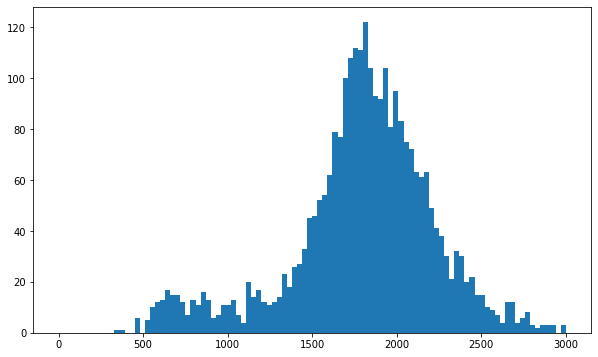

In [57]:
fig, ax = plt.subplots(figsize=(10,6))
ax.hist(dfc.photons[(dfc.pixels>40) & (abs(dfc.pearson)<0.5)], 100, range=(0,3000))
plt.show()

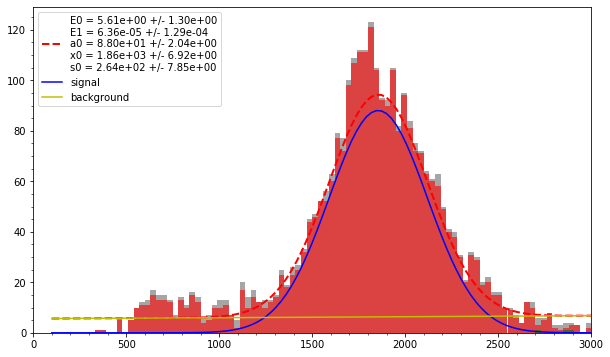

In [58]:
bins = 100

fig, ax = plt.subplots(figsize=(10,6))
hmax = 3000.
myExpG(dfc['photons'], ax, xmin=100., xmax=hmax, bins=100, E0=10000., E1=-0.001, a0=100., x0=2000., s0=300.)
ax.hist(dfc['photons'], bins=100, range=(0,hmax), color='gray', alpha=0.7)
ax.hist(dfc.photons[(dfc.pixels>40) & (abs(dfc.pearson)<0.3)], 100, range=(0,hmax), color="red", alpha=0.6)
ax.hist(dfc.photons[(dfc.pixels>40) & (abs(dfc.pearson)>0.8)], 100, range=(0,hmax), color="green", alpha=0.6)
ax.set_xlim(0,hmax)
#ax.set_yscale("log")
plt.legend(loc=2, prop={'size':'medium'})
plt.minorticks_on()
plt.show()

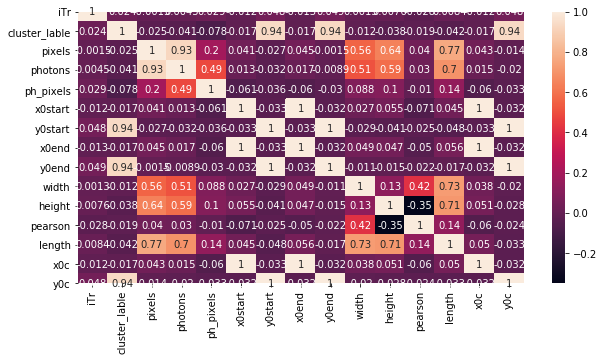

In [59]:
import seaborn as sns
plt.figure(figsize = (10,5))
sns.heatmap(dfc.corr(), annot=True)
plt.show()

In [60]:
258/1680

0.15357142857142858

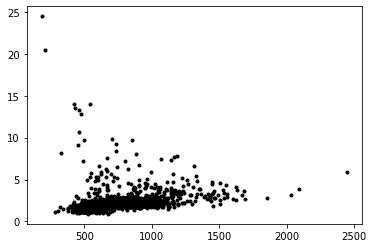

In [61]:
plt.plot(dfc.photons.values/dfc.length.values, dfc.length.values, 'k.')
plt.show()


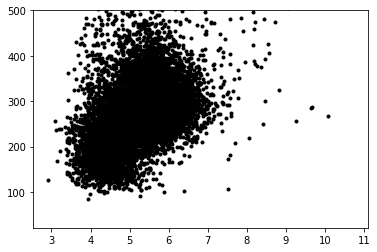

In [68]:
plt.plot(df.ph_pixels.values[df.photons<20000], df.pixels.values[df.photons<20000], 'k.')
plt.plot(df.ph_pixels.values[(df.pearson>0.8) & (df.photons<20000)], 
         df.pixels.values[(df.pearson>0.8) & (df.photons<20000)], 'r.')
plt.ylim(top=500)
plt.show()

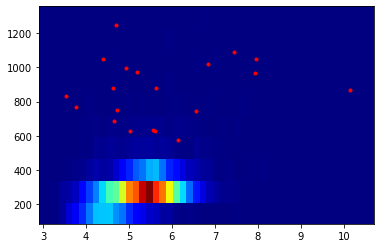

In [63]:
plt.hist2d(df.ph_pixels.values[df.photons<20000], df.pixels.values[df.photons<20000], bins=(50,10), cmap=plt.cm.jet)
plt.plot(df.ph_pixels.values[(df.pearson>0.8) & (df.photons<20000)], 
         df.pixels.values[(df.pearson>0.8) & (df.photons<20000)], 'r.')

plt.show()

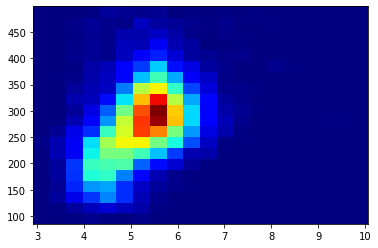

In [66]:
plt.hist2d(df.ph_pixels.values[(df.photons<20000) & (df.pixels<500)], 
           df.pixels.values[(df.photons<20000) & (df.pixels<500)], 
           bins=(20,20), cmap=plt.cm.jet)
plt.show()

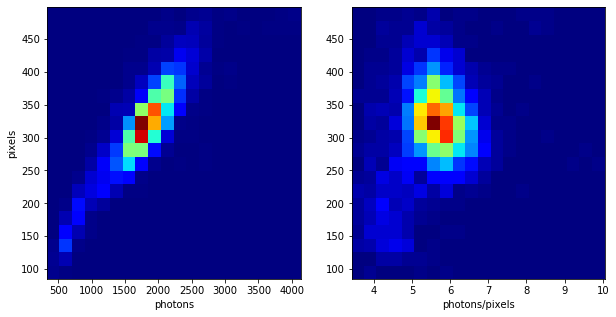

In [67]:
fig, ax = plt.subplots(1,2, figsize=(10,5))
ax[0].hist2d(dfc.photons.values[(dfc.pixels<500)], 
           dfc.pixels.values[(dfc.pixels<500)], 
           bins=(20,20), cmap=plt.cm.jet)
ax[0].set_xlabel("photons")
ax[0].set_ylabel("pixels")
ax[1].hist2d(dfc.ph_pixels.values[(dfc.pixels<500)], 
           dfc.pixels.values[(dfc.pixels<500)], 
           bins=(20,20), cmap=plt.cm.jet)
ax[1].set_xlabel("photons/pixels")
plt.show()

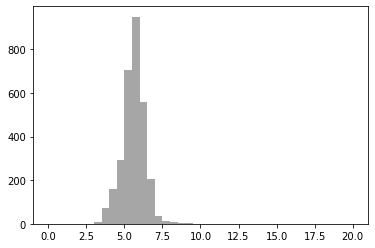

In [27]:
plt.hist(dfc['ph_pixels'], bins=40, range=(0,20), color='gray', alpha=0.7)
plt.show()